In [1]:
import datetime
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
# plotting the car
from matplotlib.offsetbox import (TextArea, DrawingArea, OffsetImage,
                                  AnnotationBbox)
import scipy.misc
from scipy import ndimage

import casadi as cas

##### For viewing the videos in Jupyter Notebook
import io
import base64
from IPython.display import HTML

%matplotlib inline

# Vehicle Dynamics $\frac{d}{dt} \vec{x} = f(\vec{x}, \vec{u})$

In [2]:
X = cas.MX.sym('X')
Y = cas.MX.sym('Y')
Phi = cas.MX.sym('Phi')
Delta = cas.MX.sym('Delta')
V = cas.MX.sym('V')
s = cas.MX.sym('s')

delta_u = cas.MX.sym('delta_u')
v_u = cas.MX.sym('v_u')
x = cas.vertcat(X, Y, Phi, Delta, V, s)
u = cas.vertcat(delta_u, v_u)

L = 1.0
ode = cas.vertcat(V * cas.cos(Phi),
                V * cas.sin(Phi),
                V * cas.tan(Delta) / L,
                delta_u,
                v_u,
                V)

f = cas.Function('f',[x,u],[ode],['x','u'],['ode'])

#  States

$\vec{x}$ = $[x, y, \phi, \delta, V, s]^T$

$\vec{u}$ = $[\delta^u, v^u]^T$

# Discrete (integrated) dynamics $\vec{x}_{t+1} = F(\vec{x}_{t}, \vec{u}_{t})$

In [3]:
T = 3 #numbr of time horizons
dt = 0.1
N = int(T/dt) #Number of control intervals
intg_options = {}
intg_options['tf'] = dt # from dt
intg_options['simplify'] = True
intg_options['number_of_finite_elements'] = 6  #from 4

dae = {}  #What's a DAE?
dae['x'] = x
dae['p'] = u
dae['ode'] = f(x,u)
intg = cas.integrator('intg','rk', dae, intg_options)
res = intg(x0=x,p=u)
x_next = res['xf']
F = cas.Function('F',[x,u],[x_next],['x','u'],['x_next'])

# Car class (for plotting)

In [4]:
class Car:
    def __init__(self):
        self.L = 1.0 # m
        
    def get_frame(self, x, ax=None, amb=False, min_distance=-1, circle=False ):
    
        if ax is None:
            fig, ax = plt.subplots(figsize=(6,6))
        else:
            fig = ax.get_figure()
            
            
        X, Y, Phi, Delta, V, S = x.flatten()
        if not amb:
            arr_img = plt.imread('red_car.png', format='png')
        else:
            arr_img = plt.imread('ambulance.png', format='png')
        degree = np.rad2deg(Phi)
        xy = (X, Y)
        rotated_img = ndimage.rotate(arr_img, degree)
        ax.axis('square')
        window_width = 12
        window_height = window_width
        xmin, xmax = -1, -1+window_width
        ymin, ymax = -int(window_height/4.0), int(window_height/4.0)
        ax.set_ylim((ymin, ymax))
        ax.set_xlim((xmin, xmax))

        if circle:
            circle_patch = patches.Circle(xy, radius=min_distance/2)
            ax.add_patch(circle_patch)
        else:
            if not amb:
                imagebox = OffsetImage(rotated_img, zoom=self.L * 1/(2*window_width)) #this zoom is to scale L=1
            else:
                imagebox = OffsetImage(rotated_img, zoom=1/3*self.L * 1/(2*window_width)) #this zoom is to scale L=1            
            imagebox.image.axes = ax
            ab = AnnotationBbox(imagebox, (X, Y),frameon=False)
            ax.add_artist(ab)        

        return fig, ax        

# Parameterization of Desired Trajectory ($\vec{x}_d = f_d(s)$)

In [5]:
xd = s
yd = 0
phid = 0
des_traj = cas.vertcat(xd, yd, phid)

fd = cas.Function('fd',[s],[des_traj],['s'],['des_traj'])

### Solve it centrally just to warm start the solution

In [6]:
#Globally true information

min_dist = 2 * (2 * .5**2)**.5

# Initial Conditions
x0 = np.array([2*min_dist, .6*min_dist, 0, 0, 1.0, 0]).T
x0_2 = np.array([2*min_dist,-.6*min_dist, .0, 0, 1.0,0]).T
x0_amb = np.array([0, 0.0, 0, 0, 2.5,0]).T

n_cars = 3

In [7]:
optional_suffix = ""
subdir_name = datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + optional_suffix
folder = "results/" + subdir_name + "/"
os.makedirs(folder)
os.makedirs(folder+"imgs/")
print(folder)



# Generating Cost Matrices
q_lon, q_lat, q_phi, q_v, = 1., 5.0, 5.0, -.1,  #State costs
r_delta, r_vdot = 10.0, 10.0  #Control input costs

Q_k = np.eye(6)
Q_k[0,0] = q_lon
Q_k[1,1] = q_lat
Q_k[2,2] = q_phi
Q_k[3,3] = 0
Q_k[4,4] = q_v
Q_k[5,5] = q_lon
# C[6,6] = r_delta
# C[7,7] = r_vdot
Q_k[0,5] = -q_lon
Q_k[5,0] = -q_lon
R_k = np.eye(2)

opti = cas.Opti()
n_ctrl = 2
n_state = 6


#Variables
x_opt = opti.variable(n_state, N+1) # initialize X for each car that we will optimize
x2_opt = opti.variable(n_state, N+1)
xamb_opt = opti.variable(n_state, N+1)

u_opt = opti.variable(n_ctrl, N)
u2_opt = opti.variable(n_ctrl, N)
uamb_opt = opti.variable(n_ctrl, N)

p = opti.parameter(n_state, 1) #this will be the initial state
p2 = opti.parameter(n_state, 1)
pamb = opti.parameter(n_state, 1)


x_desired = opti.variable(3, N+1)
x2_desired = opti.variable(3, N+1)
xamb_desired = opti.variable(3, N+1)

#### Costs

car1_u_delta_cost = 10 * cas.sumsqr(u_opt[0,:])
car1_u_v_cost = 1 * cas.sumsqr(u_opt[1,:])

car1_lat_cost = np.sum([(-cas.sin(x_desired[2,k]) * (x_opt[0,k]-x_desired[0,k]) + 
            cas.cos(x_desired[2,k]) * (x_opt[1,k]-x_desired[1,k]))**2
           for k in range(N+1)])
car1_lon_cost = np.sum([(cas.cos(x_desired[2,k]) * (x_opt[0,k]-x_desired[0,k]) + 
            cas.sin(x_desired[2,k]) * (x_opt[1,k]-x_desired[1,k]))**2
           for k in range(N+1)]) 
car1_phi_cost = cas.sumsqr(x_desired[2,:]-x_opt[2,:]) 
car1_v_cost = cas.sumsqr(x_opt[4,:])   
phid_1 = x_opt[4,:] * cas.tan(x_opt[3,:]) / L
phid1_cost = cas.sumsqr(phid_1)

k_lat1 = 10
k_lon1 = .1
k_phi1 = 10.0
k_phid1 = 1.0

car1_costs = (car1_u_delta_cost + car1_u_v_cost + 
    k_lat1*car1_lat_cost + k_lon1*car1_lon_cost + k_phi1 * car1_phi_cost + 
              k_phid1 * phid1_cost +
             0.001*q_v*car1_v_cost)


car2_u_delta_cost = 10 * cas.sumsqr(u2_opt[0,:])
car2_u_v_cost = 1 * cas.sumsqr(u2_opt[1,:])

car2_lat_cost = np.sum([(-cas.sin(x2_desired[2,k]) * (x2_opt[0,k]-x2_desired[0,k]) + 
            cas.cos(x2_desired[2,k]) * (x2_opt[1,k]-x2_desired[1,k]))**2
           for k in range(N+1)])
car2_lon_cost = np.sum([(cas.cos(x2_desired[2,k]) * (x2_opt[0,k]-x2_desired[0,k]) + 
            cas.sin(x2_desired[2,k]) * (x2_opt[1,k]-x2_desired[1,k]))**2
           for k in range(N+1)]) 
car2_phi_cost = cas.sumsqr(x2_desired[2,:]-x2_opt[2,:]) 
car2_v_cost = cas.sumsqr(x2_opt[4,:])   
phid_2 = x2_opt[4,:] * cas.tan(x2_opt[3,:]) / L
phid2_cost =cas.sumsqr(phid_2)    


k_lat2 = 10
k_lon2 = .10    
k_phi2 = 10.0
k_phid2 = 1.0

car2_costs = (car2_u_delta_cost + car2_u_v_cost + 
    k_lat2*car2_lat_cost + k_lon2*car2_lon_cost + k_phi2*car2_phi_cost + 
              k_phid2*phid2_cost + 0.001*q_v*car2_v_cost)    

R_k = 1*R_k

#     amb_u_v_cost = np.sum([cas.transpose(uamb_opt[:,k]) @ R_k @ uamb_opt[:,k] for k in range(N)])

amb_u_delta_cost = 10 * cas.sumsqr(uamb_opt[0,:])
amb_u_v_cost = 0.1 * cas.sumsqr(uamb_opt[1,:])

amb_lat_cost = np.sum([(-cas.sin(xamb_desired[2,k]) * (xamb_opt[0,k]-xamb_desired[0,k]) + 
            cas.cos(xamb_desired[2,k]) * (xamb_opt[1,k]-xamb_desired[1,k]))**2
           for k in range(N+1)])


amb_lon_cost = np.sum([(cas.cos(xamb_desired[2,k]) * (xamb_opt[0,k]-xamb_desired[0,k]) + 
            cas.sin(xamb_desired[2,k]) * (xamb_opt[1,k]-xamb_desired[1,k]))**2
           for k in range(N+1)]) 

amb_phi_cost = cas.sumsqr(xamb_desired[2,:]-xamb_opt[2,:]) 
amb_v_cost = cas.sumsqr(xamb_opt[4,:])  

phid_amb= xamb_opt[4,:] * cas.tan(xamb_opt[3,:]) / L
phidamb_cost =cas.sumsqr(phid_amb)   

k_latamb = 10
k_lonamb = 1.0        
k_phiamb = 10.0
k_phidamb = 1.0
amb_costs = (amb_u_delta_cost + amb_u_v_cost + 
             k_latamb*amb_lat_cost + k_lonamb*amb_lon_cost + k_phiamb*amb_phi_cost + 
             k_phidamb * phidamb_cost + q_v*amb_v_cost
            )


theta_1 = np.pi/4
theta_2 = np.pi/4
theta_amb = 0
######## optimization  ##################################
opti.minimize(np.cos(theta_amb)*amb_costs + np.sin(theta_amb)*(car1_costs + car2_costs) + 
              (np.cos(theta_1)*car1_costs + np.sin(theta_1)*amb_costs) + 
              (np.cos(theta_2)*car2_costs + np.sin(theta_2)*amb_costs)
             )    
##########################################################
#constraints

for k in range(N):
    opti.subject_to( x_opt[:, k+1] == F(x_opt[:, k], u_opt[:, k]))

for k in range(N+1):
    opti.subject_to( x_desired[:, k] == fd(x_opt[-1, k]) ) #This should be the trajectory dynamic constraint        


opti.subject_to(opti.bounded(-np.pi/6, u_opt[0,:], np.pi/6))
opti.subject_to(opti.bounded(-4, u_opt[1,:], 4)) # 0-60 around 4 m/s^2
v_max = 10
opti.subject_to(opti.bounded(0, x_opt[4,:],v_max))    
opti.subject_to(x_opt[:,0] == p)

#Just repeat constraints for x2
for k in range(N):
    opti.subject_to( x2_opt[:, k+1] == F(x2_opt[:, k], u2_opt[:, k]))
for k in range(N+1):
    opti.subject_to( x2_desired[:, k] == fd(x2_opt[-1, k]) ) #This should be the trajectory dynamic constraint             


opti.subject_to(opti.bounded(-np.pi/6, u2_opt[0,:], np.pi/6))
opti.subject_to(opti.bounded(-4, u2_opt[1,:], 4))
v_max = 10
opti.subject_to(opti.bounded(0, x2_opt[4,:],v_max))    
opti.subject_to(x2_opt[:,0] == p2)

#ambulance
for k in range(N):
    opti.subject_to( xamb_opt[:, k+1] == F(xamb_opt[:, k], uamb_opt[:, k]))
for k in range(N+1):
    opti.subject_to( xamb_desired[:, k] == fd(xamb_opt[-1, k]) ) #This should be the trajectory dynamic constraint             


opti.subject_to(opti.bounded(-np.pi/6, uamb_opt[0,:], np.pi/6))
opti.subject_to(opti.bounded(-4, uamb_opt[1,:], 4))
v_max = 20
opti.subject_to(opti.bounded(0, xamb_opt[4,:],v_max))    
opti.subject_to(xamb_opt[:,0] == pamb)    

#     min_dist = 0.6
for k in range(N+1):
    opti.subject_to( cas.sumsqr(x_opt[0:2,k] - x2_opt[0:2,k]) > min_dist**2 )
    opti.subject_to( cas.sumsqr(x_opt[0:2,k] - xamb_opt[0:2,k]) > min_dist**2 )
    opti.subject_to( cas.sumsqr(x2_opt[0:2,k] - xamb_opt[0:2,k]) > min_dist**2 )

# constraints to help out
opti.subject_to( opti.bounded(-1, x_opt[0,:], 30) )
opti.subject_to( opti.bounded(-1, x2_opt[0,:], 30) )
opti.subject_to( opti.bounded(-1, xamb_opt[0,:], 30) )
opti.subject_to( opti.bounded(-10, x_opt[1,:], 10) )
opti.subject_to( opti.bounded(-10, x2_opt[1,:], 10) )
opti.subject_to( opti.bounded(-10, xamb_opt[1,:], 10) )

# constrain crazy turns
opti.subject_to( opti.bounded(-np.pi/2, x_opt[2,:], np.pi/2) )
opti.subject_to( opti.bounded(-np.pi/2, x2_opt[2,:], np.pi/2) )
opti.subject_to( opti.bounded(-np.pi/2, xamb_opt[2,:], np.pi/2) )    

# constrain the lane deviations to prevent wacky solutions
#     opti.subject_to( opti.bounded(-5, x_opt[0,:] - x_desired[0,:], 5))
#     opti.subject_to( opti.bounded(-5, x2_opt[0,:] - x2_desired[0,:], 5))
opti.subject_to( opti.bounded(-5, xamb_opt[0,:] - xamb_desired[0,:], 5))
opti.subject_to( opti.bounded(-10, x_opt[1,:] - x_desired[1,:], 10))
opti.subject_to( opti.bounded(-10, x2_opt[1,:] - x2_desired[1,:], 10))
opti.subject_to( opti.bounded(-10, xamb_opt[1,:] - xamb_desired[1,:], 10))


opti.solver('ipopt',{'warn_initial_bounds':True},{'print_level':5})

opti.set_value(p,x0)
opti.set_value(p2,x0_2)
opti.set_value(pamb,x0_amb) 

results/20200210-142758/


In [8]:
speeding_amb_u = np.zeros((2,N))
speeding_amb_u[1,:10] = np.ones((1,10)) * 3.999

x = np.zeros((6,N+1))
x1 = np.zeros((6,N+1))
xamb = np.zeros((6,N+1))
u0 = np.zeros((2,N))
u0[0,:10] = np.ones((1,10)) * np.pi/5
u0[1,:10] = np.ones((1,10)) * 3.999

u1 = np.zeros((2,N))
u1[0,:10] = np.ones((1,10)) * -np.pi/5
u1[1,:10] = np.ones((1,10)) * 3.999

x[:,0] = x0
x1[:,0] = x0_2
xamb[:,0] = x0_amb
for t in range(N):
    x[:,t+1:t+2] = F(x[:,t],u0[:,t])
    x1[:,t+1:t+2] = F(x1[:,t],u1[:,t])
    xamb[:,t+1:t+2] = F(xamb[:,t],speeding_amb_u[:,t])

    

opti.set_initial(uamb_opt, speeding_amb_u)
opti.set_initial(u_opt, u0)
opti.set_initial(u2_opt, u0)
opti.set_initial(xamb_opt, xamb)
opti.set_initial(x2_opt, x1)
opti.set_initial(x_opt, x)



In [9]:
ego_car = Car()
for k in range(N+1):

    fig, ax = ego_car.get_frame(x[:,k],None,False,min_dist,True)
    fig, ax = ego_car.get_frame(x1[:,k], ax,False,min_dist,True)
    fig, ax = ego_car.get_frame(xamb[:,k], ax, False,min_dist,True)

    
#     ax.plot(x_des[0,:], x_des[1,:], '--')
#     ax.plot(x2_des[0,:], x2_des[1,:], '--')        

    ax = plt.gca()
    window_width = 24
    window_height = window_width
    xmin, xmax = -1, -1+window_width
    ymin, ymax = -int(window_height/4.0), int(window_height/4.0)
    ax.set_ylim((ymin, ymax))
    ax.set_xlim((xmin, xmax))

    fig.savefig(folder + 'imgs/' '{:03d}.png'.format(k))
    plt.close(fig)     

In [10]:
sol = opti.solve()


******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit http://projects.coin-or.org/Ipopt
******************************************************************************

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:     3090
Number of nonzeros in inequality constraint Jacobian.:     1172
Number of nonzeros in Lagrangian Hessian.............:     3036

Total number of variables............................:     1017
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equa

  83  9.2001534e+01 6.97e-04 4.47e+00  -1.7 6.34e-01  -0.8 9.19e-01 6.86e-01f  1
  84  8.3644724e+01 1.27e-03 3.62e+00  -1.7 4.41e+01    -  3.93e-01 3.57e-01f  1
  85  8.0413112e+01 1.03e-03 6.92e+00  -1.7 2.09e+01    -  6.03e-01 2.92e-01f  1
  86  7.8302585e+01 8.53e-04 4.89e+00  -1.7 1.95e+01    -  8.85e-01 3.47e-01h  1
  87  7.6672019e+01 3.48e-04 1.14e+00  -1.7 7.92e+00    -  8.71e-01 1.00e+00h  1
  88  7.6413183e+01 2.70e-05 2.01e-01  -1.7 2.05e+00    -  1.00e+00 1.00e+00h  1
  89  7.6372811e+01 9.92e-08 8.81e-04  -1.7 8.27e-02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  90  7.3750254e+01 7.96e-05 1.65e-01  -3.8 1.74e+00    -  9.01e-01 7.96e-01f  1
  91  7.2951060e+01 6.41e-06 9.02e-03  -3.8 8.36e-01    -  9.99e-01 1.00e+00h  1
  92  7.2920493e+01 2.01e-07 1.37e-03  -3.8 1.52e-01    -  1.00e+00 1.00e+00h  1
  93  7.2893337e+01 3.85e-08 2.18e-03  -5.7 6.21e-02    -  9.93e-01 9.77e-01h  1
  94  7.2892252e+01 5.89e-09

In [11]:
x_warm = sol.value(x_opt)
u_warm = sol.value(u_opt)
x2_warm = sol.value(x2_opt)
u2_warm = sol.value(u2_opt)
xamb_warm = sol.value(xamb_opt)
uamb_warm = sol.value(uamb_opt)

x_des = sol.value(x_desired)
x2_des = sol.value(x2_desired)

In [12]:
ego_car = Car()
for k in range(N+1):
    CIRCLES = False
    if CIRCLES:
        fig, ax = ego_car.get_frame(x_warm[:,k],None,False,min_dist,True)
        fig, ax = ego_car.get_frame(x2_warm[:,k], ax,False,min_dist,True)
        fig, ax = ego_car.get_frame(xamb_warm[:,k], ax, False,min_dist,True)
    else:
        fig, ax = ego_car.get_frame(x_warm[:,k],None,False,min_dist,False)
        fig, ax = ego_car.get_frame(x2_warm[:,k], ax,False,min_dist,False)
        fig, ax = ego_car.get_frame(xamb_warm[:,k], ax, True,min_dist,False)        
    
    ax.plot(x_des[0,:], x_des[1,:], '--')
    ax.plot(x2_des[0,:], x2_des[1,:], '--')        

    ax = plt.gca()
    window_width = 24
    window_height = window_width
    xmin, xmax = -1, -1+window_width
    ymin, ymax = -int(window_height/4.0), int(window_height/4.0)
    ax.set_ylim((ymin, ymax))
    ax.set_xlim((xmin, xmax))

    fig.savefig(folder + 'imgs/' '{:03d}.png'.format(k))
    plt.close(fig)     

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

In [13]:
vid_fname = folder + subdir_name + 'car.mp4'
if os.path.exists(vid_fname):
    os.remove(vid_fname)
cmd = 'ffmpeg -r 16 -f image2 -i {}imgs/%03d.png -vcodec libx264 -crf 25  -pix_fmt yuv420p {}'.format(folder, vid_fname)
os.system(cmd)
print('Saving video to: {}'.format(vid_fname))

Saving video to: results/20200210-142758/20200210-142758car.mp4


In [14]:
video = io.open(vid_fname, 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

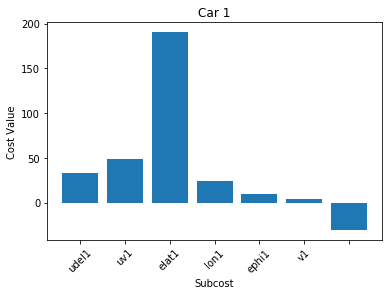

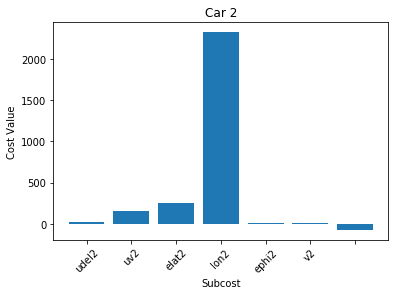

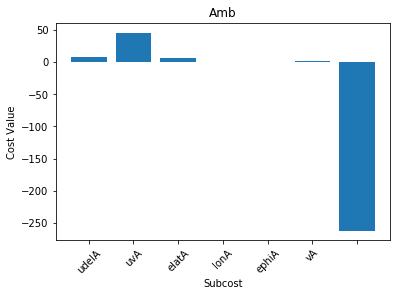

Text(0, 0.5, 'Cost Value')

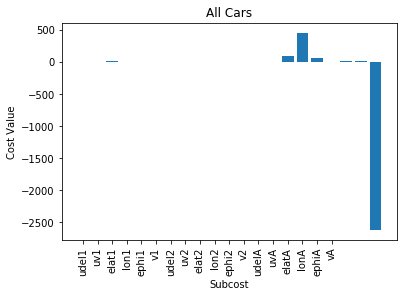

In [15]:
car1_sub_costs = [car1_u_delta_cost, car1_u_v_cost, k_lat1*car1_lat_cost, k_lon1*car1_lon_cost, k_phi1*car1_phi_cost, k_phid1*phid1_cost, q_v*car1_v_cost] 
car1_sub_costs_labels = ['udel1', 'uv1', 'elat1', 'lon1', 'ephi1', 'v1']
plt.bar(range(len(car1_sub_costs)), [sol.value(c) for c in car1_sub_costs])
plt.xticks(range(len(car1_sub_costs)), car1_sub_costs_labels,rotation=45)
plt.title('Car 1')
plt.xlabel("Subcost")
plt.ylabel("Cost Value")
plt.show()

car2_sub_costs = [car2_u_delta_cost, car2_u_v_cost, 10*car2_lat_cost, 10*car2_lon_cost, k_phi2*car2_phi_cost, k_phid2*phid2_cost, q_v*car2_v_cost] 
car2_sub_costs_labels = ['udel2', 'uv2', 'elat2', 'lon2', 'ephi2', 'v2']
plt.bar(range(len(car2_sub_costs)), [sol.value(c) for c in car2_sub_costs])
plt.xticks(range(len(car2_sub_costs)), car2_sub_costs_labels,rotation=45)
plt.title('Car 2')
plt.xlabel("Subcost")
plt.ylabel("Cost Value")
plt.show()

amb_sub_costs = [amb_u_delta_cost, amb_u_v_cost, 10*amb_lat_cost, 10*amb_lon_cost,k_phiamb*amb_phi_cost, k_phidamb*phidamb_cost, q_v*amb_v_cost] 
amb_sub_costs_labels = ['udelA', 'uvA', 'elatA', 'lonA', 'ephiA', 'vA']
plt.bar(range(len(amb_sub_costs)), [sol.value(c) for c in amb_sub_costs])
plt.xticks(range(len(amb_sub_costs)), amb_sub_costs_labels,rotation=45)

plt.title('Amb')
plt.xlabel("Subcost")
plt.ylabel("Cost Value")
plt.show()

all_costs = [0.1*c for c in car1_sub_costs] + [0.1 for c in car2_sub_costs] + [10*c for c in amb_sub_costs]
all_labels = car1_sub_costs_labels + car2_sub_costs_labels + amb_sub_costs_labels
plt.bar(range(len(all_costs)), [sol.value(c) for c in all_costs])
plt.xticks(range(len(all_labels)), all_labels,rotation=90)
plt.title('All Cars')
plt.xlabel("Subcost")
plt.ylabel("Cost Value")

## Optimization

In [16]:
## Best response for vehicle 1
opti = cas.Opti()
n_ctrl = 2
n_state = 6

#Variables
x_opt = opti.variable(n_state, N+1) # initialize X for each car that we will optimize
u_opt = opti.variable(n_ctrl, N)



# These are now parameters!!
x2_opt = opti.parameter(n_state, N+1)
xamb_opt = opti.parameter(n_state, N+1)
u2_opt = opti.parameter(n_ctrl, N)
uamb_opt = opti.parameter(n_ctrl, N)

p = opti.parameter(n_state, 1) #this will be the initial state
p2 = opti.parameter(n_state, 1)
pamb = opti.parameter(n_state, 1)


x_desired = opti.variable(3, N+1)
x2_desired = opti.variable(3, N+1)
xamb_desired = opti.variable(3, N+1)

#### Costs

car1_u_delta_cost = 10 * cas.sumsqr(u_opt[0,:])
car1_u_v_cost = 1 * cas.sumsqr(u_opt[1,:])

car1_lat_cost = np.sum([(-cas.sin(x_desired[2,k]) * (x_opt[0,k]-x_desired[0,k]) + 
            cas.cos(x_desired[2,k]) * (x_opt[1,k]-x_desired[1,k]))**2
           for k in range(N+1)])
car1_lon_cost = np.sum([(cas.cos(x_desired[2,k]) * (x_opt[0,k]-x_desired[0,k]) + 
            cas.sin(x_desired[2,k]) * (x_opt[1,k]-x_desired[1,k]))**2
           for k in range(N+1)]) 
car1_phi_cost = cas.sumsqr(x_desired[2,:]-x_opt[2,:]) 
car1_v_cost = cas.sumsqr(x_opt[4,:])   
phid_1 = x_opt[4,:] * cas.tan(x_opt[3,:]) / L
phid1_cost = cas.sumsqr(phid_1)

k_lat1 = 10
k_lon1 = 10
k_phid1 = 1.0

car1_costs = (car1_u_delta_cost + car1_u_v_cost + 
    k_lat1*car1_lat_cost + k_lon1*car1_lon_cost + car1_phi_cost + 
              k_phid1 * phid1_cost +
             q_v*car1_v_cost)


car2_u_delta_cost = 10 * cas.sumsqr(u2_opt[0,:])
car2_u_v_cost = 1 * cas.sumsqr(u2_opt[1,:])

car2_lat_cost = np.sum([(-cas.sin(x2_desired[2,k]) * (x2_opt[0,k]-x2_desired[0,k]) + 
            cas.cos(x2_desired[2,k]) * (x2_opt[1,k]-x2_desired[1,k]))**2
           for k in range(N+1)])
car2_lon_cost = np.sum([(cas.cos(x2_desired[2,k]) * (x2_opt[0,k]-x2_desired[0,k]) + 
            cas.sin(x2_desired[2,k]) * (x2_opt[1,k]-x2_desired[1,k]))**2
           for k in range(N+1)]) 
car2_phi_cost = cas.sumsqr(x2_desired[2,:]-x2_opt[2,:]) 
car2_v_cost = cas.sumsqr(x2_opt[4,:])   
phid_2 = x2_opt[4,:] * cas.tan(x2_opt[3,:]) / L
phid2_cost =cas.sumsqr(phid_2)    


k_lat2 = 10
k_lon2 = 10    
k_phid2 = 1.0

car2_costs = (car2_u_delta_cost + car2_u_v_cost + 
    k_lat2*car2_lat_cost + k_lon2*car2_lon_cost + car2_phi_cost + 
              k_phid2*phid2_cost + q_v*car2_v_cost)    

R_k = 1*R_k

#     amb_u_v_cost = np.sum([cas.transpose(uamb_opt[:,k]) @ R_k @ uamb_opt[:,k] for k in range(N)])

amb_u_delta_cost = 10 * cas.sumsqr(uamb_opt[0,:])
amb_u_v_cost = 0.1 * cas.sumsqr(uamb_opt[1,:])

amb_lat_cost = np.sum([(-cas.sin(xamb_desired[2,k]) * (xamb_opt[0,k]-xamb_desired[0,k]) + 
            cas.cos(xamb_desired[2,k]) * (xamb_opt[1,k]-xamb_desired[1,k]))**2
           for k in range(N+1)])


amb_lon_cost = np.sum([(cas.cos(xamb_desired[2,k]) * (xamb_opt[0,k]-xamb_desired[0,k]) + 
            cas.sin(xamb_desired[2,k]) * (xamb_opt[1,k]-xamb_desired[1,k]))**2
           for k in range(N+1)]) 

amb_phi_cost = cas.sumsqr(xamb_desired[2,:]-xamb_opt[2,:]) 
amb_v_cost = cas.sumsqr(xamb_opt[4,:])  

phid_amb= xamb_opt[4,:] * cas.tan(xamb_opt[3,:]) / L
phidamb_cost =cas.sumsqr(phid_amb)   

k_latamb = 20
k_lonamb = 10        
k_phidamb = 1.0
amb_costs = (amb_u_delta_cost + amb_u_v_cost + 
             k_latamb*amb_lat_cost + k_lonamb*amb_lon_cost + amb_phi_cost + 
             k_phidamb * phidamb_cost + q_v*amb_v_cost
            )


theta_1 = np.pi/4
theta_2 = np.pi/4
theta_amb = 0
######## optimization  ##################################
opti.minimize(np.cos(theta_1)*car1_costs + np.sin(theta_1)*amb_costs)    
##########################################################



#constraints

for k in range(N):
    opti.subject_to( x_opt[:, k+1] == F(x_opt[:, k], u_opt[:, k]))

for k in range(N+1):
    opti.subject_to( x_desired[:, k] == fd(x_opt[-1, k]) ) #This should be the trajectory dynamic constraint        


opti.subject_to(opti.bounded(-np.pi/6, u_opt[0,:], np.pi/6))
opti.subject_to(opti.bounded(-4, u_opt[1,:], 4)) # 0-60 around 4 m/s^2
v_max = 10
opti.subject_to(opti.bounded(0, x_opt[4,:],v_max))    
opti.subject_to(x_opt[:,0] == p)

#     min_dist = 0.6
for k in range(N+1):
    opti.subject_to( cas.sumsqr(x_opt[0:2,k] - x2_opt[0:2,k]) > min_dist**2 )
    opti.subject_to( cas.sumsqr(x_opt[0:2,k] - xamb_opt[0:2,k]) > min_dist**2 )

# constraints to help out
opti.subject_to( opti.bounded(-1, x_opt[0,:], 30) )
opti.subject_to( opti.bounded(-10, x_opt[1,:], 10) )
opti.subject_to( opti.bounded(-np.pi/2, x_opt[2,:], np.pi/4) )


# constrain the lane deviations to prevent wacky solutions
#     opti.subject_to( opti.bounded(-5, x_opt[0,:] - x_desired[0,:], 5))
#     opti.subject_to( opti.bounded(-5, x2_opt[0,:] - x2_desired[0,:], 5))
opti.subject_to( opti.bounded(-5, xamb_opt[0,:] - xamb_desired[0,:], 5))
opti.subject_to( opti.bounded(-10, x_opt[1,:] - x_desired[1,:], 10))

opti.solver('ipopt',{'warn_initial_bounds':True},{'print_level':0})

opti.set_value(p,x0)
opti.set_value(p2,x0_2)
opti.set_value(pamb,x0_amb)     




In [17]:
opti2 = cas.Opti()
n_ctrl = 2
n_state = 6

#Variables
x2_opt2 = opti2.variable(n_state, N+1)
u2_opt2 = opti2.variable(n_ctrl, N)

### Agent 2 has these as parameters!!!
x_opt2 = opti2.parameter(n_state, N+1) # initialize X for each car that we will opti2mize
xamb_opt2 = opti2.parameter(n_state, N+1)
u_opt2 = opti2.parameter(n_ctrl, N)
uamb_opt2 = opti2.parameter(n_ctrl, N)

p_2 = opti2.parameter(n_state, 1) #this will be the initial state
p2_2 = opti2.parameter(n_state, 1)
pamb_2 = opti2.parameter(n_state, 1)

x_desired_2 = opti2.variable(3, N+1)
x2_desired_2 = opti2.variable(3, N+1)
xamb_desired_2 = opti2.variable(3, N+1)

#### Costs
car1_u_delta_cost_2 = 10 * cas.sumsqr(u_opt2[0,:])
car1_u_v_cost_2 = 1 * cas.sumsqr(u_opt2[1,:])
car1_lat_cost_2 = np.sum([(-cas.sin(x_desired_2[2,k]) * (x_opt2[0,k]-x_desired_2[0,k]) + 
            cas.cos(x_desired_2[2,k]) * (x_opt2[1,k]-x_desired_2[1,k]))**2
           for k in range(N+1)])
car1_lon_cost_2 = np.sum([(cas.cos(x_desired_2[2,k]) * (x_opt2[0,k]-x_desired_2[0,k]) + 
            cas.sin(x_desired_2[2,k]) * (x_opt2[1,k]-x_desired_2[1,k]))**2
           for k in range(N+1)]) 
car1_phi_cost_2 = cas.sumsqr(x_desired_2[2,:]-x_opt2[2,:]) 
car1_v_cost_2 = cas.sumsqr(x_opt2[4,:])   
phid_1_2 = x_opt2[4,:] * cas.tan(x_opt2[3,:]) / L
phid1_cost_2 = cas.sumsqr(phid_1_2)

k_lat1_2 = 10
k_lon1_2 = 10
k_phid1_2 = 1.0

car1_costs_2 = (car1_u_delta_cost_2 + car1_u_v_cost_2 + 
    k_lat1_2*car1_lat_cost_2 + k_lon1_2*car1_lon_cost_2 + car1_phi_cost_2 + 
              k_phid1_2 * phid1_cost_2 +
             q_v*car1_v_cost_2)


car2_u_delta_cost_2 = 10 * cas.sumsqr(u2_opt2[0,:])
car2_u_v_cost_2 = 1 * cas.sumsqr(u2_opt2[1,:])
car2_lat_cost_2 = np.sum([(-cas.sin(x2_desired_2[2,k]) * (x2_opt2[0,k]-x2_desired_2[0,k]) + 
            cas.cos(x2_desired_2[2,k]) * (x2_opt2[1,k]-x2_desired_2[1,k]))**2
           for k in range(N+1)])
car2_lon_cost_2 = np.sum([(cas.cos(x2_desired_2[2,k]) * (x2_opt2[0,k]-x2_desired_2[0,k]) + 
            cas.sin(x2_desired_2[2,k]) * (x2_opt2[1,k]-x2_desired_2[1,k]))**2
           for k in range(N+1)]) 
car2_phi_cost_2 = cas.sumsqr(x2_desired_2[2,:]-x2_opt2[2,:]) 
car2_v_cost_2 = cas.sumsqr(x2_opt2[4,:])   
phid_2_2 = x2_opt2[4,:] * cas.tan(x2_opt2[3,:]) / L
phid2_cost_2 =cas.sumsqr(phid_2_2)    

k_lat2_2 = 10
k_lon2_2 = 10    
k_phid2_2 = 1.0

car2_costs_2 = (car2_u_delta_cost_2 + car2_u_v_cost_2 + 
    k_lat2*car2_lat_cost_2 + k_lon2*car2_lon_cost_2 + car2_phi_cost_2 + 
              k_phid2_2*phid2_cost_2 + q_v*car2_v_cost_2)    

R_k_2 = 1*R_k

#     amb_u_v_cost = np.sum([cas.transpose(uamb_opt2[:,k]) @ R_k @ uamb_opt2[:,k] for k in range(N)])

amb_u_delta_cost_2 = 10 * cas.sumsqr(uamb_opt2[0,:])
amb_u_v_cost_2 = 0.1 * cas.sumsqr(uamb_opt2[1,:])
amb_lat_cost_2 = np.sum([(-cas.sin(xamb_desired_2[2,k]) * (xamb_opt2[0,k]-xamb_desired_2[0,k]) + 
            cas.cos(xamb_desired_2[2,k]) * (xamb_opt2[1,k]-xamb_desired_2[1,k]))**2
           for k in range(N+1)])
amb_lon_cost_2 = np.sum([(cas.cos(xamb_desired_2[2,k]) * (xamb_opt2[0,k]-xamb_desired_2[0,k]) + 
            cas.sin(xamb_desired_2[2,k]) * (xamb_opt2[1,k]-xamb_desired_2[1,k]))**2
           for k in range(N+1)]) 
amb_phi_cost_2 = cas.sumsqr(xamb_desired_2[2,:]-xamb_opt2[2,:]) 
amb_v_cost_2 = cas.sumsqr(xamb_opt2[4,:])  
phid_amb_2 = xamb_opt2[4,:] * cas.tan(xamb_opt2[3,:]) / L
phidamb_cost_2 =cas.sumsqr(phid_amb_2)   

k_latamb_2 = 20
k_lonamb_2 = 10        
k_phidamb_2 = 1.0
amb_costs_2 = (amb_u_delta_cost_2 + amb_u_v_cost_2 + 
             k_latamb_2*amb_lat_cost_2 + k_lonamb_2*amb_lon_cost_2 + amb_phi_cost_2 + 
             k_phidamb_2 * phidamb_cost_2 + q_v*amb_v_cost_2
            )

theta_2 = np.pi/4
######## opti2mization  ##################################
opti2.minimize(np.cos(theta_2)*car2_costs_2 + np.sin(theta_2)*amb_costs_2)    
########################################################
#constraints

#Just repeat constraints for x2
for k in range(N):
    opti2.subject_to( x2_opt2[:, k+1] == F(x2_opt2[:, k], u2_opt2[:, k]))
for k in range(N+1):
    opti2.subject_to( x2_desired_2[:, k] == fd(x2_opt2[-1, k]) ) #This should be the trajectory dynamic constraint             


opti2.subject_to(opti2.bounded(-np.pi/6, u2_opt2[0,:], np.pi/6))
opti2.subject_to(opti2.bounded(-4, u2_opt2[1,:], 4))
v_max = 10
opti2.subject_to(opti2.bounded(0, x2_opt2[4,:],v_max))    
opti2.subject_to(x2_opt2[:,0] == p2_2)

#     min_dist = 0.6
for k in range(N+1):
    opti2.subject_to( cas.sumsqr(x_opt2[0:2,k] - x2_opt2[0:2,k]) > min_dist**2 )
    opti2.subject_to( cas.sumsqr(x2_opt2[0:2,k] - xamb_opt2[0:2,k]) > min_dist**2 )




# constraints to help out
opti2.subject_to( opti2.bounded(-1, x2_opt2[0,:], 30) )
opti2.subject_to( opti2.bounded(-10, x2_opt2[1,:], 10) )
opti2.subject_to( opti2.bounded(-np.pi/4, x2_opt2[2,:], np.pi/4) )

# constrain the lane deviations to prevent wacky solutions
#     opti2.subject_to( opti2.bounded(-5, x_opt2[0,:] - x_desired_2[0,:], 5))
#     opti2.subject_to( opti2.bounded(-5, x2_opt2[0,:] - x2_desired_2[0,:], 5))
opti2.subject_to( opti2.bounded(-10, x2_opt2[1,:] - x2_desired_2[1,:], 10))


opti2.solver('ipopt',{'warn_initial_bounds':True},{'print_level':10})

opti2.set_value(p_2,x0)
opti2.set_value(p2_2,x0_2)
opti2.set_value(pamb_2,x0_amb)         

### Ambulance Optimization

In [18]:
opti3 = cas.Opti()
n_ctrl = 2
n_state = 6

#Variables
xamb_opt3 = opti3.variable(n_state, N+1)
uamb_opt3 = opti3.variable(n_ctrl, N)

### Agent 2 has these as parameters!!!
x_opt3 = opti3.parameter(n_state, N+1) # initialize X for each car that we will opti3mize
x2_opt3 = opti3.parameter(n_state, N+1)
u_opt3 = opti3.parameter(n_ctrl, N)
u2_opt3 = opti3.parameter(n_ctrl, N)

p_3 = opti3.parameter(n_state, 1) #this will be the initial state
p2_3 = opti3.parameter(n_state, 1)
pamb_3 = opti3.parameter(n_state, 1)

x_desired_3 = opti3.variable(3, N+1)
x2_desired_3 = opti3.variable(3, N+1)
xamb_desired_3 = opti3.variable(3, N+1)

#### Costs
amb_u_delta_cost_3 = 10 * cas.sumsqr(uamb_opt3[0,:])
amb_u_v_cost_3 = 0.1 * cas.sumsqr(uamb_opt3[1,:])
amb_lat_cost_3 = np.sum([(-cas.sin(xamb_desired_3[2,k]) * (xamb_opt3[0,k]-xamb_desired_3[0,k]) + 
            cas.cos(xamb_desired_3[2,k]) * (xamb_opt3[1,k]-xamb_desired_3[1,k]))**2
           for k in range(N+1)])
amb_lon_cost_3 = np.sum([(cas.cos(xamb_desired_3[2,k]) * (xamb_opt3[0,k]-xamb_desired_3[0,k]) + 
            cas.sin(xamb_desired_3[2,k]) * (xamb_opt3[1,k]-xamb_desired_3[1,k]))**2
           for k in range(N+1)]) 
amb_phi_cost_3 = cas.sumsqr(xamb_desired_3[2,:]-xamb_opt3[2,:]) 
amb_v_cost_3 = cas.sumsqr(xamb_opt3[4,:])  
phid_amb_3 = xamb_opt3[4,:] * cas.tan(xamb_opt3[3,:]) / L
phidamb_cost_3 =cas.sumsqr(phid_amb_3)   

k_latamb_3 = 20
k_lonamb_3 = 10        
k_phidamb_3 = 1.0
amb_costs_3 = (amb_u_delta_cost_3 + amb_u_v_cost_3 + 
             k_latamb_3*amb_lat_cost_3 + k_lonamb_3*amb_lon_cost_3 + amb_phi_cost_3 + 
             k_phidamb_3 * phidamb_cost_3 + q_v*amb_v_cost_3
            )

theta_3 = np.pi/4
######## opti3mization  ##################################
opti3.minimize(amb_costs_3)    
########################################################
#constraints

#Just repeat constraints for x2
for k in range(N):
    opti3.subject_to( xamb_opt3[:, k+1] == F(xamb_opt3[:, k], u2_opt3[:, k]))
for k in range(N+1):
    opti3.subject_to( xamb_desired_3[:, k] == fd(xamb_opt3[-1, k]) ) #This should be the trajectory dynamic constraint             


opti3.subject_to(opti3.bounded(-np.pi/6, uamb_opt3[0,:], np.pi/6))
opti3.subject_to(opti3.bounded(-4, uamb_opt3[1,:], 4))
v_max = 10
opti3.subject_to(opti3.bounded(0, xamb_opt3[4,:],v_max))    
opti3.subject_to(xamb_opt3[:,0] == pamb_3)

#     min_dist = 0.6
for k in range(N+1):
    opti3.subject_to( cas.sumsqr(xamb_opt3[0:2,k] - x2_opt3[0:2,k]) > min_dist**2 )
    opti3.subject_to( cas.sumsqr(x_opt3[0:2,k] - xamb_opt3[0:2,k]) > min_dist**2 )




# constraints to help out
opti3.subject_to( opti3.bounded(-1, xamb_opt3[0,:], 30) )
opti3.subject_to( opti3.bounded(-10, xamb_opt3[1,:], 10) )
opti3.subject_to( opti3.bounded(-np.pi/4, xamb_opt3[2,:], np.pi/4) )

# constrain the lane deviations to prevent wacky solutions
opti3.subject_to( opti3.bounded(-10, xamb_opt3[1,:] - xamb_desired_3[1,:], 10))


opti3.solver('ipopt',{'warn_initial_bounds':True},{'print_level':5})

opti3.set_value(p_3,x0)
opti3.set_value(p2_3,x0_2)
opti3.set_value(pamb_3,x0_amb)         

# Best Response, V1

In [19]:
opti.set_value(x2_opt, x2_warm)
opti.set_value(xamb_opt, xamb_warm)
opti.set_value(u2_opt, u2_warm)
opti.set_value(uamb_opt, uamb_warm)

opti.set_initial(x_opt, x_warm)
opti.set_initial(u_opt, u_warm)

In [20]:
sol = opti.solve()

      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |   2.80ms ( 75.57us)   2.75ms ( 74.33us)        37
       nlp_g  |  23.78ms (642.76us)  23.51ms (635.54us)        37
    nlp_grad  |   3.72ms (  3.72ms)   3.67ms (  3.67ms)         1
  nlp_grad_f  |   5.16ms (135.84us)   5.14ms (135.14us)        38
  nlp_hess_l  | 663.18ms ( 18.42ms) 657.25ms ( 18.26ms)        36
   nlp_jac_g  | 258.12ms (  6.79ms) 255.99ms (  6.74ms)        38
       total  |   1.03 s (  1.03 s)   1.02 s (  1.02 s)         1


In [21]:
x1_1 = opti.debug.value(x_opt)
x2_1 = opti.debug.value(x2_opt)
xamb_1 = opti.debug.value(xamb_opt)

x_des = opti.debug.value(x_desired)
# x2_des = opti.debug.value(x2_desired)

In [22]:
for k in range(N+1):

    fig, ax = ego_car.get_frame(x1_1[:,k])
    fig, ax = ego_car.get_frame(x2_1[:,k], ax)
    fig, ax = ego_car.get_frame(xamb_1[:,k], ax, amb=True)

    
    ax.plot(x_des[0,:], x_des[1,:], '--')
#     ax.plot(x2_des[0,:], x2_des[1,:], '--')        

    ax = plt.gca()
    window_width = 24
    window_height = window_width
    xmin, xmax = -1, -1+window_width
    ymin, ymax = -int(window_height/4.0), int(window_height/4.0)
    ax.set_ylim((ymin, ymax))
    ax.set_xlim((xmin, xmax))

    fig.savefig(folder + 'imgs/' '{:03d}.png'.format(k))
    plt.close(fig)     

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

In [23]:
vid_fname = folder + 'car1.mp4'
if os.path.exists(vid_fname):
    os.remove(vid_fname)
cmd = 'ffmpeg -r 16 -f image2 -i {}imgs/%03d.png -vcodec libx264 -crf 25  -pix_fmt yuv420p {}'.format(folder, vid_fname)
os.system(cmd)
print('Saving video to: {}'.format(vid_fname))

Saving video to: results/20200210-142758/car1.mp4


In [24]:
video = io.open(vid_fname, 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

In [25]:
x_warm = sol.value(x_opt)
u_warm = sol.value(u_opt)
x2_warm = sol.value(x2_opt)
u2_warm = sol.value(u2_opt)
xamb_warm = sol.value(xamb_opt)
uamb_warm = sol.value(uamb_opt)

In [26]:
x_warm = sol.value(x_opt)
u_warm = sol.value(u_opt)

BR_iteration = 0


opti2.set_value(x_opt2, x_warm)
opti2.set_value(u_opt2, u_warm)

opti2.set_value(xamb_opt2, xamb_warm)
opti2.set_value(uamb_opt2, uamb_warm)


# opti2.set_value(xamb_opt2, sol.value(xamb_opt))
# opti2.set_value(uamb_opt2, sol.value(uamb_opt))

opti2.set_initial(x2_opt2, x2_warm)
opti2.set_initial(u2_opt2, u2_warm)
sol2 = opti2.solve()
x2_warm = sol2.value(x2_opt2)
u2_warm = sol2.value(u2_opt2)

opti3.set_value(x_opt3, x_warm)
opti3.set_value(u_opt3, u_warm)

opti3.set_value(x2_opt3, x2_warm)
opti3.set_value(u2_opt3, u2_warm)

opti3.set_initial(xamb_opt3, xamb_warm)
opti3.set_initial(uamb_opt3, uamb_warm)    
sol3 = opti3.solve()
xamb_warm = sol3.value(xamb_opt3)
uamb_warm = sol3.value(uamb_opt3)


opti.set_value(x2_opt, x2_warm)
opti.set_value(xamb_opt, xamb_warm)
opti.set_value(u2_opt, u2_warm)
opti.set_value(uamb_opt, uamb_warm)

opti.set_initial(x_opt, x_warm)
opti.set_initial(u_opt, u_warm)    
sol = opti.solve()
x_warm = sol.value(x_opt)
u_warm = sol.value(u_opt)

# x2_warm = sol.value(x2_opt)
# u2_warm = sol.value(u2_opt)
# xamb_warm = sol.value(xamb_opt)
# uamb_warm = sol.value(uamb_opt)

#     x_des = sol/

for k in range(N+1):

    fig, ax = ego_car.get_frame(x_warm[:,k])
    fig, ax = ego_car.get_frame(x2_warm[:,k], ax)
    fig, ax = ego_car.get_frame(xamb_warm[:,k], ax, amb=True)


#         ax.plot(x_des[0,:], x_des[1,:], '--')
#         ax.plot(x2_des[0,:], x2_des[1,:], '--')        

    ax = plt.gca()
    window_width = 24
    window_height = window_width
    xmin, xmax = -1, -1+window_width
    ymin, ymax = -int(window_height/4.0), int(window_height/4.0)
    ax.set_ylim((ymin, ymax))
    ax.set_xlim((xmin, xmax))

    fig.savefig(folder + 'imgs/' '{:03d}.png'.format(k))
    plt.close(fig)         

vid_fname = folder + '%02d'%BR_iteration + 'car.mp4'
if os.path.exists(vid_fname):
    os.remove(vid_fname)
cmd = 'ffmpeg -r 16 -f image2 -i {}imgs/%03d.png -vcodec libx264 -crf 25  -pix_fmt yuv420p {}'.format(folder, vid_fname)
os.system(cmd)
print('Saving video to: {}'.format(vid_fname))


List of options:

                                    Name   Value                # times used
                             print_level = 10                        2
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:     1030
Number of nonzeros in inequality constraint Jacobian.:      370
Number of nonzeros in Lagrangian Hessian.............:     1136

Scaling parameter for objective function = 2.780611e-01
objective scaling factor = 0.278061
No x scaling provided
No c scaling provided
No d scaling provided
DenseVector "original x_L unscaled" with 0 elements:
DenseVector "original x_U unscaled" with 0 elements:
DenseVector "original d_L unscaled" with 277 elements:
original d_L unscaled[    1]=-5.2359877559829882e-01
original d_L unscaled[    2]=-5.2359877559829882e-01
original d_L unscaled[    3]=-5.2359877559829882e-01
original d_L unscal

original vars[  188]=-8.5197886866426908e-01
original vars[  189]=-8.5897607075711480e-01
original vars[  190]=-8.7353537166032380e-01
original vars[  191]=-8.9956628068009348e-01
original vars[  192]=-9.4099814549811767e-01
original vars[  193]=-1.0007572597977501e+00
original vars[  194]=-1.0791930121755826e+00
original vars[  195]=-1.1719506307426448e+00
original vars[  196]=-1.2689802220321718e+00
original vars[  197]=-1.3555045716432055e+00
original vars[  198]=-1.4146506040971225e+00
original vars[  199]=-1.4320998942830987e+00
original vars[  200]=-1.4006368891398056e+00
original vars[  201]=-1.3205216637270412e+00
original vars[  202]=-1.1982665540233748e+00
original vars[  203]=-1.0451074873563428e+00
original vars[  204]=-8.7419293883679938e-01
original vars[  205]=-6.9810456137027199e-01
original vars[  206]=-5.2754832276070696e-01
original vars[  207]=-3.7080194815451389e-01
original vars[  208]=-2.3359081992353906e-01
original vars[  209]=-1.1924659331246862e-01
original v

  KKT[3][0][   21,  227]= 1.0000000000000000e+00  (319)
  KKT[3][0][   51,  228]= 1.0000000000000000e+00  (320)
  KKT[3][0][   22,  229]= 1.0000000000000000e+00  (321)
  KKT[3][0][   52,  230]= 1.0000000000000000e+00  (322)
  KKT[3][0][   23,  231]= 1.0000000000000000e+00  (323)
  KKT[3][0][   53,  232]= 1.0000000000000000e+00  (324)
  KKT[3][0][   24,  233]= 1.0000000000000000e+00  (325)
  KKT[3][0][   54,  234]= 1.0000000000000000e+00  (326)
  KKT[3][0][   25,  235]= 1.0000000000000000e+00  (327)
  KKT[3][0][   55,  236]= 1.0000000000000000e+00  (328)
  KKT[3][0][   26,  237]= 1.0000000000000000e+00  (329)
  KKT[3][0][   56,  238]= 1.0000000000000000e+00  (330)
  KKT[3][0][   27,  239]= 1.0000000000000000e+00  (331)
  KKT[3][0][   57,  240]= 1.0000000000000000e+00  (332)
  KKT[3][0][   28,  241]= 1.0000000000000000e+00  (333)
  KKT[3][0][   58,  242]= 1.0000000000000000e+00  (334)
  KKT[3][0][   29,  243]= 1.0000000000000000e+00  (335)
  KKT[3][0][   59,  244]= 1.0000000000000000e+00

  SOL[ 0][ 1][  214]= 1.2431679552658395e+00
  SOL[ 0][ 1][  215]= 1.5096422738867984e-01
  SOL[ 0][ 1][  216]=-5.4654442267461404e-15
  SOL[ 0][ 1][  217]= 4.2836934157332984e-03
  SOL[ 0][ 1][  218]= 1.5905734128896093e-02
  SOL[ 0][ 1][  219]= 2.6444809375810029e-02
  SOL[ 0][ 1][  220]= 2.1955259365566953e-02
  SOL[ 0][ 1][  221]=-1.2998466183512027e-02
  SOL[ 0][ 1][  222]=-8.9342819647112631e-02
  SOL[ 0][ 1][  223]=-2.0700043188292097e-01
  SOL[ 0][ 1][  224]=-3.5038613648583999e-01
  SOL[ 0][ 1][  225]=-4.8825218832915723e-01
  SOL[ 0][ 1][  226]=-5.7993402889850754e-01
  SOL[ 0][ 1][  227]=-5.8856994902179260e-01
  SOL[ 0][ 1][  228]=-4.9318994597610460e-01
  SOL[ 0][ 1][  229]=-2.9408443326373751e-01
  SOL[ 0][ 1][  230]=-9.2778119160318740e-03
  SOL[ 0][ 1][  231]= 3.2963888945519842e-01
  SOL[ 0][ 1][  232]= 6.8113610775413402e-01
  SOL[ 0][ 1][  233]= 1.0023547395234269e+00
  SOL[ 0][ 1][  234]= 1.2529858386384150e+00
  SOL[ 0][ 1][  235]= 1.3968551514283754e+00
  SOL[ 0][

W[   62,   62]= 3.9323773561320681e+00  (92)
W[   63,   63]= 3.9323773561320680e-01  (93)
W[   63,   64]= 0.0000000000000000e+00  (94)
W[   64,   64]= 9.3934271772419926e+00  (95)
W[   63,   65]= 0.0000000000000000e+00  (96)
W[   64,   65]= 9.6782946497189701e-03  (97)
W[   65,   65]=-3.9321280579440634e-02  (98)
W[   67,   67]= 3.9323773561320681e+00  (99)
W[   67,   68]= 0.0000000000000000e+00  (100)
W[   68,   68]= 3.9323773561320681e+00  (101)
W[   69,   69]= 3.9323773561320680e-01  (102)
W[   69,   70]= 0.0000000000000000e+00  (103)
W[   70,   70]= 1.0454043549029228e+01  (104)
W[   69,   71]= 0.0000000000000000e+00  (105)
W[   70,   71]= 2.2021602474115079e-01  (106)
W[   71,   71]=-3.8157191989493383e-02  (107)
W[   73,   73]= 3.9323773561320681e+00  (108)
W[   73,   74]= 0.0000000000000000e+00  (109)
W[   74,   74]= 3.9323773561320681e+00  (110)
W[   75,   75]= 3.9323773561320680e-01  (111)
W[   75,   76]= 0.0000000000000000e+00  (112)
W[   76,   76]= 1.1520469695659223e+01  (1

W[  283,  283]= 3.9323773561320681e+00  (705)
W[   73,  284]= 0.0000000000000000e+00  (706)
W[   74,  284]=-3.9323773561320681e+00  (707)
W[  283,  284]= 0.0000000000000000e+00  (708)
W[  284,  284]= 3.9323773561320681e+00  (709)
W[   73,  285]= 0.0000000000000000e+00  (710)
W[   74,  285]= 0.0000000000000000e+00  (711)
W[   75,  285]=-3.9323773561320680e-01  (712)
W[  283,  285]= 0.0000000000000000e+00  (713)
W[  284,  285]= 0.0000000000000000e+00  (714)
W[  285,  285]= 3.9323773561322106e-01  (715)
W[   79,  286]=-3.9323773561320681e+00  (716)
W[   80,  286]= 0.0000000000000000e+00  (717)
W[  286,  286]= 3.9323773561320681e+00  (718)
W[   79,  287]= 0.0000000000000000e+00  (719)
W[   80,  287]=-3.9323773561320681e+00  (720)
W[  286,  287]= 0.0000000000000000e+00  (721)
W[  287,  287]= 3.9323773561320681e+00  (722)
W[   79,  288]= 0.0000000000000000e+00  (723)
W[   80,  288]= 0.0000000000000000e+00  (724)
W[   81,  288]=-3.9323773561320680e-01  (725)
W[  286,  288]= 0.0000000000000000

      Term: 1[  242]= 0.0000000000000000e+00
      Term: 1[  243]= 0.0000000000000000e+00
      Term: 1[  244]= 0.0000000000000000e+00
      Term: 1[  245]= 0.0000000000000000e+00
      Term: 1[  246]= 0.0000000000000000e+00
      Term: 1[  247]= 0.0000000000000000e+00
      Term: 1[  248]= 0.0000000000000000e+00
      Term: 1[  249]= 0.0000000000000000e+00
      Term: 1[  250]= 0.0000000000000000e+00
      Term: 1[  251]= 0.0000000000000000e+00
      Term: 1[  252]= 0.0000000000000000e+00
      Term: 1[  253]= 0.0000000000000000e+00
      Term: 1[  254]= 0.0000000000000000e+00
      Term: 1[  255]= 0.0000000000000000e+00
      Term: 1[  256]= 0.0000000000000000e+00
      Term: 1[  257]= 0.0000000000000000e+00
      Term: 1[  258]= 0.0000000000000000e+00
      Term: 1[  259]= 0.0000000000000000e+00
      Term: 1[  260]= 0.0000000000000000e+00
      Term: 1[  261]= 0.0000000000000000e+00
      Term: 1[  262]= 0.0000000000000000e+00
      Term: 1[  263]= 0.0000000000000000e+00
      Term

    KKT[1][1][   62]= 8.3056477567545106e-01
    KKT[1][1][   63]= 6.7750676822407097e-01
    KKT[1][1][   64]= 5.8275057684296161e-01
    KKT[1][1][   65]= 5.1975051445449705e-01
    KKT[1][1][   66]= 4.7619047130687814e-01
    KKT[1][1][   67]= 4.4563279396831107e-01
    KKT[1][1][   68]= 4.2444821289168289e-01
    KKT[1][1][   69]= 4.1050902688236957e-01
    KKT[1][1][   70]= 4.0286406661703567e-01
    KKT[1][1][   71]= 4.0020291614458436e-01
    KKT[1][1][   72]= 4.0025268353878019e-01
    KKT[1][1][   73]= 4.0136315461769068e-01
    KKT[1][1][   74]= 4.0235543874484625e-01
    KKT[1][1][   75]= 4.0299675533442814e-01
    KKT[1][1][   76]= 4.0362583998035823e-01
    KKT[1][1][   77]= 4.0428919847263456e-01
    KKT[1][1][   78]= 4.0488584666198824e-01
    KKT[1][1][   79]= 4.0530591445035735e-01
    KKT[1][1][   80]= 4.0557567870095612e-01
    KKT[1][1][   81]= 4.0572928115326823e-01
    KKT[1][1][   82]= 4.0580097111227909e-01
    KKT[1][1][   83]= 4.0582071111819618e-01
    KKT[1]

  SOL[ 0][ 2][   62]=-7.4829284310440034e+00
  SOL[ 0][ 2][   63]=-7.9888378514761991e+00
  SOL[ 0][ 2][   64]=-4.9458509998693501e+01
  SOL[ 0][ 2][   65]=-9.9566647705671141e+00
  SOL[ 0][ 2][   66]=-2.0291134172859236e+02
  SOL[ 0][ 2][   67]= 1.8330927105309897e+02
  SOL[ 0][ 2][   68]=-2.9524956251949295e+00
  SOL[ 0][ 2][   69]=-2.2155504156956098e+01
  SOL[ 0][ 2][   70]=-4.2241855450984808e+01
  SOL[ 0][ 2][   71]=-8.5254654587030707e+00
  SOL[ 0][ 2][   72]=-1.9197745877116256e+02
  SOL[ 0][ 2][   73]= 1.7497210450699532e+02
  SOL[ 0][ 2][   74]=-8.8104299331939445e-02
  SOL[ 0][ 2][   75]=-3.2346726052171000e+01
  SOL[ 0][ 2][   76]=-2.8562588791708901e+01
  SOL[ 0][ 2][   77]=-7.2401812585603205e+00
  SOL[ 0][ 2][   78]=-1.8107422982347083e+02
  SOL[ 0][ 2][   79]= 1.6715047862855977e+02
  SOL[ 0][ 2][   80]= 7.2238756503805268e-01
  SOL[ 0][ 2][   81]=-3.5626969697875893e+01
  SOL[ 0][ 2][   82]=-1.1407147501544868e+01
  SOL[ 0][ 2][   83]=-6.2071653904128814e+00
  SOL[ 0][

  SOL[ 0][ 3][   20]= 1.8807765531193588e+00
  SOL[ 0][ 3][   21]= 1.5358238467666574e+00
  SOL[ 0][ 3][   22]= 1.1732672830372461e+00
  SOL[ 0][ 3][   23]= 8.3210599730526091e-01
  SOL[ 0][ 3][   24]= 5.2477893705628931e-01
  SOL[ 0][ 3][   25]= 2.6434859939368377e-01
  SOL[ 0][ 3][   26]= 6.6197503968016214e-02
  SOL[ 0][ 3][   27]=-5.9086895832272932e-02
  SOL[ 0][ 3][   28]=-1.1200364999436729e-01
  SOL[ 0][ 3][   29]=-1.0500025428717857e-01
  SOL[ 0][ 3][   30]=-5.9107422434620520e-02
  SOL[ 0][ 3][   31]=-1.0220685106252185e+00
  SOL[ 0][ 3][   32]=-8.8176491021500247e-01
  SOL[ 0][ 3][   33]=-7.3973744476026138e-01
  SOL[ 0][ 3][   34]=-5.9466811114188323e-01
  SOL[ 0][ 3][   35]=-4.4599739918243131e-01
  SOL[ 0][ 3][   36]=-2.9413915458353035e-01
  SOL[ 0][ 3][   37]=-1.4051006327173132e-01
  SOL[ 0][ 3][   38]= 1.2803134793167636e-02
  SOL[ 0][ 3][   39]= 9.1350204379101352e-02
  SOL[ 0][ 3][   40]=-1.3444053784908525e-02
  SOL[ 0][ 3][   41]=-9.4942870034648366e-02
  SOL[ 0][

  RHS[ 0][ 0][  306]= 0.0000000000000000e+00
  RHS[ 0][ 0][  307]= 3.5527136788005009e-14
  RHS[ 0][ 0][  308]= 0.0000000000000000e+00
  RHS[ 0][ 0][  309]= 0.0000000000000000e+00
  RHS[ 0][ 0][  310]= 7.1054273576010019e-15
  RHS[ 0][ 0][  311]= 0.0000000000000000e+00
  RHS[ 0][ 0][  312]= 1.3877787807814457e-17
  RHS[ 0][ 0][  313]= 0.0000000000000000e+00
  RHS[ 0][ 0][  314]= 0.0000000000000000e+00
  RHS[ 0][ 0][  315]= 0.0000000000000000e+00
  RHS[ 0][ 0][  316]= 0.0000000000000000e+00
  RHS[ 0][ 0][  317]= 0.0000000000000000e+00
  RHS[ 0][ 0][  318]= 1.3877787807814457e-17
  RHS[ 0][ 0][  319]=-1.4210854715202004e-14
  RHS[ 0][ 0][  320]=-2.2204460492503131e-16
  RHS[ 0][ 0][  321]=-1.3877787807814457e-17
  RHS[ 0][ 0][  322]=-7.1054273576010019e-15
  RHS[ 0][ 0][  323]= 5.1347814888913490e-16
  RHS[ 0][ 0][  324]= 0.0000000000000000e+00
  RHS[ 0][ 0][  325]=-1.4210854715202004e-14
  RHS[ 0][ 0][  326]= 5.2735593669694936e-16
  RHS[ 0][ 0][  327]= 0.0000000000000000e+00
  RHS[ 0][

  RHS[ 0][ 1][   64]=-2.7755575615628914e-17
  RHS[ 0][ 1][   65]=-6.2450045135165055e-17
  RHS[ 0][ 1][   66]= 1.2490009027033011e-16
  RHS[ 0][ 1][   67]= 2.7755575615628914e-17
  RHS[ 0][ 1][   68]=-4.8572257327350599e-17
  RHS[ 0][ 1][   69]= 1.2490009027033011e-16
  RHS[ 0][ 1][   70]= 1.1525046440761801e-16
  RHS[ 0][ 1][   71]=-6.6874103275760826e-18
  RHS[ 0][ 1][   72]= 3.4694469519536142e-17
  RHS[ 0][ 1][   73]=-1.3877787807814457e-17
  RHS[ 0][ 1][   74]=-9.1940344226770776e-17
  RHS[ 0][ 1][   75]= 6.9388939039072284e-17
  RHS[ 0][ 1][   76]= 1.4571677198205180e-16
  RHS[ 0][ 1][   77]= 1.1102230246251565e-16
  RHS[ 0][ 1][   78]=-4.9031335464538110e-17
  RHS[ 0][ 1][   79]=-1.5959455978986625e-16
  RHS[ 0][ 1][   80]= 2.2204460492503131e-16
  RHS[ 0][ 1][   81]= 4.1633363423443370e-17
  RHS[ 0][ 1][   82]=-1.3877787807814457e-16
  RHS[ 0][ 1][   83]= 2.6965922048772387e-16
  RHS[ 0][ 1][   84]= 1.8041124150158794e-16
  RHS[ 0][ 1][   85]=-7.8540088452131076e-18
  RHS[ 0][

      Term: 1[  326]= 0.0000000000000000e+00
      Term: 1[  327]= 0.0000000000000000e+00
      Term: 1[  328]= 0.0000000000000000e+00
      Term: 1[  329]= 0.0000000000000000e+00
      Term: 1[  330]= 0.0000000000000000e+00
      Term: 1[  331]= 0.0000000000000000e+00
      Term: 1[  332]= 0.0000000000000000e+00
      Term: 1[  333]= 0.0000000000000000e+00
      Term: 1[  334]= 0.0000000000000000e+00
      Term: 1[  335]= 0.0000000000000000e+00
      Term: 1[  336]= 0.0000000000000000e+00
      Term: 1[  337]= 0.0000000000000000e+00
      Term: 1[  338]= 0.0000000000000000e+00
      Term: 1[  339]= 0.0000000000000000e+00
      Term: 1[  340]= 0.0000000000000000e+00
      Term: 1[  341]= 0.0000000000000000e+00
      Term: 1[  342]= 0.0000000000000000e+00
      Term: 1[  343]= 0.0000000000000000e+00
      Term: 1[  344]= 0.0000000000000000e+00
      Term: 1[  345]= 0.0000000000000000e+00
      Term: 1[  346]= 0.0000000000000000e+00
      Term: 1[  347]= 0.0000000000000000e+00
      Term

    KKT[1][1][  243]= 2.5604690484193862e+00
    KKT[1][1][  244]= 2.5483687394398418e+00
    KKT[1][1][  245]= 2.5471589097320915e+00
    KKT[1][1][  246]= 2.5550468239456379e+00
    KKT[1][1][  247]= 2.0145044114725136e-01
    KKT[1][1][  248]= 2.0145067028130942e-01
    KKT[1][1][  249]= 2.0145306566913684e-01
    KKT[1][1][  250]= 2.0146234867704149e-01
    KKT[1][1][  251]= 2.0148664682382530e-01
    KKT[1][1][  252]= 2.0153786092410858e-01
    KKT[1][1][  253]= 2.0163164050708493e-01
    KKT[1][1][  254]= 2.0178677447000964e-01
    KKT[1][1][  255]= 2.0202329171753727e-01
    KKT[1][1][  256]= 2.0235676126612076e-01
    KKT[1][1][  257]= 2.0278518818234015e-01
    KKT[1][1][  258]= 2.0327333033437306e-01
    KKT[1][1][  259]= 2.0374356724173320e-01
    KKT[1][1][  260]= 2.0408420517957429e-01
    KKT[1][1][  261]= 2.0418770417892262e-01
    KKT[1][1][  262]= 2.0400207741254628e-01
    KKT[1][1][  263]= 2.0354944732023594e-01
    KKT[1][1][  264]= 2.0291351693189658e-01
    KKT[1]

  resid[ 1][  104]= 0.0000000000000000e+00
  resid[ 1][  105]= 0.0000000000000000e+00
  resid[ 1][  106]= 0.0000000000000000e+00
  resid[ 1][  107]= 0.0000000000000000e+00
  resid[ 1][  108]= 0.0000000000000000e+00
  resid[ 1][  109]=-1.1102230246251565e-16
  resid[ 1][  110]= 0.0000000000000000e+00
  resid[ 1][  111]= 0.0000000000000000e+00
  resid[ 1][  112]= 0.0000000000000000e+00
  resid[ 1][  113]= 0.0000000000000000e+00
  resid[ 1][  114]= 0.0000000000000000e+00
  resid[ 1][  115]= 5.5511151231257827e-17
  resid[ 1][  116]= 0.0000000000000000e+00
  resid[ 1][  117]=-5.5511151231257827e-17
  resid[ 1][  118]= 0.0000000000000000e+00
  resid[ 1][  119]=-2.2204460492503131e-16
  resid[ 1][  120]= 0.0000000000000000e+00
  resid[ 1][  121]= 0.0000000000000000e+00
  resid[ 1][  122]= 0.0000000000000000e+00
  resid[ 1][  123]= 0.0000000000000000e+00
  resid[ 1][  124]= 0.0000000000000000e+00
  resid[ 1][  125]= 0.0000000000000000e+00
  resid[ 1][  126]= 0.0000000000000000e+00
  resid[ 1]

  resid[ 3][  203]= 0.0000000000000000e+00
  resid[ 3][  204]= 0.0000000000000000e+00
  resid[ 3][  205]= 0.0000000000000000e+00
  resid[ 3][  206]= 0.0000000000000000e+00
  resid[ 3][  207]= 0.0000000000000000e+00
  resid[ 3][  208]= 0.0000000000000000e+00
  resid[ 3][  209]= 0.0000000000000000e+00
  resid[ 3][  210]= 0.0000000000000000e+00
  resid[ 3][  211]= 0.0000000000000000e+00
  resid[ 3][  212]= 0.0000000000000000e+00
  resid[ 3][  213]= 0.0000000000000000e+00
  resid[ 3][  214]= 0.0000000000000000e+00
  resid[ 3][  215]= 0.0000000000000000e+00
  resid[ 3][  216]= 0.0000000000000000e+00
  resid[ 3][  217]= 0.0000000000000000e+00
  resid[ 3][  218]= 0.0000000000000000e+00
  resid[ 3][  219]= 0.0000000000000000e+00
  resid[ 3][  220]= 0.0000000000000000e+00
  resid[ 3][  221]= 0.0000000000000000e+00
  resid[ 3][  222]= 0.0000000000000000e+00
  resid[ 3][  223]= 0.0000000000000000e+00
  resid[ 3][  224]= 0.0000000000000000e+00
  resid[ 3][  225]= 0.0000000000000000e+00
  resid[ 3]

curr_slack_s_L[   35]= 7.8995143506834413e+00
curr_slack_s_L[   36]= 7.8950149494333175e+00
curr_slack_s_L[   37]= 7.8904630798438227e+00
curr_slack_s_L[   38]= 7.8859205698414474e+00
curr_slack_s_L[   39]= 7.6994654647831275e+00
curr_slack_s_L[   40]= 7.0405082217751289e+00
curr_slack_s_L[   41]= 6.4290747976665044e+00
curr_slack_s_L[   42]= 5.8342558294921689e+00
curr_slack_s_L[   43]= 5.2420871631873158e+00
curr_slack_s_L[   44]= 4.8726111293555583e+00
curr_slack_s_L[   45]= 4.7515477392766829e+00
curr_slack_s_L[   46]= 4.6639444753820243e+00
curr_slack_s_L[   47]= 4.5489371347682672e+00
curr_slack_s_L[   48]= 4.4051004020210982e+00
curr_slack_s_L[   49]= 4.2831730333455420e+00
curr_slack_s_L[   50]= 4.1878432942053756e+00
curr_slack_s_L[   51]= 4.1179852747014287e+00
curr_slack_s_L[   52]= 4.0704064062795595e+00
curr_slack_s_L[   53]= 4.0408622754249635e+00
curr_slack_s_L[   54]= 4.0246986948246315e+00
curr_slack_s_L[   55]= 4.0174035942423725e+00
curr_slack_s_L[   56]= 4.015035979

curr_slack_s_L[  251]= 9.1380818094127125e+00
curr_slack_s_L[  252]= 9.1195121269956623e+00
curr_slack_s_L[  253]= 9.0865951269109253e+00
curr_slack_s_L[  254]= 9.0350318896506980e+00
curr_slack_s_L[  255]= 8.9625644617490359e+00
curr_slack_s_L[  256]= 8.8709424609906318e+00
curr_slack_s_L[  257]= 8.7676125406109655e+00
curr_slack_s_L[  258]= 8.6647407458816925e+00
curr_slack_s_L[  259]= 8.5766013055298593e+00
curr_slack_s_L[  260]= 8.5192364090156119e+00
curr_slack_s_L[  261]= 8.5088677992254826e+00
curr_slack_s_L[  262]= 8.5565168158351401e+00
curr_slack_s_L[  263]= 8.6643612941530286e+00
curr_slack_s_L[  264]= 8.8258872294440334e+00
curr_slack_s_L[  265]= 9.0286352427396626e+00
curr_slack_s_L[  266]= 9.2578452915113303e+00
curr_slack_s_L[  267]= 9.4982243146514307e+00
curr_slack_s_L[  268]= 9.7347087916557111e+00
curr_slack_s_L[  269]= 9.9535387553113424e+00
curr_slack_s_L[  270]= 1.0143399408348930e+01
curr_slack_s_L[  271]= 1.0296169917823999e+01
curr_slack_s_L[  272]= 1.040708123

  delta[ 7][  154]=-8.7267604714762270e-01
  delta[ 7][  155]=-8.7374673832060201e-01
  delta[ 7][  156]=-8.7774162087820395e-01
  delta[ 7][  157]=-8.8553740952960835e-01
  delta[ 7][  158]=-8.9728887974791083e-01
  delta[ 7][  159]=-9.1199243694939847e-01
  delta[ 7][  160]=-9.2723181305159064e-01
  delta[ 7][  161]=-9.3940008333107250e-01
  delta[ 7][  162]=-9.4458407666194544e-01
  delta[ 7][  163]=-9.4014790032896167e-01
  delta[ 7][  164]=-9.2699941470911751e-01
  delta[ 7][  165]=-9.1066059894369511e-01
  delta[ 7][  166]=-8.9461387561350014e-01
  delta[ 7][  167]=-8.7307836830038155e-01
  delta[ 7][  168]=-8.3547241950977014e-01
  delta[ 7][  169]=-7.7625368318724941e-01
  delta[ 7][  170]=-6.9849363200063996e-01
  delta[ 7][  171]=-6.1142710493833474e-01
  delta[ 7][  172]=-5.2880198332013728e-01
  delta[ 7][  173]=-4.6935485127323756e-01
  delta[ 7][  174]=-4.5141562399195123e-01
  delta[ 7][  175]=-4.8033296210508108e-01
  delta[ 7][  176]=-5.4594123280147044e-01
  delta[ 7]

curr_d[   81]= 5.7252383361810146e+00
curr_d[   82]= 5.7370368596511581e+00
curr_d[   83]= 5.7440774962791137e+00
curr_d[   84]= 5.7481637198216102e+00
curr_d[   85]= 5.7506335853040715e+00
curr_d[   86]= 5.7523739407283099e+00
curr_d[   87]= 5.7538775346970663e+00
curr_d[   88]= 5.7553273838474297e+00
curr_d[   89]= 5.7566916461998385e+00
curr_d[   90]= 5.7578133599617543e+00
curr_d[   91]= 5.7584825227076530e+00
curr_d[   92]= 2.8799999999999999e+00
curr_d[   93]= 8.7200000000000024e+00
curr_d[   94]= 2.8807359183853811e+00
curr_d[   95]= 7.8914851594276429e+00
curr_d[   96]= 2.8882972981197579e+00
curr_d[   97]= 7.1010816211770074e+00
curr_d[   98]= 2.9173103687008552e+00
curr_d[   99]= 6.3468142945948181e+00
curr_d[  100]= 2.9921711259486266e+00
curr_d[  101]= 5.6291286444099571e+00
curr_d[  102]= 3.1429740152756906e+00
curr_d[  103]= 4.9515085694794667e+00
curr_d[  104]= 3.3963241360627179e+00
curr_d[  105]= 4.3200089818233138e+00
curr_d[  106]= 3.7774892386460537e+00
curr_d[  107

    Term: 0[  151,  152]= 0.0000000000000000e+00  (226)
    Term: 0[  152,  152]= 3.9900019697980325e+00  (227)
    Term: 0[  153,  153]=-2.0530706873762789e+01  (228)
    Term: 0[  153,  154]=-6.1215547263222732e+00  (229)
    Term: 0[  154,  154]= 1.0349514272168152e+01  (230)
    Term: 0[  153,  155]= 6.4120289054278756e-01  (231)
    Term: 0[  154,  155]= 3.9105392398041927e-01  (232)
    Term: 0[  155,  155]=-4.0615104019709164e-02  (233)
    Term: 0[  157,  157]= 3.9923128583561596e+00  (234)
    Term: 0[  157,  158]= 0.0000000000000000e+00  (235)
    Term: 0[  158,  158]= 3.9923128583561596e+00  (236)
    Term: 0[  159,  159]=-1.6259400335544544e+01  (237)
    Term: 0[  159,  160]=-4.8644462564068549e+00  (238)
    Term: 0[  160,  160]= 1.1237886832058070e+01  (239)
    Term: 0[  159,  161]= 7.1120340109167712e-01  (240)
    Term: 0[  160,  161]= 1.6361098203512847e-01  (241)
    Term: 0[  161,  161]=-4.1581050009233282e-02  (242)
    Term: 0[  163,  163]= 3.9872665117968578e+00

    Term: 0[  117,  306]=-3.9323773561320680e-01  (803)
    Term: 0[  304,  306]= 0.0000000000000000e+00  (804)
    Term: 0[  305,  306]= 0.0000000000000000e+00  (805)
    Term: 0[  306,  306]= 3.9323773561320374e-01  (806)
    Term: 0[  121,  307]=-3.9323773561320681e+00  (807)
    Term: 0[  122,  307]= 0.0000000000000000e+00  (808)
    Term: 0[  307,  307]= 3.9323773561320681e+00  (809)
    Term: 0[  121,  308]= 0.0000000000000000e+00  (810)
    Term: 0[  122,  308]=-3.9323773561320681e+00  (811)
    Term: 0[  307,  308]= 0.0000000000000000e+00  (812)
    Term: 0[  308,  308]= 3.9323773561320681e+00  (813)
    Term: 0[  121,  309]= 0.0000000000000000e+00  (814)
    Term: 0[  122,  309]= 0.0000000000000000e+00  (815)
    Term: 0[  123,  309]=-3.9323773561320680e-01  (816)
    Term: 0[  307,  309]= 0.0000000000000000e+00  (817)
    Term: 0[  308,  309]= 0.0000000000000000e+00  (818)
    Term: 0[  309,  309]= 3.9323773561320985e-01  (819)
    Term: 0[  127,  310]=-3.9323773561320681e+00

  KKT[2][0][  176,  177]=-5.6733242296540820e-01  (644)
  KKT[2][0][  177,  177]=-1.0000000000000000e+00  (645)
  KKT[2][0][  172,  178]= 1.0000000000000000e+00  (646)
  KKT[2][0][  175,  178]=-3.0409151656077396e-02  (647)
  KKT[2][0][  176,  178]=-1.6526262280200540e-01  (648)
  KKT[2][0][  177,  178]=-5.8365973067432408e-01  (649)
  KKT[2][0][  178,  178]=-1.0000000000000000e+00  (650)
  KKT[2][0][  173,  179]= 1.0000000000000000e+00  (651)
  KKT[2][0][  175,  179]=-9.7916549946495651e-02  (652)
  KKT[2][0][  176,  179]= 2.0308612347837332e-02  (653)
  KKT[2][0][  177,  179]= 1.1671937887724502e-02  (654)
  KKT[2][0][  179,  179]=-1.0000000000000000e+00  (655)
  KKT[2][0][  180,  179]=-9.9999999999999992e-02  (656)
  KKT[2][0][  174,  180]= 1.0000000000000000e+00  (657)
  KKT[2][0][  180,  180]=-1.0000000000000000e+00  (658)
  KKT[2][0][  268,  180]=-1.0000000000000000e+00  (659)
  KKT[2][0][  175,  181]= 1.0000000000000000e+00  (660)
  KKT[2][0][  176,  182]= 1.0000000000000000e+00

  SOL[ 0][ 2][   75]=-2.6965709802893016e+01
  SOL[ 0][ 2][   76]=-1.7901862074884665e+01
  SOL[ 0][ 2][   77]=-4.5987391599175540e+00
  SOL[ 0][ 2][   78]=-3.0864575591741279e+01
  SOL[ 0][ 2][   79]= 3.2587448786564956e+01
  SOL[ 0][ 2][   80]= 2.0907661584977944e+01
  SOL[ 0][ 2][   81]=-3.3223539164655456e+01
  SOL[ 0][ 2][   82]=-1.7532065913660746e+00
  SOL[ 0][ 2][   83]=-4.1843746877270620e+00
  SOL[ 0][ 2][   84]=-2.8180978697463662e+01
  SOL[ 0][ 2][   85]= 3.0247954738365319e+01
  SOL[ 0][ 2][   86]= 2.1524752837438225e+01
  SOL[ 0][ 2][   87]=-3.4552184226749461e+01
  SOL[ 0][ 2][   88]= 1.7055166771311622e+01
  SOL[ 0][ 2][   89]=-3.7747907890740735e+00
  SOL[ 0][ 2][   90]=-2.5496026719877442e+01
  SOL[ 0][ 2][   91]= 2.8072408745969113e+01
  SOL[ 0][ 2][   92]= 1.9536287531005822e+01
  SOL[ 0][ 2][   93]=-2.9840236733872679e+01
  SOL[ 0][ 2][   94]= 3.5133850168438570e+01
  SOL[ 0][ 2][   95]=-3.5508914300674945e+00
  SOL[ 0][ 2][   96]=-2.2835177039255342e+01
  SOL[ 0][

  RHS[ 0][ 0][  152]=-1.5165973338282512e-10
  RHS[ 0][ 0][  153]=-4.0467629247586956e-14
  RHS[ 0][ 0][  154]= 4.4408920985006262e-15
  RHS[ 0][ 0][  155]=-1.1463052729254741e-13
  RHS[ 0][ 0][  156]= 7.2564176889500231e-13
  RHS[ 0][ 0][  157]= 6.5547567373869242e-13
  RHS[ 0][ 0][  158]= 5.1662840672150878e-13
  RHS[ 0][ 0][  159]=-1.3017364963729960e-12
  RHS[ 0][ 0][  160]= 1.5780710072021975e-12
  RHS[ 0][ 0][  161]= 3.3070768346021850e-14
  RHS[ 0][ 0][  162]= 0.0000000000000000e+00
  RHS[ 0][ 0][  163]=-3.5527136788005009e-15
  RHS[ 0][ 0][  164]=-2.3453461395206432e-15
  RHS[ 0][ 0][  165]=-1.6364687382974807e-13
  RHS[ 0][ 0][  166]=-1.2212453270876722e-14
  RHS[ 0][ 0][  167]= 5.5511151231257827e-17
  RHS[ 0][ 0][  168]=-1.5543122344752192e-15
  RHS[ 0][ 0][  169]= 0.0000000000000000e+00
  RHS[ 0][ 0][  170]=-9.4368957093138306e-16
  RHS[ 0][ 0][  171]=-5.4012350148013866e-13
  RHS[ 0][ 0][  172]=-2.5268676040468563e-13
  RHS[ 0][ 0][  173]= 1.6625589793761719e-14
  RHS[ 0][

    Term: 0[  103,  104]= 0.0000000000000000e+00  (154)
    Term: 0[  104,  104]= 1.3515312586706050e+00  (155)
    Term: 0[  105,  105]=-4.9617212093395729e+01  (156)
    Term: 0[  105,  106]=-1.4304310710432166e+01  (157)
    Term: 0[  106,  106]= 6.1367425297380951e+00  (158)
    Term: 0[  105,  107]=-2.7000588725059278e+00  (159)
    Term: 0[  106,  107]=-1.6335789900734734e+00  (160)
    Term: 0[  107,  107]=-6.3778354150982666e-02  (161)
    Term: 0[  109,  109]= 2.9776941887279733e+00  (162)
    Term: 0[  109,  110]= 0.0000000000000000e+00  (163)
    Term: 0[  110,  110]= 2.9776941887279733e+00  (164)
    Term: 0[  111,  111]=-4.5385813732403875e+01  (165)
    Term: 0[  111,  112]=-1.3070206610304774e+01  (166)
    Term: 0[  112,  112]= 7.6143728721078299e+00  (167)
    Term: 0[  111,  113]=-2.5214185506834288e+00  (168)
    Term: 0[  112,  113]=-9.3847275653361417e-01  (169)
    Term: 0[  113,  113]=-5.3577353410126052e-02  (170)
    Term: 0[  115,  115]= 3.4332007480658624e+00

  KKT[2][0][   36,   36]=-1.0000000000000000e+00  (130)
  KKT[2][0][  196,   36]=-1.0000000000000000e+00  (131)
  KKT[2][0][   31,   37]= 1.0000000000000000e+00  (132)
  KKT[2][0][   37,   37]=-1.0000000000000000e+00  (133)
  KKT[2][0][   32,   38]= 1.0000000000000000e+00  (134)
  KKT[2][0][   38,   38]=-1.0000000000000000e+00  (135)
  KKT[2][0][   33,   39]= 1.0000000000000000e+00  (136)
  KKT[2][0][   37,   39]=-5.1360232696017707e-02  (137)
  KKT[2][0][   38,   39]=-3.5070735476144776e-01  (138)
  KKT[2][0][   39,   39]=-1.0000000000000000e+00  (139)
  KKT[2][0][   34,   40]= 1.0000000000000000e+00  (140)
  KKT[2][0][   37,   40]=-9.6683184917475424e-03  (141)
  KKT[2][0][   38,   40]=-6.2987757920609691e-02  (142)
  KKT[2][0][   39,   40]=-3.5931746865883896e-01  (143)
  KKT[2][0][   40,   40]=-1.0000000000000000e+00  (144)
  KKT[2][0][   35,   41]= 1.0000000000000000e+00  (145)
  KKT[2][0][   37,   41]=-9.8615334295425808e-02  (146)
  KKT[2][0][   38,   41]= 1.6590597740715581e-02

  SOL[ 0][ 0][   39]=-5.2325745681889890e-13
  SOL[ 0][ 0][   40]=-2.9205775686415145e-13
  SOL[ 0][ 0][   41]=-2.7091312325207476e-12
  SOL[ 0][ 0][   42]=-6.5434015058051853e-13
  SOL[ 0][ 0][   43]=-9.6357720397277725e-13
  SOL[ 0][ 0][   44]=-4.4077946002724151e-13
  SOL[ 0][ 0][   45]=-5.4934433964784276e-13
  SOL[ 0][ 0][   46]=-2.9660300801969741e-14
  SOL[ 0][ 0][   47]=-2.6993586956140311e-12
  SOL[ 0][ 0][   48]=-9.2160198588203913e-13
  SOL[ 0][ 0][   49]=-1.2997052142679342e-12
  SOL[ 0][ 0][   50]=-5.1725277063643620e-13
  SOL[ 0][ 0][   51]=-6.0144165158731310e-13
  SOL[ 0][ 0][   52]= 2.7798290572326347e-13
  SOL[ 0][ 0][   53]=-3.6476058458987942e-12
  SOL[ 0][ 0][   54]=-9.7567201163268959e-13
  SOL[ 0][ 0][   55]=-1.6873532206823082e-12
  SOL[ 0][ 0][   56]=-6.6632700498528975e-13
  SOL[ 0][ 0][   57]=-4.5342446858227409e-13
  SOL[ 0][ 0][   58]= 3.2613725688570803e-13
  SOL[ 0][ 0][   59]=-3.3058450096550145e-12
  SOL[ 0][ 0][   60]=-1.3230405441212168e-12
  SOL[ 0][

  resid[ 3][  178]= 0.0000000000000000e+00
  resid[ 3][  179]= 0.0000000000000000e+00
  resid[ 3][  180]= 0.0000000000000000e+00
  resid[ 3][  181]= 0.0000000000000000e+00
  resid[ 3][  182]= 0.0000000000000000e+00
  resid[ 3][  183]= 0.0000000000000000e+00
  resid[ 3][  184]= 0.0000000000000000e+00
  resid[ 3][  185]= 0.0000000000000000e+00
  resid[ 3][  186]= 0.0000000000000000e+00
  resid[ 3][  187]= 0.0000000000000000e+00
  resid[ 3][  188]= 0.0000000000000000e+00
  resid[ 3][  189]= 0.0000000000000000e+00
  resid[ 3][  190]= 0.0000000000000000e+00
  resid[ 3][  191]= 0.0000000000000000e+00
  resid[ 3][  192]= 0.0000000000000000e+00
  resid[ 3][  193]= 0.0000000000000000e+00
  resid[ 3][  194]= 0.0000000000000000e+00
  resid[ 3][  195]= 0.0000000000000000e+00
  resid[ 3][  196]= 0.0000000000000000e+00
  resid[ 3][  197]= 0.0000000000000000e+00
  resid[ 3][  198]= 0.0000000000000000e+00
  resid[ 3][  199]= 0.0000000000000000e+00
  resid[ 3][  200]= 0.0000000000000000e+00
  resid[ 3]

  delta[ 2][  272]=-2.6372848276584797e+00
  delta[ 2][  273]=-3.3645170040824862e-01
  delta[ 2][  274]=-8.0434322329485923e+01
  delta[ 2][  275]= 8.7652921795633922e+00
  delta[ 2][  276]=-4.7351004843326358e+01
  delta[ 2][  277]=-3.4608820866119373e+01
  delta[ 2][  278]=-6.4555954206920640e+00
  delta[ 2][  279]= 6.7115773193950716e+01

Component 4:
  DenseVector "delta[ 3]" with 277 elements:
  delta[ 3][    1]=-1.4977009409591189e+00
  delta[ 3][    2]=-1.0767406147313474e+00
  delta[ 3][    3]=-5.6782049549540881e-01
  delta[ 3][    4]=-9.1930271692536550e-02
  delta[ 3][    5]= 2.2721897492179718e-01
  delta[ 3][    6]= 4.3306523469503178e-01
  delta[ 3][    7]= 8.6156479331212732e-01
  delta[ 3][    8]= 2.0515490234199607e+00
  delta[ 3][    9]= 3.8566604039220702e+00
  delta[ 3][   10]= 4.3769475029662628e+00
  delta[ 3][   11]= 3.4347624621414097e+00
  delta[ 3][   12]= 2.7304156587713369e+00
  delta[ 3][   13]= 1.9296982281941197e+00
  delta[ 3][   14]= 2.9770380609558827

curr_v_L[   58]= 1.6703836080540246e-01
curr_v_L[   59]= 1.6971516958163985e-01
curr_v_L[   60]= 1.7201012460117088e-01
curr_v_L[   61]= 2.3729756307198946e-01
curr_v_L[   62]= 2.1744699082258323e-01
curr_v_L[   63]= 2.0654907457263388e-01
curr_v_L[   64]= 1.9978716951817643e-01
curr_v_L[   65]= 1.9530185359712499e-01
curr_v_L[   66]= 1.9223558815911995e-01
curr_v_L[   67]= 1.9015352163227262e-01
curr_v_L[   68]= 1.8883668337028714e-01
curr_v_L[   69]= 1.8822006817567655e-01
curr_v_L[   70]= 1.8796934793010528e-01
curr_v_L[   71]= 1.8701704797804455e-01
curr_v_L[   72]= 1.8457123233711925e-01
curr_v_L[   73]= 1.8034883180124067e-01
curr_v_L[   74]= 1.7417658749345560e-01
curr_v_L[   75]= 1.6751920837808265e-01
curr_v_L[   76]= 1.6201747144804668e-01
curr_v_L[   77]= 1.5767970217793065e-01
curr_v_L[   78]= 1.5406544438141417e-01
curr_v_L[   79]= 1.5093411134756168e-01
curr_v_L[   80]= 1.4834714441822244e-01
curr_v_L[   81]= 1.4620139908924068e-01
curr_v_L[   82]= 1.4438711252849992e-01


  delta[ 0][  122]= 4.8433078255818490e-01
  delta[ 0][  123]= 2.0209102180943322e-01
  delta[ 0][  124]=-2.9315358227999574e-03
  delta[ 0][  125]= 4.2525144364332590e-01
  delta[ 0][  126]=-4.7809589590403531e-02
  delta[ 0][  127]=-2.9339803924322827e-01
  delta[ 0][  128]= 6.0664272211863146e-01
  delta[ 0][  129]= 1.9120582262966626e-01
  delta[ 0][  130]=-2.8667966568806762e-02
  delta[ 0][  131]= 4.8304342057732741e-01
  delta[ 0][  132]=-2.3948463793673608e-03
  delta[ 0][  133]=-2.8839029777145081e-01
  delta[ 0][  134]= 7.1979284000779720e-01
  delta[ 0][  135]= 1.5481492239701883e-01
  delta[ 0][  136]=-8.2139986802848453e-02
  delta[ 0][  137]= 5.3896554730075497e-01
  delta[ 0][  138]= 4.8705602014542174e-02
  delta[ 0][  139]=-2.6101753710054171e-01
  delta[ 0][  140]= 8.0506109178151231e-01
  delta[ 0][  141]= 8.2255161470297058e-02
  delta[ 0][  142]=-1.4401389817371982e-01
  delta[ 0][  143]= 5.9179840625603009e-01
  delta[ 0][  144]= 1.0524379969237782e-01
  delta[ 0]

  delta[ 7][   43]=-2.2513385683446757e-01
  delta[ 7][   44]=-2.2557127004992084e-01
  delta[ 7][   45]=-2.3058543454891570e-01
  delta[ 7][   46]=-2.3154862917724064e-01
  delta[ 7][   47]=-2.3000717796866779e-01
  delta[ 7][   48]=-2.3051443088298218e-01
  delta[ 7][   49]=-2.3101068763856022e-01
  delta[ 7][   50]=-2.2889872458260507e-01
  delta[ 7][   51]=-2.2568933554725620e-01
  delta[ 7][   52]=-2.2319053343761552e-01
  delta[ 7][   53]=-2.2258132917701018e-01
  delta[ 7][   54]=-2.2424991882536380e-01
  delta[ 7][   55]=-2.2797546175795327e-01
  delta[ 7][   56]=-2.3316165247381979e-01
  delta[ 7][   57]=-2.3898468168918857e-01
  delta[ 7][   58]=-2.4448207592440657e-01
  delta[ 7][   59]=-2.4865268349590786e-01
  delta[ 7][   60]=-2.5060136760170171e-01
  delta[ 7][   61]=-2.5328025452826464e-01
  delta[ 7][   62]=-2.5267628525050773e-01
  delta[ 7][   63]=-2.5199954710110406e-01
  delta[ 7][   64]=-2.5125378293417588e-01
  delta[ 7][   65]=-2.5045184448254404e-01
  delta[ 7]

curr_d - curr_s[  194]= 0.0000000000000000e+00
curr_d - curr_s[  195]= 0.0000000000000000e+00
curr_d - curr_s[  196]= 0.0000000000000000e+00
curr_d - curr_s[  197]= 0.0000000000000000e+00
curr_d - curr_s[  198]= 0.0000000000000000e+00
curr_d - curr_s[  199]= 0.0000000000000000e+00
curr_d - curr_s[  200]= 0.0000000000000000e+00
curr_d - curr_s[  201]= 0.0000000000000000e+00
curr_d - curr_s[  202]= 0.0000000000000000e+00
curr_d - curr_s[  203]= 0.0000000000000000e+00
curr_d - curr_s[  204]= 0.0000000000000000e+00
curr_d - curr_s[  205]= 0.0000000000000000e+00
curr_d - curr_s[  206]= 0.0000000000000000e+00
curr_d - curr_s[  207]= 0.0000000000000000e+00
curr_d - curr_s[  208]= 0.0000000000000000e+00
curr_d - curr_s[  209]= 0.0000000000000000e+00
curr_d - curr_s[  210]= 0.0000000000000000e+00
curr_d - curr_s[  211]= 0.0000000000000000e+00
curr_d - curr_s[  212]= 0.0000000000000000e+00
curr_d - curr_s[  213]= 0.0000000000000000e+00
curr_d - curr_s[  214]= 0.0000000000000000e+00
curr_d - curr

  RHS[ 0][ 3][  245]= 0.0000000000000000e+00
  RHS[ 0][ 3][  246]= 0.0000000000000000e+00
  RHS[ 0][ 3][  247]= 0.0000000000000000e+00
  RHS[ 0][ 3][  248]= 0.0000000000000000e+00
  RHS[ 0][ 3][  249]= 0.0000000000000000e+00
  RHS[ 0][ 3][  250]= 0.0000000000000000e+00
  RHS[ 0][ 3][  251]= 0.0000000000000000e+00
  RHS[ 0][ 3][  252]= 0.0000000000000000e+00
  RHS[ 0][ 3][  253]= 0.0000000000000000e+00
  RHS[ 0][ 3][  254]= 0.0000000000000000e+00
  RHS[ 0][ 3][  255]= 0.0000000000000000e+00
  RHS[ 0][ 3][  256]= 0.0000000000000000e+00
  RHS[ 0][ 3][  257]= 0.0000000000000000e+00
  RHS[ 0][ 3][  258]= 0.0000000000000000e+00
  RHS[ 0][ 3][  259]= 0.0000000000000000e+00
  RHS[ 0][ 3][  260]= 0.0000000000000000e+00
  RHS[ 0][ 3][  261]= 0.0000000000000000e+00
  RHS[ 0][ 3][  262]= 0.0000000000000000e+00
  RHS[ 0][ 3][  263]= 0.0000000000000000e+00
  RHS[ 0][ 3][  264]= 0.0000000000000000e+00
  RHS[ 0][ 3][  265]= 0.0000000000000000e+00
  RHS[ 0][ 3][  266]= 0.0000000000000000e+00
  RHS[ 0][

    Term: 0[  311,  311]= 3.9323773561320681e+00  (826)
    Term: 0[  127,  312]= 0.0000000000000000e+00  (827)
    Term: 0[  128,  312]=-3.7149996859212355e-30  (828)
    Term: 0[  129,  312]=-3.9323773561320680e-01  (829)
    Term: 0[  310,  312]= 8.9876327335183952e-60  (830)
    Term: 0[  311,  312]= 3.7149996859212355e-30  (831)
    Term: 0[  312,  312]= 3.9323773561320202e-01  (832)
    Term: 0[  133,  313]=-3.9323773561320681e+00  (833)
    Term: 0[  134,  313]= 0.0000000000000000e+00  (834)
    Term: 0[  313,  313]= 3.9323773561320681e+00  (835)
    Term: 0[  133,  314]= 0.0000000000000000e+00  (836)
    Term: 0[  134,  314]=-3.9323773561320681e+00  (837)
    Term: 0[  313,  314]= 0.0000000000000000e+00  (838)
    Term: 0[  314,  314]= 3.9323773561320681e+00  (839)
    Term: 0[  133,  315]= 0.0000000000000000e+00  (840)
    Term: 0[  134,  315]= 3.3467283749474532e-29  (841)
    Term: 0[  135,  315]=-3.9323773561320680e-01  (842)
    Term: 0[  313,  315]=-4.6699905409810069e-58

  KKT[2][0][  175,  246]=-4.5262119968250310e-03  (932)
  KKT[2][0][  176,  246]= 2.1245336410711702e-03  (933)
  KKT[2][0][  177,  246]= 8.6334918213476692e-04  (934)
  KKT[2][0][  179,  246]=-9.9999999999999992e-02  (935)
  KKT[2][0][  180,  246]=-4.9999999999999992e-03  (936)
  KKT[2][0][  181,  247]= 1.0000000000000000e+00  (937)
  KKT[2][0][  182,  248]= 1.0000000000000000e+00  (938)
  KKT[2][0][  183,  249]= 1.0000000000000000e+00  (939)
  KKT[2][0][  184,  250]= 1.0000000000000000e+00  (940)
  KKT[2][0][  185,  251]= 1.0000000000000000e+00  (941)
  KKT[2][0][  186,  252]= 1.0000000000000000e+00  (942)
  KKT[2][0][  187,  253]= 1.0000000000000000e+00  (943)
  KKT[2][0][  188,  254]= 1.0000000000000000e+00  (944)
  KKT[2][0][  189,  255]= 1.0000000000000000e+00  (945)
  KKT[2][0][  190,  256]= 1.0000000000000000e+00  (946)
  KKT[2][0][  191,  257]= 1.0000000000000000e+00  (947)
  KKT[2][0][  192,  258]= 1.0000000000000000e+00  (948)
  KKT[2][0][  193,  259]= 1.0000000000000000e+00

  resid[ 0][   28]=-4.4519943287468777e-14
  resid[ 0][   29]= 1.9428902930940239e-16
  resid[ 0][   30]=-9.3258734068513149e-15
  resid[ 0][   31]=-1.2878587085651816e-14
  resid[ 0][   32]=-3.3306690738754696e-15
  resid[ 0][   33]= 8.0380146982861334e-14
  resid[ 0][   34]=-7.9047879353311146e-14
  resid[ 0][   35]= 4.7739590058881731e-15
  resid[ 0][   36]= 3.5527136788005009e-15
  resid[ 0][   37]=-2.6645352591003757e-15
  resid[ 0][   38]= 7.7715611723760958e-15
  resid[ 0][   39]=-1.6386891843467311e-12
  resid[ 0][   40]=-4.4642067820177544e-13
  resid[ 0][   41]= 1.2670420268534599e-14
  resid[ 0][   42]=-2.6645352591003757e-15
  resid[ 0][   43]=-1.1102230246251565e-14
  resid[ 0][   44]=-1.2212453270876722e-15
  resid[ 0][   45]= 1.6834089677786324e-11
  resid[ 0][   46]= 5.5511151231257827e-15
  resid[ 0][   47]=-4.2610359685113508e-12
  resid[ 0][   48]=-1.7763568394002505e-15
  resid[ 0][   49]=-6.7370997669513599e-10
  resid[ 0][   50]= 1.3807621712658147e-11
  resid[ 0]

  resid[ 7][    7]= 0.0000000000000000e+00
  resid[ 7][    8]= 0.0000000000000000e+00
  resid[ 7][    9]= 0.0000000000000000e+00
  resid[ 7][   10]= 0.0000000000000000e+00
  resid[ 7][   11]= 0.0000000000000000e+00
  resid[ 7][   12]= 0.0000000000000000e+00
  resid[ 7][   13]= 0.0000000000000000e+00
  resid[ 7][   14]= 0.0000000000000000e+00
  resid[ 7][   15]= 0.0000000000000000e+00
  resid[ 7][   16]= 0.0000000000000000e+00
  resid[ 7][   17]= 0.0000000000000000e+00
  resid[ 7][   18]= 0.0000000000000000e+00
  resid[ 7][   19]= 0.0000000000000000e+00
  resid[ 7][   20]= 0.0000000000000000e+00
  resid[ 7][   21]= 0.0000000000000000e+00
  resid[ 7][   22]= 0.0000000000000000e+00
  resid[ 7][   23]= 0.0000000000000000e+00
  resid[ 7][   24]= 0.0000000000000000e+00
  resid[ 7][   25]= 0.0000000000000000e+00
  resid[ 7][   26]= 0.0000000000000000e+00
  resid[ 7][   27]= 0.0000000000000000e+00
  resid[ 7][   28]= 0.0000000000000000e+00
  resid[ 7][   29]= 0.0000000000000000e+00
  resid[ 7]

  RHS[ 0][ 3][  255]= 0.0000000000000000e+00
  RHS[ 0][ 3][  256]= 0.0000000000000000e+00
  RHS[ 0][ 3][  257]= 0.0000000000000000e+00
  RHS[ 0][ 3][  258]= 0.0000000000000000e+00
  RHS[ 0][ 3][  259]= 0.0000000000000000e+00
  RHS[ 0][ 3][  260]= 0.0000000000000000e+00
  RHS[ 0][ 3][  261]= 0.0000000000000000e+00
  RHS[ 0][ 3][  262]= 0.0000000000000000e+00
  RHS[ 0][ 3][  263]= 0.0000000000000000e+00
  RHS[ 0][ 3][  264]= 0.0000000000000000e+00
  RHS[ 0][ 3][  265]= 0.0000000000000000e+00
  RHS[ 0][ 3][  266]= 0.0000000000000000e+00
  RHS[ 0][ 3][  267]= 0.0000000000000000e+00
  RHS[ 0][ 3][  268]= 0.0000000000000000e+00
  RHS[ 0][ 3][  269]= 0.0000000000000000e+00
  RHS[ 0][ 3][  270]= 0.0000000000000000e+00
  RHS[ 0][ 3][  271]= 0.0000000000000000e+00
  RHS[ 0][ 3][  272]= 0.0000000000000000e+00
  RHS[ 0][ 3][  273]= 0.0000000000000000e+00
  RHS[ 0][ 3][  274]= 0.0000000000000000e+00
  RHS[ 0][ 3][  275]= 0.0000000000000000e+00
  RHS[ 0][ 3][  276]= 0.0000000000000000e+00
  RHS[ 0][

      Term: 1[  131]= 0.0000000000000000e+00
      Term: 1[  132]= 0.0000000000000000e+00
      Term: 1[  133]= 0.0000000000000000e+00
      Term: 1[  134]= 0.0000000000000000e+00
      Term: 1[  135]= 0.0000000000000000e+00
      Term: 1[  136]= 0.0000000000000000e+00
      Term: 1[  137]= 0.0000000000000000e+00
      Term: 1[  138]= 0.0000000000000000e+00
      Term: 1[  139]= 0.0000000000000000e+00
      Term: 1[  140]= 0.0000000000000000e+00
      Term: 1[  141]= 0.0000000000000000e+00
      Term: 1[  142]= 0.0000000000000000e+00
      Term: 1[  143]= 0.0000000000000000e+00
      Term: 1[  144]= 0.0000000000000000e+00
      Term: 1[  145]= 0.0000000000000000e+00
      Term: 1[  146]= 0.0000000000000000e+00
      Term: 1[  147]= 0.0000000000000000e+00
      Term: 1[  148]= 0.0000000000000000e+00
      Term: 1[  149]= 0.0000000000000000e+00
      Term: 1[  150]= 0.0000000000000000e+00
      Term: 1[  151]= 0.0000000000000000e+00
      Term: 1[  152]= 0.0000000000000000e+00
      Term

  KKT[2][0][  130,  130]=-1.0000000000000000e+00  (474)
  KKT[2][0][  125,  131]= 1.0000000000000000e+00  (475)
  KKT[2][0][  127,  131]=-9.1500999059126134e-02  (476)
  KKT[2][0][  128,  131]=-4.0326291921516842e-02  (477)
  KKT[2][0][  129,  131]= 9.4136002276674919e-03  (478)
  KKT[2][0][  131,  131]=-1.0000000000000000e+00  (479)
  KKT[2][0][  132,  131]=-9.9999999999999992e-02  (480)
  KKT[2][0][  126,  132]= 1.0000000000000000e+00  (481)
  KKT[2][0][  132,  132]=-1.0000000000000000e+00  (482)
  KKT[2][0][  244,  132]=-1.0000000000000000e+00  (483)
  KKT[2][0][  127,  133]= 1.0000000000000000e+00  (484)
  KKT[2][0][  133,  133]=-1.0000000000000000e+00  (485)
  KKT[2][0][  128,  134]= 1.0000000000000000e+00  (486)
  KKT[2][0][  134,  134]=-1.0000000000000000e+00  (487)
  KKT[2][0][  129,  135]= 1.0000000000000000e+00  (488)
  KKT[2][0][  133,  135]= 2.1401299281942390e-01  (489)
  KKT[2][0][  134,  135]=-5.4989048523950479e-01  (490)
  KKT[2][0][  135,  135]=-1.0000000000000000e+00

  SOL[ 0][ 3][   19]= 1.4636330031533561e-12
  SOL[ 0][ 3][   20]= 7.7372313089932063e-12
  SOL[ 0][ 3][   21]= 1.8716081784165909e-11
  SOL[ 0][ 3][   22]= 1.6960061057361345e-11
  SOL[ 0][ 3][   23]= 9.9486197622640802e-12
  SOL[ 0][ 3][   24]= 4.2659939297712686e-12
  SOL[ 0][ 3][   25]= 1.9518545296622183e-12
  SOL[ 0][ 3][   26]= 9.8972659757851673e-13
  SOL[ 0][ 3][   27]= 5.1864749648642503e-13
  SOL[ 0][ 3][   28]= 2.0778170185285099e-13
  SOL[ 0][ 3][   29]= 3.8143662003307655e-14
  SOL[ 0][ 3][   30]=-2.5356601685745829e-13
  SOL[ 0][ 3][   31]=-6.2585355381930719e-11
  SOL[ 0][ 3][   32]=-5.0584366726315128e-11
  SOL[ 0][ 3][   33]=-3.9137702396885437e-11
  SOL[ 0][ 3][   34]=-2.7976469743796293e-11
  SOL[ 0][ 3][   35]=-1.7379176250758551e-11
  SOL[ 0][ 3][   36]=-7.5907716710894699e-12
  SOL[ 0][ 3][   37]= 5.6302425971293245e-13
  SOL[ 0][ 3][   38]= 5.4117245183975914e-12
  SOL[ 0][ 3][   39]=-1.6196358450691404e-12
  SOL[ 0][ 3][   40]= 4.3588656167617103e-12
  SOL[ 0][

  resid[ 6][   99]=-1.1102230246251565e-16
  resid[ 6][  100]= 0.0000000000000000e+00
  resid[ 6][  101]= 0.0000000000000000e+00
  resid[ 6][  102]= 0.0000000000000000e+00
  resid[ 6][  103]= 0.0000000000000000e+00
  resid[ 6][  104]= 0.0000000000000000e+00
  resid[ 6][  105]= 0.0000000000000000e+00
  resid[ 6][  106]= 0.0000000000000000e+00
  resid[ 6][  107]= 0.0000000000000000e+00
  resid[ 6][  108]= 0.0000000000000000e+00
  resid[ 6][  109]= 0.0000000000000000e+00
  resid[ 6][  110]= 0.0000000000000000e+00
  resid[ 6][  111]= 1.3877787807814457e-17
  resid[ 6][  112]= 5.5511151231257827e-17
  resid[ 6][  113]= 0.0000000000000000e+00
  resid[ 6][  114]= 0.0000000000000000e+00
  resid[ 6][  115]= 1.7347234759768071e-18
  resid[ 6][  116]= 0.0000000000000000e+00
  resid[ 6][  117]= 0.0000000000000000e+00
  resid[ 6][  118]= 0.0000000000000000e+00
  resid[ 6][  119]= 0.0000000000000000e+00
  resid[ 6][  120]=-1.1102230246251565e-16
  resid[ 6][  121]=-3.4694469519536142e-18
  resid[ 6]

  New values of constraint violation =  2.2090584228478171e+01  (reference  3.7886018872536660e+01):
reference_theta = 3.788602e+01 reference_gradBarrTDelta = -1.274438e+03
Checking sufficient reduction...
Succeeded...
Checking filter acceptability...
Succeeded...
reference_theta = 3.788602e+01 reference_gradBarrTDelta = -1.274438e+03
Convergence Check:
  overall_error =  1.0395112729235692e+01   IpData().tol()   =  1.0000000000000000e-08
  dual_inf      =  3.7384279464324607e+01   dual_inf_tol_    =  1.0000000000000000e+00
  constr_viol   =  1.4558265242567874e+00   constr_viol_tol_ =  1.0000000000000000e-04
  compl_inf     =  3.3818796918209633e+00   compl_inf_tol_   =  1.0000000000000000e-04
obj val update iter = 3
Acceptable Check:
  overall_error =  1.0395112729235692e+01   acceptable_tol_             =  9.9999999999999995e-07
  dual_inf      =  3.7384279464324607e+01   acceptable_dual_inf_tol_    =  1.0000000000000000e+10
  constr_viol   =  1.4558265242567874e+00   acceptable_con

curr_slack_s_U[  109]= 2.0705645234845903e+01
curr_slack_s_U[  110]= 2.0182291269666692e+01
curr_slack_s_U[  111]= 1.9665169170061745e+01
curr_slack_s_U[  112]= 1.9147931151808752e+01
curr_slack_s_U[  113]= 1.8622616794617826e+01
curr_slack_s_U[  114]= 1.8081287874246094e+01
curr_slack_s_U[  115]= 1.7517699074701138e+01
curr_slack_s_U[  116]= 1.6929236489244733e+01
curr_slack_s_U[  117]= 1.6319195530608443e+01
curr_slack_s_U[  118]= 1.5696962939176144e+01
curr_slack_s_U[  119]= 1.5075223402515343e+01
curr_slack_s_U[  120]= 1.4466635793173918e+01
curr_slack_s_U[  121]= 1.3882003462454328e+01
curr_slack_s_U[  122]= 1.3330170687377286e+01
curr_slack_s_U[  123]= 1.0848528237423857e+01
curr_slack_s_U[  124]= 1.0848659735694859e+01
curr_slack_s_U[  125]= 1.0850025432135300e+01
curr_slack_s_U[  126]= 1.0855286660262507e+01
curr_slack_s_U[  127]= 1.0868859970898129e+01
curr_slack_s_U[  128]= 1.0896422033139890e+01
curr_slack_s_U[  129]= 1.0943243065680612e+01
curr_slack_s_U[  130]= 1.101186110

curr_d[  189]=-8.6885987089812833e-01
curr_d[  190]=-8.9642193313989105e-01
curr_d[  191]=-9.4324296568061228e-01
curr_d[  192]=-1.0118610047219201e+00
curr_d[  193]=-1.1008051837409962e+00
curr_d[  194]=-1.2050962617548366e+00
curr_d[  195]=-1.3162197182211275e+00
curr_d[  196]=-1.4221125038674980e+00
curr_d[  197]=-1.5077281755094596e+00
curr_d[  198]=-1.5554717809815000e+00
curr_d[  199]=-1.5466140957306467e+00
curr_d[  200]=-1.4665897357113171e+00
curr_d[  201]=-1.3143040159183299e+00
curr_d[  202]=-1.1013752539693134e+00
curr_d[  203]=-8.4318055122692903e-01
curr_d[  204]=-5.5564768736458503e-01
curr_d[  205]=-2.5474067715316251e-01
curr_d[  206]= 4.3366373757860788e-02
curr_d[  207]= 3.2169791691313454e-01
curr_d[  208]= 5.6172882925651391e-01
curr_d[  209]= 7.4326018359642887e-01
curr_d[  210]= 8.4758680333212744e-01
curr_d[  211]= 8.6236691779117480e-01
curr_d[  212]= 7.8362990087573747e-01
curr_d[  213]= 6.1423385048786128e-01
curr_d[  214]= 3.6076347043659379e-01
curr_d[  215

  RHS[ 0][ 0][    9]= 3.8155117557770485e-02
  RHS[ 0][ 0][   10]=-1.7796759871107279e-03
  RHS[ 0][ 0][   11]=-4.8518603724256544e-02
  RHS[ 0][ 0][   12]= 3.0198066269804258e-14
  RHS[ 0][ 0][   13]= 1.2707801380043637e+00
  RHS[ 0][ 0][   14]=-3.4714337597336087e-01
  RHS[ 0][ 0][   15]= 1.1182695042148837e-01
  RHS[ 0][ 0][   16]= 1.2387271695504992e-02
  RHS[ 0][ 0][   17]=-8.0928286020629958e-02
  RHS[ 0][ 0][   18]=-1.5987211554602254e-14
  RHS[ 0][ 0][   19]= 1.3526977972797525e+00
  RHS[ 0][ 0][   20]=-3.4815619731869418e-01
  RHS[ 0][ 0][   21]= 2.5103118094537352e-01
  RHS[ 0][ 0][   22]= 4.0029358279720206e-02
  RHS[ 0][ 0][   23]=-1.0781497116874342e-01
  RHS[ 0][ 0][   24]=-2.8421709430404007e-14
  RHS[ 0][ 0][   25]= 1.4509817285902304e+00
  RHS[ 0][ 0][   26]=-3.5081459991345554e-01
  RHS[ 0][ 0][   27]= 4.6154708025861768e-01
  RHS[ 0][ 0][   28]= 5.7923078917536230e-02
  RHS[ 0][ 0][   29]=-1.1628903879043141e-01
  RHS[ 0][ 0][   30]= 1.9539925233402755e-14
  RHS[ 0][

    Term: 0[   38,  265]= 0.0000000000000000e+00  (626)
    Term: 0[  265,  265]= 3.9323773561320681e+00  (627)
    Term: 0[   37,  266]= 0.0000000000000000e+00  (628)
    Term: 0[   38,  266]=-3.9323773561320681e+00  (629)
    Term: 0[  265,  266]= 0.0000000000000000e+00  (630)
    Term: 0[  266,  266]= 3.9323773561320681e+00  (631)
    Term: 0[   37,  267]= 0.0000000000000000e+00  (632)
    Term: 0[   38,  267]=-1.2095972372056354e-28  (633)
    Term: 0[   39,  267]=-3.9323773561320680e-01  (634)
    Term: 0[  265,  267]= 9.8614963735655834e-58  (635)
    Term: 0[  266,  267]= 1.2095972372056354e-28  (636)
    Term: 0[  267,  267]= 3.9323773561320863e-01  (637)
    Term: 0[   43,  268]=-3.9323773561320681e+00  (638)
    Term: 0[   44,  268]= 0.0000000000000000e+00  (639)
    Term: 0[  268,  268]= 3.9323773561320681e+00  (640)
    Term: 0[   43,  269]= 0.0000000000000000e+00  (641)
    Term: 0[   44,  269]=-3.9323773561320681e+00  (642)
    Term: 0[  268,  269]= 0.0000000000000000e+00

      Term: 1[  196]= 0.0000000000000000e+00
      Term: 1[  197]= 0.0000000000000000e+00
      Term: 1[  198]= 0.0000000000000000e+00
      Term: 1[  199]= 0.0000000000000000e+00
      Term: 1[  200]= 0.0000000000000000e+00
      Term: 1[  201]= 0.0000000000000000e+00
      Term: 1[  202]= 0.0000000000000000e+00
      Term: 1[  203]= 0.0000000000000000e+00
      Term: 1[  204]= 0.0000000000000000e+00
      Term: 1[  205]= 0.0000000000000000e+00
      Term: 1[  206]= 0.0000000000000000e+00
      Term: 1[  207]= 0.0000000000000000e+00
      Term: 1[  208]= 0.0000000000000000e+00
      Term: 1[  209]= 0.0000000000000000e+00
      Term: 1[  210]= 0.0000000000000000e+00
      Term: 1[  211]= 0.0000000000000000e+00
      Term: 1[  212]= 0.0000000000000000e+00
      Term: 1[  213]= 0.0000000000000000e+00
      Term: 1[  214]= 0.0000000000000000e+00
      Term: 1[  215]= 0.0000000000000000e+00
      Term: 1[  216]= 0.0000000000000000e+00
      Term: 1[  217]= 0.0000000000000000e+00
      Term

  SOL[ 0][ 0][  413]= 1.1853684943202150e-03
  SOL[ 0][ 0][  414]= 5.1995593101369962e-04
  SOL[ 0][ 0][  415]=-1.9450060049996791e+00
  SOL[ 0][ 0][  416]=-1.9644004366528413e-03
  SOL[ 0][ 0][  417]= 1.0028516623474004e-03
  SOL[ 0][ 0][  418]=-2.0770147966296810e+00
  SOL[ 0][ 0][  419]=-3.4046982102250442e-03
  SOL[ 0][ 0][  420]= 1.0578251750922923e-03
  SOL[ 0][ 0][  421]=-2.2131899122785197e+00
  SOL[ 0][ 0][  422]=-3.4851238159837629e-03
  SOL[ 0][ 0][  423]= 8.4886478648591758e-04
  SOL[ 0][ 0][  424]=-2.3535269681451516e+00
  SOL[ 0][ 0][  425]=-2.5958897959738477e-03
  SOL[ 0][ 0][  426]= 4.9637727304420801e-04
  SOL[ 0][ 0][  427]=-2.4974023959888387e+00
  SOL[ 0][ 0][  428]=-1.0580566869124377e-03
  SOL[ 0][ 0][  429]= 7.5009322948048850e-05
  SOL[ 0][ 0][  430]=-2.6434678137183218e+00
  SOL[ 0][ 0][  431]= 9.2114216700577456e-04
  SOL[ 0][ 0][  432]=-3.7745293947062815e-04

Component 2:
  DenseVector "SOL[ 0][ 1]" with 277 elements:
  SOL[ 0][ 1][    1]=-1.078557352483063

  resid[ 1][  110]= 5.2041704279304213e-18
  resid[ 1][  111]= 1.7347234759768071e-18
  resid[ 1][  112]=-3.0357660829594124e-18
  resid[ 1][  113]= 5.2041704279304213e-18
  resid[ 1][  114]=-3.5778671692021646e-18
  resid[ 1][  115]=-2.7755575615628914e-17
  resid[ 1][  116]=-2.1684043449710089e-18
  resid[ 1][  117]= 0.0000000000000000e+00
  resid[ 1][  118]= 0.0000000000000000e+00
  resid[ 1][  119]=-5.5511151231257827e-17
  resid[ 1][  120]= 0.0000000000000000e+00
  resid[ 1][  121]=-2.7755575615628914e-17
  resid[ 1][  122]= 0.0000000000000000e+00
  resid[ 1][  123]=-4.8572257327350599e-17
  resid[ 1][  124]=-3.4694469519536142e-18
  resid[ 1][  125]= 0.0000000000000000e+00
  resid[ 1][  126]= 0.0000000000000000e+00
  resid[ 1][  127]=-1.1102230246251565e-16
  resid[ 1][  128]= 0.0000000000000000e+00
  resid[ 1][  129]= 2.7755575615628914e-17
  resid[ 1][  130]= 0.0000000000000000e+00
  resid[ 1][  131]= 0.0000000000000000e+00
  resid[ 1][  132]=-6.9388939039072284e-18
  resid[ 1]

    Term: 0[   21,   23]=-6.5530525669796269e-01  (33)
    Term: 0[   22,   23]= 5.2151661370492892e+00  (34)
    Term: 0[   23,   23]=-2.1317544566960334e-02  (35)
    Term: 0[   25,   25]= 3.7144398460202224e+00  (36)
    Term: 0[   25,   26]= 0.0000000000000000e+00  (37)
    Term: 0[   26,   26]= 3.7144398460202224e+00  (38)
    Term: 0[   27,   27]=-6.2279539009792082e+01  (39)
    Term: 0[   27,   28]=-8.8206824957074428e+00  (40)
    Term: 0[   28,   28]=-4.2690060487397146e+00  (41)
    Term: 0[   27,   29]= 6.6633219024446921e-01  (42)
    Term: 0[   28,   29]= 5.5022900624867095e+00  (43)
    Term: 0[   29,   29]=-3.9148157410437923e-02  (44)
    Term: 0[   31,   31]= 3.7405687348628627e+00  (45)
    Term: 0[   31,   32]= 0.0000000000000000e+00  (46)
    Term: 0[   32,   32]= 3.7405687348628627e+00  (47)
    Term: 0[   33,   33]=-6.7634847801386215e+01  (48)
    Term: 0[   33,   34]=-1.0856302256465145e+01  (49)
    Term: 0[   34,   34]=-4.1141949636063515e+00  (50)
    Term: 

    Term: 0[  421,  421]= 3.9323792560549689e+00  (1112)
    Term: 0[  421,  422]=-2.7333514568358306e-03  (1113)
    Term: 0[  422,  422]= 7.8647528123412336e+00  (1114)
    Term: 0[  421,  423]=-2.0879181699397387e-03  (1115)
    Term: 0[  422,  423]= 8.7031026078579483e+00  (1116)
    Term: 0[  423,  423]= 1.9654860188255736e+01  (1117)
    Term: 0[  424,  424]= 3.9323784488118223e+00  (1118)
    Term: 0[  424,  425]=-2.0728791403340648e-03  (1119)
    Term: 0[  425,  425]= 7.8647536195843806e+00  (1120)
    Term: 0[  424,  426]=-1.8461158169802588e-03  (1121)
    Term: 0[  425,  426]= 9.2549590591555528e+00  (1122)
    Term: 0[  426,  426]= 2.2175036491409248e+01  (1123)
    Term: 0[  427,  427]= 3.9323776014601237e+00  (1124)
    Term: 0[  427,  428]=-9.8220284662394711e-04  (1125)
    Term: 0[  428,  428]= 7.8647544669360796e+00  (1126)
    Term: 0[  427,  429]=-1.1135569369091249e-03  (1127)
    Term: 0[  428,  429]= 9.8207292917586138e+00  (1128)
    Term: 0[  429,  429]= 2.491

  KKT[2][0][  138,  144]= 1.0000000000000000e+00  (525)
  KKT[2][0][  144,  144]=-1.0000000000000000e+00  (526)
  KKT[2][0][  250,  144]=-1.0000000000000000e+00  (527)
  KKT[2][0][  139,  145]= 1.0000000000000000e+00  (528)
  KKT[2][0][  145,  145]=-1.0000000000000000e+00  (529)
  KKT[2][0][  140,  146]= 1.0000000000000000e+00  (530)
  KKT[2][0][  146,  146]=-1.0000000000000000e+00  (531)
  KKT[2][0][  141,  147]= 1.0000000000000000e+00  (532)
  KKT[2][0][  145,  147]= 1.0356032087518945e-01  (533)
  KKT[2][0][  146,  147]=-6.0987684114391461e-01  (534)
  KKT[2][0][  147,  147]=-1.0000000000000000e+00  (535)
  KKT[2][0][  142,  148]= 1.0000000000000000e+00  (536)
  KKT[2][0][  145,  148]= 2.8946414886238149e-02  (537)
  KKT[2][0][  146,  148]=-1.9947786241010340e-01  (538)
  KKT[2][0][  147,  148]=-6.5279657857007767e-01  (539)
  KKT[2][0][  148,  148]=-1.0000000000000000e+00  (540)
  KKT[2][0][  143,  149]= 1.0000000000000000e+00  (541)
  KKT[2][0][  145,  149]=-9.9515524947451889e-02

  SOL[ 0][ 1][  137]=-6.7725835633818577e-11
  SOL[ 0][ 1][  138]= 1.0880994760682954e-10
  SOL[ 0][ 1][  139]=-9.2935535078387065e-11
  SOL[ 0][ 1][  140]= 1.4025954220161472e-10
  SOL[ 0][ 1][  141]=-1.2390029575989511e-10
  SOL[ 0][ 1][  142]= 1.7425723452989440e-10
  SOL[ 0][ 1][  143]=-1.6077744876466219e-10
  SOL[ 0][ 1][  144]= 2.0888212078597762e-10
  SOL[ 0][ 1][  145]=-2.0265934116998650e-10
  SOL[ 0][ 1][  146]= 2.4257872282760157e-10
  SOL[ 0][ 1][  147]=-2.4772578952630235e-10
  SOL[ 0][ 1][  148]= 2.7451701929817955e-10
  SOL[ 0][ 1][  149]=-2.9391815369805210e-10
  SOL[ 0][ 1][  150]= 3.0456704699418561e-10
  SOL[ 0][ 1][  151]=-3.3925191747176574e-10
  SOL[ 0][ 1][  152]= 3.3284361075634925e-10
  SOL[ 0][ 1][  153]=-3.8171744445896576e-10
  SOL[ 0][ 1][  154]= 1.9285607056038389e-15
  SOL[ 0][ 1][  155]=-4.5682957461210562e-15
  SOL[ 0][ 1][  156]=-1.6420067793363450e-14
  SOL[ 0][ 1][  157]=-3.6732769654497362e-14
  SOL[ 0][ 1][  158]=-6.4977059983678787e-14
  SOL[ 0][

  resid[ 6][  249]= 1.3877787807814457e-17
  resid[ 6][  250]= 0.0000000000000000e+00
  resid[ 6][  251]= 0.0000000000000000e+00
  resid[ 6][  252]= 1.3877787807814457e-17
  resid[ 6][  253]= 0.0000000000000000e+00
  resid[ 6][  254]= 0.0000000000000000e+00
  resid[ 6][  255]= 0.0000000000000000e+00
  resid[ 6][  256]= 0.0000000000000000e+00
  resid[ 6][  257]= 0.0000000000000000e+00
  resid[ 6][  258]=-1.3877787807814457e-17
  resid[ 6][  259]= 1.3877787807814457e-17
  resid[ 6][  260]= 0.0000000000000000e+00
  resid[ 6][  261]= 0.0000000000000000e+00
  resid[ 6][  262]=-1.3877787807814457e-17
  resid[ 6][  263]= 0.0000000000000000e+00
  resid[ 6][  264]=-6.9388939039072284e-18
  resid[ 6][  265]= 6.9388939039072284e-18
  resid[ 6][  266]= 0.0000000000000000e+00
  resid[ 6][  267]= 0.0000000000000000e+00
  resid[ 6][  268]= 3.4694469519536142e-18
  resid[ 6][  269]= 3.4694469519536142e-18
  resid[ 6][  270]=-3.4694469519536142e-18
  resid[ 6][  271]= 0.0000000000000000e+00
  resid[ 6]

  delta[ 1][  212]= 2.0555429850239074e-01
  delta[ 1][  213]= 1.1771653799468715e-01
  delta[ 1][  214]= 3.0373413614288099e-03
  delta[ 1][  215]=-1.2951180468283283e-01
  delta[ 1][  216]= 4.9707851271206125e-27
  delta[ 1][  217]= 7.2091473477967267e-05
  delta[ 1][  218]= 2.0405898895194067e-04
  delta[ 1][  219]=-3.2254550247148660e-04
  delta[ 1][  220]=-2.9470977306398317e-03
  delta[ 1][  221]=-6.8181099369328370e-03
  delta[ 1][  222]=-8.0569450531321630e-03
  delta[ 1][  223]=-6.7682933573157533e-03
  delta[ 1][  224]=-5.6597433493371339e-03
  delta[ 1][  225]=-4.9892918586193994e-03
  delta[ 1][  226]=-4.7763525301927753e-03
  delta[ 1][  227]=-4.8547638543916154e-03
  delta[ 1][  228]=-4.7099260793800075e-03
  delta[ 1][  229]=-3.6730263541949184e-03
  delta[ 1][  230]= 1.1316848999611585e-03
  delta[ 1][  231]= 8.2713254561077743e-03
  delta[ 1][  232]= 1.4414391668790928e-02
  delta[ 1][  233]= 2.0423726455083269e-02
  delta[ 1][  234]= 2.6039094349664667e-02
  delta[ 1]

curr_slack_s_L[   90]= 6.9278414242911088e+00
curr_slack_s_L[   91]= 6.9319894763729550e+00
curr_slack_s_L[   92]= 8.8000001999999955e-01
curr_slack_s_L[   93]= 6.7200000200000023e+00
curr_slack_s_L[   94]= 8.8088059371133354e-01
curr_slack_s_L[   95]= 5.8899135563481702e+00
curr_slack_s_L[   96]= 8.8994741224416063e-01
curr_slack_s_L[   97]= 5.0955181888704075e+00
curr_slack_s_L[   98]= 9.2497082012435583e-01
curr_slack_s_L[   99]= 4.3362581074349427e+00
curr_slack_s_L[  100]= 1.0163267444060484e+00
curr_slack_s_L[  101]= 3.6142287678704124e+00
curr_slack_s_L[  102]= 1.2020761288153847e+00
curr_slack_s_L[  103]= 2.9334395189594398e+00
curr_slack_s_L[  104]= 1.5120331128170788e+00
curr_slack_s_L[  105]= 2.2971434346774471e+00
curr_slack_s_L[  106]= 1.9628445477020968e+00
curr_slack_s_L[  107]= 1.7083907280071384e+00
curr_slack_s_L[  108]= 2.5581109496204251e+00
curr_slack_s_L[  109]= 1.1754175529573676e+00
curr_slack_s_L[  110]= 3.2835629082546225e+00
curr_slack_s_L[  111]= 7.152033692

  delta[ 1][  233]= 2.0423726455083269e-02
  delta[ 1][  234]= 2.6039094349664667e-02
  delta[ 1][  235]= 3.0655774486231392e-02
  delta[ 1][  236]= 3.3665379225868257e-02
  delta[ 1][  237]= 3.4380902316595144e-02
  delta[ 1][  238]= 3.2091664560064667e-02
  delta[ 1][  239]= 2.6769612226708536e-02
  delta[ 1][  240]= 1.5523089595053720e-02
  delta[ 1][  241]=-8.5886418369466640e-03
  delta[ 1][  242]=-4.5233793054452770e-02
  delta[ 1][  243]=-8.5698122319601708e-02
  delta[ 1][  244]=-1.2318004397093069e-01
  delta[ 1][  245]=-1.5537020453989661e-01
  delta[ 1][  246]=-1.8331365851008974e-01
  delta[ 1][  247]=-0.0000000000000000e+00
  delta[ 1][  248]= 3.1108492564779979e-06
  delta[ 1][  249]= 2.9808625352180819e-05
  delta[ 1][  250]= 5.7430756435543114e-05
  delta[ 1][  251]=-2.0940014695729079e-04
  delta[ 1][  252]=-1.3665235249087245e-03
  delta[ 1][  253]=-3.2893237217555531e-03
  delta[ 1][  254]=-4.8089365247773993e-03
  delta[ 1][  255]=-5.4244896389440689e-03
  delta[ 1]

jac_d[  153,  181]=-1.6794864498399448e+01  (271)
jac_d[  184,  181]= 1.0000000000000000e+00  (272)
jac_d[  152,  182]= 3.5446236484190226e+00  (273)
jac_d[  153,  182]=-1.7033731379569794e-01  (274)
jac_d[  215,  182]= 1.0000000000000000e+00  (275)
jac_d[  277,  182]= 1.0000000000000000e+00  (276)
jac_d[  246,  183]= 1.0000000000000000e+00  (277)
jac_d[   91,  185]= 1.0000000000000000e+00  (278)
jac_d[    1,  187]= 1.0000000000000000e+00  (279)
jac_d[   31,  188]= 1.0000000000000000e+00  (280)
jac_d[    2,  189]= 1.0000000000000000e+00  (281)
jac_d[   32,  190]= 1.0000000000000000e+00  (282)
jac_d[    3,  191]= 1.0000000000000000e+00  (283)
jac_d[   33,  192]= 1.0000000000000000e+00  (284)
jac_d[    4,  193]= 1.0000000000000000e+00  (285)
jac_d[   34,  194]= 1.0000000000000000e+00  (286)
jac_d[    5,  195]= 1.0000000000000000e+00  (287)
jac_d[   35,  196]= 1.0000000000000000e+00  (288)
jac_d[    6,  197]= 1.0000000000000000e+00  (289)
jac_d[   36,  198]= 1.0000000000000000e+00  (290)


  RHS[ 0][ 3][   37]= 5.5734096530457578e-04
  RHS[ 0][ 3][   38]= 5.5734085279324219e-04
  RHS[ 0][ 3][   39]= 0.0000000000000000e+00
  RHS[ 0][ 3][   40]= 0.0000000000000000e+00
  RHS[ 0][ 3][   41]= 0.0000000000000000e+00
  RHS[ 0][ 3][   42]= 0.0000000000000000e+00
  RHS[ 0][ 3][   43]= 0.0000000000000000e+00
  RHS[ 0][ 3][   44]= 0.0000000000000000e+00
  RHS[ 0][ 3][   45]= 0.0000000000000000e+00
  RHS[ 0][ 3][   46]= 0.0000000000000000e+00
  RHS[ 0][ 3][   47]= 0.0000000000000000e+00
  RHS[ 0][ 3][   48]= 0.0000000000000000e+00
  RHS[ 0][ 3][   49]= 0.0000000000000000e+00
  RHS[ 0][ 3][   50]= 0.0000000000000000e+00
  RHS[ 0][ 3][   51]= 0.0000000000000000e+00
  RHS[ 0][ 3][   52]= 0.0000000000000000e+00
  RHS[ 0][ 3][   53]= 0.0000000000000000e+00
  RHS[ 0][ 3][   54]= 0.0000000000000000e+00
  RHS[ 0][ 3][   55]= 0.0000000000000000e+00
  RHS[ 0][ 3][   56]= 0.0000000000000000e+00
  RHS[ 0][ 3][   57]= 0.0000000000000000e+00
  RHS[ 0][ 3][   58]= 0.0000000000000000e+00
  RHS[ 0][

      Term: 1[  226]= 0.0000000000000000e+00
      Term: 1[  227]= 0.0000000000000000e+00
      Term: 1[  228]= 0.0000000000000000e+00
      Term: 1[  229]= 0.0000000000000000e+00
      Term: 1[  230]= 0.0000000000000000e+00
      Term: 1[  231]= 0.0000000000000000e+00
      Term: 1[  232]= 0.0000000000000000e+00
      Term: 1[  233]= 0.0000000000000000e+00
      Term: 1[  234]= 0.0000000000000000e+00
      Term: 1[  235]= 0.0000000000000000e+00
      Term: 1[  236]= 0.0000000000000000e+00
      Term: 1[  237]= 0.0000000000000000e+00
      Term: 1[  238]= 0.0000000000000000e+00
      Term: 1[  239]= 0.0000000000000000e+00
      Term: 1[  240]= 0.0000000000000000e+00
      Term: 1[  241]= 0.0000000000000000e+00
      Term: 1[  242]= 0.0000000000000000e+00
      Term: 1[  243]= 0.0000000000000000e+00
      Term: 1[  244]= 0.0000000000000000e+00
      Term: 1[  245]= 0.0000000000000000e+00
      Term: 1[  246]= 0.0000000000000000e+00
      Term: 1[  247]= 0.0000000000000000e+00
      Term

  KKT[2][0][   61,  207]=-8.0632926464463970e-04  (757)
  KKT[2][0][   62,  207]=-3.6297746689699746e-03  (758)
  KKT[2][0][   63,  207]=-2.3787957781917890e-02  (759)
  KKT[2][0][   64,  207]=-9.9999999999999992e-02  (760)
  KKT[2][0][   61,  208]=-4.8908487321059303e-03  (761)
  KKT[2][0][   62,  208]= 1.0386292851910770e-03  (762)
  KKT[2][0][   63,  208]=-4.5069267182356525e-04  (763)
  KKT[2][0][   65,  208]=-9.9999999999999992e-02  (764)
  KKT[2][0][   66,  208]=-4.9999999999999992e-03  (765)
  KKT[2][0][   67,  209]=-6.6443309500223294e-04  (766)
  KKT[2][0][   68,  209]=-4.1222126017977515e-03  (767)
  KKT[2][0][   69,  209]=-2.5361035440423636e-02  (768)
  KKT[2][0][   70,  209]=-9.9999999999999992e-02  (769)
  KKT[2][0][   67,  210]=-4.9483785826204881e-03  (770)
  KKT[2][0][   68,  210]= 7.1557650411248222e-04  (771)
  KKT[2][0][   69,  210]=-7.0838506541028696e-04  (772)
  KKT[2][0][   71,  210]=-9.9999999999999992e-02  (773)
  KKT[2][0][   72,  210]=-4.9999999999999992e-03

  resid[ 0][  380]= 0.0000000000000000e+00
  resid[ 0][  381]= 0.0000000000000000e+00
  resid[ 0][  382]= 1.1102230246251565e-16
  resid[ 0][  383]= 0.0000000000000000e+00
  resid[ 0][  384]= 6.9388939039072284e-18
  resid[ 0][  385]= 0.0000000000000000e+00
  resid[ 0][  386]= 0.0000000000000000e+00
  resid[ 0][  387]= 0.0000000000000000e+00
  resid[ 0][  388]=-5.5511151231257827e-17
  resid[ 0][  389]= 0.0000000000000000e+00
  resid[ 0][  390]=-6.9388939039072284e-18
  resid[ 0][  391]= 1.1102230246251565e-16
  resid[ 0][  392]= 0.0000000000000000e+00
  resid[ 0][  393]=-3.4694469519536142e-18
  resid[ 0][  394]=-1.1102230246251565e-16
  resid[ 0][  395]= 1.3877787807814457e-17
  resid[ 0][  396]= 0.0000000000000000e+00
  resid[ 0][  397]= 1.1102230246251565e-16
  resid[ 0][  398]=-6.9388939039072284e-18
  resid[ 0][  399]= 0.0000000000000000e+00
  resid[ 0][  400]= 0.0000000000000000e+00
  resid[ 0][  401]=-3.4694469519536142e-18
  resid[ 0][  402]=-1.7347234759768071e-18
  resid[ 0]

  RHS[ 0][ 0][  280]= 0.0000000000000000e+00
  RHS[ 0][ 0][  281]=-1.3877787807814457e-17
  RHS[ 0][ 0][  282]= 2.1684043449710089e-19
  RHS[ 0][ 0][  283]=-2.7755575615628914e-16
  RHS[ 0][ 0][  284]= 1.3877787807814457e-17
  RHS[ 0][ 0][  285]= 1.0842021724855044e-19
  RHS[ 0][ 0][  286]=-5.5511151231257827e-17
  RHS[ 0][ 0][  287]= 0.0000000000000000e+00
  RHS[ 0][ 0][  288]= 0.0000000000000000e+00
  RHS[ 0][ 0][  289]= 1.6653345369377348e-16
  RHS[ 0][ 0][  290]= 1.3877787807814457e-17
  RHS[ 0][ 0][  291]= 0.0000000000000000e+00
  RHS[ 0][ 0][  292]=-1.1102230246251565e-16
  RHS[ 0][ 0][  293]= 1.3877787807814457e-17
  RHS[ 0][ 0][  294]= 0.0000000000000000e+00
  RHS[ 0][ 0][  295]=-2.7755575615628914e-16
  RHS[ 0][ 0][  296]=-2.7755575615628914e-17
  RHS[ 0][ 0][  297]= 0.0000000000000000e+00
  RHS[ 0][ 0][  298]= 0.0000000000000000e+00
  RHS[ 0][ 0][  299]=-1.3877787807814457e-17
  RHS[ 0][ 0][  300]= 0.0000000000000000e+00
  RHS[ 0][ 0][  301]=-2.2204460492503131e-16
  RHS[ 0][

    Term: 0[  176,  335]=-3.9323773561320681e+00  (928)
    Term: 0[  334,  335]= 0.0000000000000000e+00  (929)
    Term: 0[  335,  335]= 3.9323773561320681e+00  (930)
    Term: 0[  175,  336]= 0.0000000000000000e+00  (931)
    Term: 0[  176,  336]=-6.4749978731813517e-29  (932)
    Term: 0[  177,  336]=-3.9323773561320680e-01  (933)
    Term: 0[  334,  336]=-7.3347734026606263e-58  (934)
    Term: 0[  335,  336]= 6.4749978731813517e-29  (935)
    Term: 0[  336,  336]= 3.9323773561320541e-01  (936)
    Term: 0[  181,  337]=-3.9323773561320681e+00  (937)
    Term: 0[  182,  337]= 0.0000000000000000e+00  (938)
    Term: 0[  337,  337]= 3.9323773561320681e+00  (939)
    Term: 0[  181,  338]= 0.0000000000000000e+00  (940)
    Term: 0[  182,  338]=-3.9323773561320681e+00  (941)
    Term: 0[  337,  338]= 0.0000000000000000e+00  (942)
    Term: 0[  338,  338]= 3.9323773561320681e+00  (943)
    Term: 0[  181,  339]= 0.0000000000000000e+00  (944)
    Term: 0[  182,  339]=-1.3811066787363852e-29

  KKT[2][0][    3,    3]=-1.0000000000000000e+00  (6)
  KKT[2][0][  276,    3]= 1.0000000000000000e+00  (7)
  KKT[2][0][    1,    4]=-1.1466682590713682e-05  (8)
  KKT[2][0][    2,    4]=-7.1228366993115726e-03  (9)
  KKT[2][0][    3,    4]=-1.1943493633235472e-01  (10)
  KKT[2][0][    4,    4]=-1.0000000000000000e+00  (11)
  KKT[2][0][  277,    4]= 1.0000000000000000e+00  (12)
  KKT[2][0][    1,    5]=-9.9999705638569608e-02  (13)
  KKT[2][0][    2,    5]= 2.0726939725374587e-04  (14)
  KKT[2][0][    3,    5]= 2.5044823220957231e-03  (15)
  KKT[2][0][    5,    5]=-1.0000000000000000e+00  (16)
  KKT[2][0][    6,    5]=-9.9999999999999992e-02  (17)
  KKT[2][0][  278,    5]= 1.0000000000000000e+00  (18)
  KKT[2][0][    6,    6]=-1.0000000000000000e+00  (19)
  KKT[2][0][  181,    6]=-1.0000000000000000e+00  (20)
  KKT[2][0][  279,    6]= 1.0000000000000000e+00  (21)
  KKT[2][0][    1,    7]= 1.0000000000000000e+00  (22)
  KKT[2][0][    7,    7]=-1.0000000000000000e+00  (23)
  KKT[2][0][  

  SOL[ 0][ 3][   99]=-5.2117665351791893e-16
  SOL[ 0][ 3][  100]=-1.9032832118888957e-15
  SOL[ 0][ 3][  101]=-1.2861435824589542e-15
  SOL[ 0][ 3][  102]=-3.7014991775632884e-15
  SOL[ 0][ 3][  103]=-2.9565498333985653e-15
  SOL[ 0][ 3][  104]=-4.5518184052654384e-15
  SOL[ 0][ 3][  105]=-6.5602674815798281e-15
  SOL[ 0][ 3][  106]=-3.9729438630994877e-15
  SOL[ 0][ 3][  107]=-1.3920375847849563e-14
  SOL[ 0][ 3][  108]=-2.6783852292568845e-15
  SOL[ 0][ 3][  109]=-3.2496743716043976e-14
  SOL[ 0][ 3][  110]=-1.1870326022246219e-15
  SOL[ 0][ 3][  111]=-8.0602793625644120e-14
  SOL[ 0][ 3][  112]= 2.6201677494130387e-16
  SOL[ 0][ 3][  113]=-2.1383852837761889e-13
  SOL[ 0][ 3][  114]= 1.6575945749854188e-15
  SOL[ 0][ 3][  115]= 5.0066195143049732e-14
  SOL[ 0][ 3][  116]= 3.1120803066868791e-15
  SOL[ 0][ 3][  117]= 1.4896197923203903e-11
  SOL[ 0][ 3][  118]= 4.8404551171748113e-15
  SOL[ 0][ 3][  119]= 1.1352317549832136e-11
  SOL[ 0][ 3][  120]= 7.2340718223933283e-15
  SOL[ 0][

  resid[ 6][  170]= 0.0000000000000000e+00
  resid[ 6][  171]= 0.0000000000000000e+00
  resid[ 6][  172]= 2.7105054312137611e-20
  resid[ 6][  173]= 0.0000000000000000e+00
  resid[ 6][  174]= 2.7105054312137611e-20
  resid[ 6][  175]= 0.0000000000000000e+00
  resid[ 6][  176]= 1.0842021724855044e-19
  resid[ 6][  177]= 2.1684043449710089e-19
  resid[ 6][  178]= 0.0000000000000000e+00
  resid[ 6][  179]=-4.3368086899420177e-19
  resid[ 6][  180]= 0.0000000000000000e+00
  resid[ 6][  181]=-8.6736173798840355e-19
  resid[ 6][  182]= 0.0000000000000000e+00
  resid[ 6][  183]=-4.3368086899420177e-19
  resid[ 6][  184]= 4.3368086899420177e-19
  resid[ 6][  185]= 0.0000000000000000e+00
  resid[ 6][  186]= 0.0000000000000000e+00
  resid[ 6][  187]= 0.0000000000000000e+00
  resid[ 6][  188]= 1.0587911840678754e-22
  resid[ 6][  189]= 0.0000000000000000e+00
  resid[ 6][  190]= 0.0000000000000000e+00
  resid[ 6][  191]= 0.0000000000000000e+00
  resid[ 6][  192]= 0.0000000000000000e+00
  resid[ 6]

curr_x[  321]= 1.8792462175587156e-29
curr_x[  322]= 1.1788425803782699e+01
curr_x[  323]= 2.1118454146522521e-29
curr_x[  324]=-4.6836200736294634e-29
curr_x[  325]= 1.2479361431418598e+01
curr_x[  326]=-5.3284929090091041e-30
curr_x[  327]= 4.4213216879627261e-29
curr_x[  328]= 1.3175426742547366e+01
curr_x[  329]=-3.4074914324929236e-29
curr_x[  330]= 0.0000000000000000e+00
curr_x[  331]= 1.3874887507888459e+01
curr_x[  332]=-3.3551914223179430e-30
curr_x[  333]= 6.0914943011697161e-29
curr_x[  334]= 1.4576291751618429e+01
curr_x[  335]= 1.8344583896633836e-28
curr_x[  336]=-2.7831419750711339e-29
curr_x[  337]= 1.5278593381370632e+01
curr_x[  338]=-4.0389678347315804e-28
curr_x[  339]= 5.3868008561838156e-31
curr_x[  340]= 2.2432511478434780e-31
curr_x[  341]=-2.0406202514625639e-33
curr_x[  342]=-1.2680546071197320e-32
curr_x[  343]= 2.6999947555666381e-01
curr_x[  344]=-3.9719182072276798e-04
curr_x[  345]=-4.3614708070868749e-03
curr_x[  346]= 5.7998059337705132e-01
curr_x[  347

curr_grad_lag_x[  360]= 7.1451153279997474e-04
curr_grad_lag_x[  361]=-4.2776567708018720e-04
curr_grad_lag_x[  362]= 3.4958808756493796e-03
curr_grad_lag_x[  363]= 1.2274263737676386e-03
curr_grad_lag_x[  364]=-5.7210853416946039e-04
curr_grad_lag_x[  365]= 4.1795180007316458e-03
curr_grad_lag_x[  366]= 1.7785458429618165e-03
curr_grad_lag_x[  367]=-4.6297075455568231e-04
curr_grad_lag_x[  368]= 3.3760455667234792e-03
curr_grad_lag_x[  369]= 2.1787791005304061e-03
curr_grad_lag_x[  370]= 5.9309474663539914e-06
curr_grad_lag_x[  371]=-4.8017587152573988e-05
curr_grad_lag_x[  372]= 2.1582832738979893e-03
curr_grad_lag_x[  373]= 7.0113020023425485e-04
curr_grad_lag_x[  374]=-6.9777403751907366e-03
curr_grad_lag_x[  375]= 1.4312162287924014e-03
curr_grad_lag_x[  376]= 1.2586486653972438e-03
curr_grad_lag_x[  377]=-1.6940279139698599e-02
curr_grad_lag_x[  378]=-7.1798680779928788e-05
curr_grad_lag_x[  379]= 1.3337670080479337e-03
curr_grad_lag_x[  380]=-2.7098330865687508e-02
curr_grad_lag

curr_d[  208]= 7.8739541318541073e-01
curr_d[  209]= 1.0018853624292137e+00
curr_d[  210]= 1.1221808918818090e+00
curr_d[  211]= 1.1241709218942775e+00
curr_d[  212]= 9.9923546195989443e-01
curr_d[  213]= 7.5505502001447955e-01
curr_d[  214]= 4.0765073439825977e-01
curr_d[  215]=-2.6376358350802216e-02
curr_d[  216]= 8.8524854762763837e-28
curr_d[  217]=-3.1574700617904806e-03
curr_d[  218]=-1.5184125742467578e-02
curr_d[  219]=-3.9753560559717717e-02
curr_d[  220]=-7.9421527705257566e-02
curr_d[  221]=-1.3079787160688766e-01
curr_d[  222]=-1.8253620975832766e-01
curr_d[  223]=-2.2442585835616152e-01
curr_d[  224]=-2.5147413819695219e-01
curr_d[  225]=-2.6005021013628843e-01
curr_d[  226]=-2.4691183392959132e-01
curr_d[  227]=-2.0906096747634456e-01
curr_d[  228]=-1.4373229500306808e-01
curr_d[  229]=-4.8505723740249515e-02
curr_d[  230]= 7.7497167028445529e-02
curr_d[  231]= 2.1775682472388241e-01
curr_d[  232]= 3.4408600227724651e-01
curr_d[  233]= 4.4355859062426012e-01
curr_d[  234

W[  346,  348]=-2.1377809386674479e-05  (965)
W[  347,  348]= 1.3658697472749486e-06  (966)
W[  348,  348]= 3.9323773549701879e-01  (967)
W[  349,  349]= 3.9377446707013108e+00  (968)
W[  349,  350]= 1.4518091544567310e-01  (969)
W[  350,  350]= 7.8593873976948929e+00  (970)
W[  349,  351]=-9.8080629642238355e-05  (971)
W[  350,  351]= 1.4304778086271241e-05  (972)
W[  351,  351]= 3.9323773317278066e-01  (973)
W[  352,  352]= 3.9465123589330444e+00  (974)
W[  352,  353]= 2.3533883368293190e-01  (975)
W[  353,  353]= 7.8506197094631576e+00  (976)
W[  352,  354]=-2.7680195751826950e-04  (977)
W[  353,  354]= 7.1656348019460384e-05  (978)
W[  354,  354]= 3.9323771635795612e-01  (979)
W[  355,  355]= 3.9588478897498298e+00  (980)
W[  355,  356]= 3.2154539003569987e-01  (981)
W[  356,  356]= 7.8382841786463739e+00  (982)
W[  355,  357]=-6.0443884281474877e-04  (983)
W[  356,  357]= 2.3594873108011063e-04  (984)
W[  357,  357]= 3.9323764606134981e-01  (985)
W[  358,  358]= 3.9704071106326051

    Term: 0[   16,  191]=-2.5395876171770415e-01  (296)
    Term: 0[   17,  191]= 4.1548497343627161e-01  (297)
    Term: 0[  191,  191]= 3.9154148778427746e+00  (298)
    Term: 0[   15,  192]=-5.6205061910060118e-02  (299)
    Term: 0[   16,  192]= 4.1143114261400043e-01  (300)
    Term: 0[   17,  192]= 6.6942399515850816e-04  (301)
    Term: 0[  191,  192]= 2.7737100248790406e-02  (302)
    Term: 0[  192,  192]= 3.9327263966909221e-01  (303)
    Term: 0[   21,  193]=-2.6103678189943669e-01  (304)
    Term: 0[   22,  193]=-4.1270910970153535e-01  (305)
    Term: 0[   23,  193]= 4.3490256096156904e-01  (306)
    Term: 0[  193,  193]= 3.9052381104579608e+00  (307)
    Term: 0[   21,  194]= 9.0874009584529080e-03  (308)
    Term: 0[   22,  194]= 4.3458832655697877e-01  (309)
    Term: 0[   23,  194]=-1.5752830393216068e-04  (310)
    Term: 0[  193,  194]= 2.8975462115320323e-02  (311)
    Term: 0[  194,  194]= 3.9322945452901281e-01  (312)
    Term: 0[   27,  195]=-3.3639450516928426e-01

    Term: 0[  368,  369]= 8.0668117734539592e-04  (1008)
    Term: 0[  369,  369]= 3.9323715037018431e-01  (1009)
    Term: 0[  370,  370]= 3.9350352559721786e+00  (1010)
    Term: 0[  370,  371]= 1.0219980780099963e-01  (1011)
    Term: 0[  371,  371]= 7.8620968124240234e+00  (1012)
    Term: 0[  370,  372]= 2.3728898911342010e-05  (1013)
    Term: 0[  371,  372]=-7.7968509151076009e-06  (1014)
    Term: 0[  372,  372]= 3.9323773548076169e-01  (1015)
    Term: 0[  373,  373]= 3.9352291213606212e+00  (1016)
    Term: 0[  373,  374]=-1.0585879483939516e-01  (1017)
    Term: 0[  374,  374]= 7.8619029470355821e+00  (1018)
    Term: 0[  373,  375]= 3.5095912104246320e-03  (1019)
    Term: 0[  374,  375]=-4.1860849193839334e-04  (1020)
    Term: 0[  375,  375]= 3.9323469262184874e-01  (1021)
    Term: 0[  376,  376]= 3.9556727980499056e+00  (1022)
    Term: 0[  376,  377]=-3.0176777608725380e-01  (1023)
    Term: 0[  377,  377]= 7.8414592703462986e+00  (1024)
    Term: 0[  376,  378]= 8.464

  KKT[2][0][  105,  107]=-1.1608936169492951e-02  (390)
  KKT[2][0][  107,  107]=-1.0000000000000000e+00  (391)
  KKT[2][0][  108,  107]=-9.9999999999999992e-02  (392)
  KKT[2][0][  102,  108]= 1.0000000000000000e+00  (393)
  KKT[2][0][  108,  108]=-1.0000000000000000e+00  (394)
  KKT[2][0][  232,  108]=-1.0000000000000000e+00  (395)
  KKT[2][0][  103,  109]= 1.0000000000000000e+00  (396)
  KKT[2][0][  109,  109]=-1.0000000000000000e+00  (397)
  KKT[2][0][  104,  110]= 1.0000000000000000e+00  (398)
  KKT[2][0][  110,  110]=-1.0000000000000000e+00  (399)
  KKT[2][0][  105,  111]= 1.0000000000000000e+00  (400)
  KKT[2][0][  109,  111]= 3.1724921053036831e-01  (401)
  KKT[2][0][  110,  111]=-5.3330174008714948e-01  (402)
  KKT[2][0][  111,  111]=-1.0000000000000000e+00  (403)
  KKT[2][0][  106,  112]= 1.0000000000000000e+00  (404)
  KKT[2][0][  109,  112]= 1.0008408284981860e-01  (405)
  KKT[2][0][  110,  112]=-1.6572468308312926e-01  (406)
  KKT[2][0][  111,  112]=-6.2328248657129859e-01

  SOL[ 0][ 2][  135]= 1.0101214302308879e+00
  SOL[ 0][ 2][  136]=-2.6253596248187794e+00
  SOL[ 0][ 2][  137]=-4.0790067754866277e-01
  SOL[ 0][ 2][  138]= 1.2907419905355595e+00
  SOL[ 0][ 2][  139]=-1.2473172005575681e+00
  SOL[ 0][ 2][  140]=-6.2062115589291278e-01
  SOL[ 0][ 2][  141]= 5.0961550500070085e-01
  SOL[ 0][ 2][  142]=-3.4459675539008261e+00
  SOL[ 0][ 2][  143]=-3.0779810173678795e-01
  SOL[ 0][ 2][  144]= 1.1865011787823050e+00
  SOL[ 0][ 2][  145]=-1.1445238298218019e+00
  SOL[ 0][ 2][  146]=-9.5020991583297920e-01
  SOL[ 0][ 2][  147]=-8.9278595372454167e-02
  SOL[ 0][ 2][  148]=-3.7916846301068747e+00
  SOL[ 0][ 2][  149]=-1.9452646537189416e-01
  SOL[ 0][ 2][  150]= 1.0960309487696240e+00
  SOL[ 0][ 2][  151]=-1.0574369215685104e+00
  SOL[ 0][ 2][  152]=-1.1987132081018979e+00
  SOL[ 0][ 2][  153]=-6.6182703695654821e-01
  SOL[ 0][ 2][  154]=-3.4424293232257068e+00
  SOL[ 0][ 2][  155]=-1.0373274780164143e-01
  SOL[ 0][ 2][  156]= 1.0195813539968344e+00
  SOL[ 0][

  resid[ 2][  271]=-4.2882364326146671e-15
  resid[ 2][  272]= 4.0389678347315804e-28
  resid[ 2][  273]=-5.3868008561838156e-31
  resid[ 2][  274]= 0.0000000000000000e+00
  resid[ 2][  275]=-6.4433219809349570e-86
  resid[ 2][  276]=-8.8524854762763837e-28
  resid[ 2][  277]=-4.3838036455404590e-15
  resid[ 2][  278]= 5.1680645686252612e-17
  resid[ 2][  279]= 0.0000000000000000e+00

Component 4:
  DenseVector "resid[ 3]" with 277 elements:
  resid[ 3][    1]= 0.0000000000000000e+00
  resid[ 3][    2]= 0.0000000000000000e+00
  resid[ 3][    3]= 0.0000000000000000e+00
  resid[ 3][    4]= 0.0000000000000000e+00
  resid[ 3][    5]= 0.0000000000000000e+00
  resid[ 3][    6]= 0.0000000000000000e+00
  resid[ 3][    7]= 0.0000000000000000e+00
  resid[ 3][    8]= 0.0000000000000000e+00
  resid[ 3][    9]= 0.0000000000000000e+00
  resid[ 3][   10]= 0.0000000000000000e+00
  resid[ 3][   11]= 0.0000000000000000e+00
  resid[ 3][   12]= 0.0000000000000000e+00
  resid[ 3][   13]= 0.0000000000000000

  RHS[ 0][ 2][  239]=-2.3769527726371780e-29
  RHS[ 0][ 2][  240]=-1.7347234759641853e-18
  RHS[ 0][ 2][  241]= 0.0000000000000000e+00
  RHS[ 0][ 2][  242]= 1.3877787807807631e-17
  RHS[ 0][ 2][  243]=-1.7347234759832905e-18
  RHS[ 0][ 2][  244]= 6.9388939039072284e-18
  RHS[ 0][ 2][  245]=-1.3877787807792527e-17
  RHS[ 0][ 2][  246]= 4.3368086901257486e-19
  RHS[ 0][ 2][  247]= 0.0000000000000000e+00
  RHS[ 0][ 2][  248]= 1.3877787807831790e-17
  RHS[ 0][ 2][  249]= 2.0647177693095702e-29
  RHS[ 0][ 2][  250]= 0.0000000000000000e+00
  RHS[ 0][ 2][  251]= 6.3389271517115198e-29
  RHS[ 0][ 2][  252]=-3.6320273951117749e-29
  RHS[ 0][ 2][  253]= 0.0000000000000000e+00
  RHS[ 0][ 2][  254]= 1.9666196166126146e-29
  RHS[ 0][ 2][  255]= 3.4694469519348217e-18
  RHS[ 0][ 2][  256]= 1.7347234759768071e-18
  RHS[ 0][ 2][  257]= 6.9388939038861102e-18
  RHS[ 0][ 2][  258]= 6.9388939039540639e-18
  RHS[ 0][ 2][  259]= 0.0000000000000000e+00
  RHS[ 0][ 2][  260]= 5.3284929090091041e-30
  RHS[ 0][

      Term: 1[  127]= 0.0000000000000000e+00
      Term: 1[  128]= 0.0000000000000000e+00
      Term: 1[  129]= 0.0000000000000000e+00
      Term: 1[  130]= 0.0000000000000000e+00
      Term: 1[  131]= 0.0000000000000000e+00
      Term: 1[  132]= 0.0000000000000000e+00
      Term: 1[  133]= 0.0000000000000000e+00
      Term: 1[  134]= 0.0000000000000000e+00
      Term: 1[  135]= 0.0000000000000000e+00
      Term: 1[  136]= 0.0000000000000000e+00
      Term: 1[  137]= 0.0000000000000000e+00
      Term: 1[  138]= 0.0000000000000000e+00
      Term: 1[  139]= 0.0000000000000000e+00
      Term: 1[  140]= 0.0000000000000000e+00
      Term: 1[  141]= 0.0000000000000000e+00
      Term: 1[  142]= 0.0000000000000000e+00
      Term: 1[  143]= 0.0000000000000000e+00
      Term: 1[  144]= 0.0000000000000000e+00
      Term: 1[  145]= 0.0000000000000000e+00
      Term: 1[  146]= 0.0000000000000000e+00
      Term: 1[  147]= 0.0000000000000000e+00
      Term: 1[  148]= 0.0000000000000000e+00
      Term

  KKT[2][0][   37,   40]=-1.2670075035369330e-02  (141)
  KKT[2][0][   38,   40]=-5.8904762479356082e-02  (142)
  KKT[2][0][   39,   40]=-3.4939433690806898e-01  (143)
  KKT[2][0][   40,   40]=-1.0000000000000000e+00  (144)
  KKT[2][0][   35,   41]= 1.0000000000000000e+00  (145)
  KKT[2][0][   37,   41]=-9.7429934873528551e-02  (146)
  KKT[2][0][   38,   41]= 2.2539719359867226e-02  (147)
  KKT[2][0][   39,   41]= 1.2210434127884792e-02  (148)
  KKT[2][0][   41,   41]=-1.0000000000000000e+00  (149)
  KKT[2][0][   42,   41]=-9.9999999999999992e-02  (150)
  KKT[2][0][   36,   42]= 1.0000000000000000e+00  (151)
  KKT[2][0][   42,   42]=-1.0000000000000000e+00  (152)
  KKT[2][0][  199,   42]=-1.0000000000000000e+00  (153)
  KKT[2][0][   37,   43]= 1.0000000000000000e+00  (154)
  KKT[2][0][   43,   43]=-1.0000000000000000e+00  (155)
  KKT[2][0][   38,   44]= 1.0000000000000000e+00  (156)
  KKT[2][0][   44,   44]=-1.0000000000000000e+00  (157)
  KKT[2][0][   39,   45]= 1.0000000000000000e+00

  resid[ 0][  198]= 0.0000000000000000e+00
  resid[ 0][  199]= 0.0000000000000000e+00
  resid[ 0][  200]= 0.0000000000000000e+00
  resid[ 0][  201]= 0.0000000000000000e+00
  resid[ 0][  202]= 0.0000000000000000e+00
  resid[ 0][  203]= 0.0000000000000000e+00
  resid[ 0][  204]= 0.0000000000000000e+00
  resid[ 0][  205]= 1.1102230246251565e-16
  resid[ 0][  206]= 0.0000000000000000e+00
  resid[ 0][  207]=-1.1102230246251565e-16
  resid[ 0][  208]=-6.9388939039072284e-18
  resid[ 0][  209]= 0.0000000000000000e+00
  resid[ 0][  210]= 0.0000000000000000e+00
  resid[ 0][  211]=-1.1102230246251565e-16
  resid[ 0][  212]= 6.9388939039072284e-18
  resid[ 0][  213]= 1.1102230246251565e-16
  resid[ 0][  214]=-6.9388939039072284e-18
  resid[ 0][  215]= 9.3675067702747583e-17
  resid[ 0][  216]= 6.9388939039072284e-18
  resid[ 0][  217]= 5.5511151231257827e-17
  resid[ 0][  218]= 0.0000000000000000e+00
  resid[ 0][  219]= 0.0000000000000000e+00
  resid[ 0][  220]= 0.0000000000000000e+00
  resid[ 0]

  resid[ 3][  120]= 0.0000000000000000e+00
  resid[ 3][  121]=-1.3877787807814457e-17
  resid[ 3][  122]=-5.5511151231257827e-17
  resid[ 3][  123]= 0.0000000000000000e+00
  resid[ 3][  124]= 0.0000000000000000e+00
  resid[ 3][  125]= 1.3877787807814457e-17
  resid[ 3][  126]=-5.5511151231257827e-17
  resid[ 3][  127]=-2.7755575615628914e-17
  resid[ 3][  128]= 1.1102230246251565e-16
  resid[ 3][  129]= 0.0000000000000000e+00
  resid[ 3][  130]=-5.5511151231257827e-17
  resid[ 3][  131]=-1.3877787807814457e-17
  resid[ 3][  132]= 5.5511151231257827e-17
  resid[ 3][  133]= 0.0000000000000000e+00
  resid[ 3][  134]= 0.0000000000000000e+00
  resid[ 3][  135]= 0.0000000000000000e+00
  resid[ 3][  136]= 5.5511151231257827e-17
  resid[ 3][  137]= 0.0000000000000000e+00
  resid[ 3][  138]=-5.5511151231257827e-17
  resid[ 3][  139]= 0.0000000000000000e+00
  resid[ 3][  140]= 5.5511151231257827e-17
  resid[ 3][  141]= 0.0000000000000000e+00
  resid[ 3][  142]= 1.2143064331837650e-17
  resid[ 3]

  delta[ 7][   57]=-2.6913847380260290e-02
  delta[ 7][   58]=-2.5855998009271016e-02
  delta[ 7][   59]=-2.5062303710239216e-02
  delta[ 7][   60]=-2.4558878259682972e-02
  delta[ 7][   61]=-1.0796841310618855e-02
  delta[ 7][   62]=-1.1280608602609753e-02
  delta[ 7][   63]=-1.1807689728229747e-02
  delta[ 7][   64]=-1.2383339815851765e-02
  delta[ 7][   65]=-1.3013285195791313e-02
  delta[ 7][   66]=-1.3703965764298619e-02
  delta[ 7][   67]=-1.4460971548740931e-02
  delta[ 7][   68]=-1.5280535319480884e-02
  delta[ 7][   69]=-1.6149082313795415e-02
  delta[ 7][   70]=-1.7056745142558904e-02
  delta[ 7][   71]=-1.7993414003480982e-02
  delta[ 7][   72]=-1.8948638488821154e-02
  delta[ 7][   73]=-1.9912814022113680e-02
  delta[ 7][   74]=-2.0878990279991991e-02
  delta[ 7][   75]=-2.1830801724464898e-02
  delta[ 7][   76]=-2.2737226430406866e-02
  delta[ 7][   77]=-2.3581437171351367e-02
  delta[ 7][   78]=-2.4374614646003857e-02
  delta[ 7][   79]=-2.5129495715082391e-02
  delta[ 7]

curr_slack_s_U[  109]= 2.0760904993456847e+01
curr_slack_s_U[  110]= 2.0226232517923187e+01
curr_slack_s_U[  111]= 1.9695063900987630e+01
curr_slack_s_U[  112]= 1.9159679050012745e+01
curr_slack_s_U[  113]= 1.8609679457548154e+01
curr_slack_s_U[  114]= 1.8034047868266072e+01
curr_slack_s_U[  115]= 1.7423678895608312e+01
curr_slack_s_U[  116]= 1.6774644730852849e+01
curr_slack_s_U[  117]= 1.6092282080946362e+01
curr_slack_s_U[  118]= 1.5394511810783643e+01
curr_slack_s_U[  119]= 1.4707854876283820e+01
curr_slack_s_U[  120]= 1.4056455953097558e+01
curr_slack_s_U[  121]= 1.3456221612977352e+01
curr_slack_s_U[  122]= 1.2916352549860516e+01
curr_slack_s_U[  123]= 1.0848528237423857e+01
curr_slack_s_U[  124]= 1.0848660567228544e+01
curr_slack_s_U[  125]= 1.0850042161717024e+01
curr_slack_s_U[  126]= 1.0855440099559802e+01
curr_slack_s_U[  127]= 1.0869698179321002e+01
curr_slack_s_U[  128]= 1.0899261187015680e+01
curr_slack_s_U[  129]= 1.0949203840822282e+01
curr_slack_s_U[  130]= 1.102053352

  delta[ 1][  145]= 1.9317671560142469e-01
  delta[ 1][  146]=-1.8578820704202548e-01
  delta[ 1][  147]= 6.5811121366750783e-02
  delta[ 1][  148]=-4.8317605343899417e-01
  delta[ 1][  149]= 7.7240805408380672e-02
  delta[ 1][  150]=-8.7670953616579606e-01
  delta[ 1][  151]= 2.9297449492198130e-01
  delta[ 1][  152]=-1.3102873436285047e+00
  delta[ 1][  153]= 7.3691043559111402e-01
  delta[ 1][  154]=-0.0000000000000000e+00
  delta[ 1][  155]= 6.0851128970955176e-05
  delta[ 1][  156]= 2.6211293195063765e-04
  delta[ 1][  157]= 6.1409069220485038e-04
  delta[ 1][  158]= 1.0290931458317662e-03
  delta[ 1][  159]= 1.1859421263121222e-03
  delta[ 1][  160]= 4.6320929816368565e-04
  delta[ 1][  161]=-1.7588713922072560e-03
  delta[ 1][  162]=-5.6754654616582093e-03
  delta[ 1][  163]=-1.0974712421123441e-02
  delta[ 1][  164]=-1.7074214469041667e-02
  delta[ 1][  165]=-2.3363873738269002e-02
  delta[ 1][  166]=-2.9417273444342661e-02
  delta[ 1][  167]=-3.5132386421809013e-02
  delta[ 1]

curr_d[  232]= 3.5988490455498895e-01
curr_d[  233]= 4.5756809952754962e-01
curr_d[  234]= 5.2576758760627906e-01
curr_d[  235]= 5.6303106595799657e-01
curr_d[  236]= 5.6802081020649708e-01
curr_d[  237]= 5.3943017996280462e-01
curr_d[  238]= 4.7589325971176477e-01
curr_d[  239]= 3.7602097406255797e-01
curr_d[  240]= 2.3868518082913770e-01
curr_d[  241]= 6.6155064979362604e-02
curr_d[  242]=-1.2581334045079609e-01
curr_d[  243]=-3.1425292872816490e-01
curr_d[  244]=-4.8589345477332657e-01
curr_d[  245]=-6.3852601506266771e-01
curr_d[  246]=-7.7774467639729605e-01
curr_d[  247]=-8.4852813742385702e-01
curr_d[  248]=-8.4866046722854516e-01
curr_d[  249]=-8.5004206171702379e-01
curr_d[  250]=-8.5543999955980254e-01
curr_d[  251]=-8.6969807932100274e-01
curr_d[  252]=-8.9926108701568053e-01
curr_d[  253]=-9.4920374082228265e-01
curr_d[  254]=-1.0205334212051664e+00
curr_d[  255]=-1.1108265057306324e+00
curr_d[  256]=-1.2148541149457968e+00
curr_d[  257]=-1.3245713970378838e+00
curr_d[  258

W[  334,  336]=-1.0128946243448838e-57  (934)
W[  335,  336]=-7.2787851530211310e-29  (935)
W[  336,  336]= 3.9323773561320668e-01  (936)
W[  181,  337]=-3.9323773561320681e+00  (937)
W[  182,  337]= 0.0000000000000000e+00  (938)
W[  337,  337]= 3.9323773561320681e+00  (939)
W[  181,  338]= 0.0000000000000000e+00  (940)
W[  182,  338]=-3.9323773561320681e+00  (941)
W[  337,  338]= 0.0000000000000000e+00  (942)
W[  338,  338]= 3.9323773561320681e+00  (943)
W[  181,  339]= 0.0000000000000000e+00  (944)
W[  182,  339]= 5.5124432155941822e-31  (945)
W[  183,  339]=-3.9323773561320680e-01  (946)
W[  337,  339]= 1.4847216916713704e-61  (947)
W[  338,  339]=-5.5124432155941822e-31  (948)
W[  339,  339]= 3.9323773561320657e-01  (949)
W[  340,  340]= 3.9323773561320676e+00  (950)
W[  340,  341]= 4.9864692233765798e-32  (951)
W[  341,  341]= 7.8647547122641353e+00  (952)
W[  340,  342]= 0.0000000000000000e+00  (953)
W[  341,  342]= 0.0000000000000000e+00  (954)
W[  342,  342]= 3.9323773561320674

  RHS[ 0][ 3][  171]= 0.0000000000000000e+00
  RHS[ 0][ 3][  172]= 0.0000000000000000e+00
  RHS[ 0][ 3][  173]= 0.0000000000000000e+00
  RHS[ 0][ 3][  174]= 0.0000000000000000e+00
  RHS[ 0][ 3][  175]= 0.0000000000000000e+00
  RHS[ 0][ 3][  176]= 0.0000000000000000e+00
  RHS[ 0][ 3][  177]= 0.0000000000000000e+00
  RHS[ 0][ 3][  178]= 0.0000000000000000e+00
  RHS[ 0][ 3][  179]= 0.0000000000000000e+00
  RHS[ 0][ 3][  180]= 0.0000000000000000e+00
  RHS[ 0][ 3][  181]= 0.0000000000000000e+00
  RHS[ 0][ 3][  182]= 0.0000000000000000e+00
  RHS[ 0][ 3][  183]= 0.0000000000000000e+00
  RHS[ 0][ 3][  184]= 0.0000000000000000e+00
  RHS[ 0][ 3][  185]= 0.0000000000000000e+00
  RHS[ 0][ 3][  186]= 0.0000000000000000e+00
  RHS[ 0][ 3][  187]= 0.0000000000000000e+00
  RHS[ 0][ 3][  188]= 0.0000000000000000e+00
  RHS[ 0][ 3][  189]= 0.0000000000000000e+00
  RHS[ 0][ 3][  190]= 0.0000000000000000e+00
  RHS[ 0][ 3][  191]= 0.0000000000000000e+00
  RHS[ 0][ 3][  192]= 0.0000000000000000e+00
  RHS[ 0][

      Term: 1[   37]= 0.0000000000000000e+00
      Term: 1[   38]= 0.0000000000000000e+00
      Term: 1[   39]= 0.0000000000000000e+00
      Term: 1[   40]= 0.0000000000000000e+00
      Term: 1[   41]= 0.0000000000000000e+00
      Term: 1[   42]= 0.0000000000000000e+00
      Term: 1[   43]= 0.0000000000000000e+00
      Term: 1[   44]= 0.0000000000000000e+00
      Term: 1[   45]= 0.0000000000000000e+00
      Term: 1[   46]= 0.0000000000000000e+00
      Term: 1[   47]= 0.0000000000000000e+00
      Term: 1[   48]= 0.0000000000000000e+00
      Term: 1[   49]= 0.0000000000000000e+00
      Term: 1[   50]= 0.0000000000000000e+00
      Term: 1[   51]= 0.0000000000000000e+00
      Term: 1[   52]= 0.0000000000000000e+00
      Term: 1[   53]= 0.0000000000000000e+00
      Term: 1[   54]= 0.0000000000000000e+00
      Term: 1[   55]= 0.0000000000000000e+00
      Term: 1[   56]= 0.0000000000000000e+00
      Term: 1[   57]= 0.0000000000000000e+00
      Term: 1[   58]= 0.0000000000000000e+00
      Term

  KKT[2][0][   27,   33]= 1.0000000000000000e+00  (114)
  KKT[2][0][   31,   33]=-4.9940892594729079e-02  (115)
  KKT[2][0][   32,   33]=-3.0471289225828618e-01  (116)
  KKT[2][0][   33,   33]=-1.0000000000000000e+00  (117)
  KKT[2][0][   28,   34]= 1.0000000000000000e+00  (118)
  KKT[2][0][   31,   34]=-8.3756971809618060e-03  (119)
  KKT[2][0][   32,   34]=-4.8462387324782925e-02  (120)
  KKT[2][0][   33,   34]=-3.1772390289917990e-01  (121)
  KKT[2][0][   34,   34]=-1.0000000000000000e+00  (122)
  KKT[2][0][   29,   35]= 1.0000000000000000e+00  (123)
  KKT[2][0][   31,   35]=-9.8206216558306983e-02  (124)
  KKT[2][0][   32,   35]= 1.8873382648910506e-02  (125)
  KKT[2][0][   33,   35]= 1.6977369252548283e-02  (126)
  KKT[2][0][   35,   35]=-1.0000000000000000e+00  (127)
  KKT[2][0][   36,   35]=-9.9999999999999992e-02  (128)
  KKT[2][0][   30,   36]= 1.0000000000000000e+00  (129)
  KKT[2][0][   36,   36]=-1.0000000000000000e+00  (130)
  KKT[2][0][  196,   36]=-1.0000000000000000e+00

CompoundVector "resid" with 8 components:

Component 1:
  DenseVector "resid[ 0]" with 432 elements:
  resid[ 0][    1]=-3.9898639947466563e-17
  resid[ 0][    2]=-3.4260788650541940e-17
  resid[ 0][    3]=-1.9429987133112725e-15
  resid[ 0][    4]= 0.0000000000000000e+00
  resid[ 0][    5]= 3.6221026178395732e-15
  resid[ 0][    6]= 0.0000000000000000e+00
  resid[ 0][    7]=-8.3266726846886741e-17
  resid[ 0][    8]=-2.1467203015212988e-17
  resid[ 0][    9]=-1.4446506057391728e-14
  resid[ 0][   10]=-1.4571677198205180e-16
  resid[ 0][   11]= 2.5014712523585558e-15
  resid[ 0][   12]=-4.3151246464923076e-17
  resid[ 0][   13]=-1.7780915628762273e-16
  resid[ 0][   14]= 2.5370330836160804e-17
  resid[ 0][   15]= 4.7533591646109485e-14
  resid[ 0][   16]= 2.2204460492503131e-16
  resid[ 0][   17]=-8.1202405910474340e-15
  resid[ 0][   18]= 1.8815678182182438e-14
  resid[ 0][   19]= 2.1259036198095771e-14
  resid[ 0][   20]= 4.0466328204979973e-14
  resid[ 0][   21]=-2.9232866127770762e

  resid[ 6][   94]= 0.0000000000000000e+00
  resid[ 6][   95]= 0.0000000000000000e+00
  resid[ 6][   96]= 0.0000000000000000e+00
  resid[ 6][   97]= 0.0000000000000000e+00
  resid[ 6][   98]= 0.0000000000000000e+00
  resid[ 6][   99]= 0.0000000000000000e+00
  resid[ 6][  100]= 0.0000000000000000e+00
  resid[ 6][  101]= 0.0000000000000000e+00
  resid[ 6][  102]= 0.0000000000000000e+00
  resid[ 6][  103]= 0.0000000000000000e+00
  resid[ 6][  104]= 0.0000000000000000e+00
  resid[ 6][  105]= 0.0000000000000000e+00
  resid[ 6][  106]= 0.0000000000000000e+00
  resid[ 6][  107]= 0.0000000000000000e+00
  resid[ 6][  108]= 0.0000000000000000e+00
  resid[ 6][  109]= 0.0000000000000000e+00
  resid[ 6][  110]= 0.0000000000000000e+00
  resid[ 6][  111]= 0.0000000000000000e+00
  resid[ 6][  112]= 0.0000000000000000e+00
  resid[ 6][  113]=-3.4694469519536142e-18
  resid[ 6][  114]= 3.4694469519536142e-18
  resid[ 6][  115]=-3.4694469519536142e-18
  resid[ 6][  116]= 0.0000000000000000e+00
  resid[ 6]

    Term: 0[   57,   59]= 5.1173352991599845e+00  (87)
    Term: 0[   58,   59]= 1.9605013464573930e+00  (88)
    Term: 0[   59,   59]=-2.6055532416055821e-02  (89)
    Term: 0[   61,   61]= 3.6972888227211880e+00  (90)
    Term: 0[   61,   62]= 0.0000000000000000e+00  (91)
    Term: 0[   62,   62]= 3.6972888227211880e+00  (92)
    Term: 0[   63,   63]=-8.4780820938484354e+01  (93)
    Term: 0[   63,   64]=-1.9834015994751567e+01  (94)
    Term: 0[   64,   64]= 6.1022985350016690e-01  (95)
    Term: 0[   63,   65]= 4.5964705108864017e+00  (96)
    Term: 0[   64,   65]=-2.2633187074059291e-01  (97)
    Term: 0[   65,   65]=-2.2983706232148765e-03  (98)
    Term: 0[   67,   67]= 3.0772503247597771e+00  (99)
    Term: 0[   67,   68]= 0.0000000000000000e+00  (100)
    Term: 0[   68,   68]= 3.0772503247597771e+00  (101)
    Term: 0[   69,   69]=-8.5507116684131688e+01  (102)
    Term: 0[   69,   70]=-2.1383127661220104e+01  (103)
    Term: 0[   70,   70]=-2.8626849783432835e+00  (104)
    T

    Term: 0[  357,  357]= 3.9323772663902157e-01  (985)
    Term: 0[  358,  358]= 3.9713681789976447e+00  (986)
    Term: 0[  358,  359]= 3.8962333691119599e-01  (987)
    Term: 0[  359,  359]= 7.8257638893985595e+00  (988)
    Term: 0[  358,  360]=-3.4436024526917459e-04  (989)
    Term: 0[  359,  360]= 1.7940716176545522e-04  (990)
    Term: 0[  360,  360]= 3.9323770785166057e-01  (991)
    Term: 0[  361,  361]= 3.9766638225477089e+00  (992)
    Term: 0[  361,  362]= 4.1495759615699168e-01  (993)
    Term: 0[  362,  362]= 7.8204682458484926e+00  (994)
    Term: 0[  361,  363]=-5.1386300527002176e-04  (995)
    Term: 0[  362,  363]= 3.1105954544022991e-04  (996)
    Term: 0[  363,  363]= 3.9323767687083111e-01  (997)
    Term: 0[  364,  364]= 3.9701460841441989e+00  (998)
    Term: 0[  364,  365]= 3.8352889589855205e-01  (999)
    Term: 0[  365,  365]= 7.8269859842520031e+00  (1000)
    Term: 0[  364,  366]=-6.1698640666668701e-04  (1001)
    Term: 0[  365,  366]= 3.7673673999579947e-

  KKT[2][0][  247,  138]=-1.0000000000000000e+00  (505)
  KKT[2][0][  133,  139]= 1.0000000000000000e+00  (506)
  KKT[2][0][  139,  139]=-1.0000000000000000e+00  (507)
  KKT[2][0][  134,  140]= 1.0000000000000000e+00  (508)
  KKT[2][0][  140,  140]=-1.0000000000000000e+00  (509)
  KKT[2][0][  135,  141]= 1.0000000000000000e+00  (510)
  KKT[2][0][  139,  141]= 2.0811534811874077e-01  (511)
  KKT[2][0][  140,  141]=-6.4900676689159154e-01  (512)
  KKT[2][0][  141,  141]=-1.0000000000000000e+00  (513)
  KKT[2][0][  136,  142]= 1.0000000000000000e+00  (514)
  KKT[2][0][  139,  142]= 6.8343652389570492e-02  (515)
  KKT[2][0][  140,  142]=-2.3127965779275814e-01  (516)
  KKT[2][0][  141,  142]=-7.0993459865360653e-01  (517)
  KKT[2][0][  142,  142]=-1.0000000000000000e+00  (518)
  KKT[2][0][  137,  143]= 1.0000000000000000e+00  (519)
  KKT[2][0][  139,  143]=-9.7003339674787054e-02  (520)
  KKT[2][0][  140,  143]=-2.4212910646834777e-02  (521)
  KKT[2][0][  141,  143]= 2.0138828100741302e-02

  SOL[ 0][ 0][  212]= 5.2279425957628369e-11
  SOL[ 0][ 0][  213]= 1.7211755244174233e-13
  SOL[ 0][ 0][  214]= 5.6134779788571502e-11
  SOL[ 0][ 0][  215]= 7.5545808983916657e-12
  SOL[ 0][ 0][  216]= 5.9037470636907407e-11
  SOL[ 0][ 0][  217]= 2.4437086050629095e-13
  SOL[ 0][ 0][  218]= 6.1129814785587783e-11
  SOL[ 0][ 0][  219]= 6.2115269882914536e-14
  SOL[ 0][ 0][  220]= 6.9667398432103889e-11
  SOL[ 0][ 0][  221]= 2.4816621586030508e-14
  SOL[ 0][ 0][  222]= 7.2012010140917949e-11
  SOL[ 0][ 0][  223]= 1.4490803108340542e-14
  SOL[ 0][ 0][  224]= 5.9654248751312452e-11
  SOL[ 0][ 0][  225]= 1.3213251183470041e-14
  SOL[ 0][ 0][  226]= 4.6923768938417879e-11
  SOL[ 0][ 0][  227]= 1.8983370053656145e-14
  SOL[ 0][ 0][  228]= 3.4036088368392573e-11
  SOL[ 0][ 0][  229]= 3.8882739852893521e-14
  SOL[ 0][ 0][  230]= 2.0964577365308873e-11
  SOL[ 0][ 0][  231]= 1.0963299390395419e-13
  SOL[ 0][ 0][  232]= 7.7466898684162194e-12
  SOL[ 0][ 0][  233]= 5.4484112222697491e-13
  SOL[ 0][

  resid[ 3][  247]= 0.0000000000000000e+00
  resid[ 3][  248]= 0.0000000000000000e+00
  resid[ 3][  249]= 0.0000000000000000e+00
  resid[ 3][  250]= 0.0000000000000000e+00
  resid[ 3][  251]= 0.0000000000000000e+00
  resid[ 3][  252]= 0.0000000000000000e+00
  resid[ 3][  253]= 0.0000000000000000e+00
  resid[ 3][  254]= 0.0000000000000000e+00
  resid[ 3][  255]= 0.0000000000000000e+00
  resid[ 3][  256]= 0.0000000000000000e+00
  resid[ 3][  257]= 0.0000000000000000e+00
  resid[ 3][  258]= 0.0000000000000000e+00
  resid[ 3][  259]= 0.0000000000000000e+00
  resid[ 3][  260]= 0.0000000000000000e+00
  resid[ 3][  261]= 0.0000000000000000e+00
  resid[ 3][  262]= 0.0000000000000000e+00
  resid[ 3][  263]= 0.0000000000000000e+00
  resid[ 3][  264]= 0.0000000000000000e+00
  resid[ 3][  265]= 0.0000000000000000e+00
  resid[ 3][  266]= 0.0000000000000000e+00
  resid[ 3][  267]= 0.0000000000000000e+00
  resid[ 3][  268]= 0.0000000000000000e+00
  resid[ 3][  269]= 0.0000000000000000e+00
  resid[ 3]

  delta[ 3][    4]= 2.3609516968829869e-01
  delta[ 3][    5]=-1.2005039713022371e-02
  delta[ 3][    6]=-8.9832010483285415e-02
  delta[ 3][    7]= 3.6564499071856049e-02
  delta[ 3][    8]=-4.2898044441130340e-03
  delta[ 3][    9]=-7.6884424841416318e-02
  delta[ 3][   10]=-1.5926300460759757e-01
  delta[ 3][   11]=-2.4062644893931898e-01
  delta[ 3][   12]=-3.1780437673047934e-01
  delta[ 3][   13]=-3.9370219319112804e-01
  delta[ 3][   14]=-4.5440038039556496e-01
  delta[ 3][   15]= 6.1808562173537057e-02
  delta[ 3][   16]=-2.2835390978435965e-01
  delta[ 3][   17]=-1.6249727888984641e-01
  delta[ 3][   18]=-7.4015980070100254e-02
  delta[ 3][   19]= 7.3495804452705380e-03
  delta[ 3][   20]= 7.4040452150659228e-02
  delta[ 3][   21]= 1.2637066507213238e-01
  delta[ 3][   22]= 1.6644600409118276e-01
  delta[ 3][   23]= 1.9846774011175014e-01
  delta[ 3][   24]= 2.3623050454466493e-01
  delta[ 3][   25]= 2.5039599371672272e-01
  delta[ 3][   26]=-3.2251260703820739e-03
  delta[ 3]

curr_slack_s_L[  230]= 8.8692640190393979e-01
curr_slack_s_L[  231]= 1.0305524304604212e+00
curr_slack_s_L[  232]= 1.1545539201562041e+00
curr_slack_s_L[  233]= 1.2505844667779207e+00
curr_slack_s_L[  234]= 1.3171613631092172e+00
curr_slack_s_L[  235]= 1.3528331976272079e+00
curr_slack_s_L[  236]= 1.3562251207046390e+00
curr_slack_s_L[  237]= 1.3259695237187648e+00
curr_slack_s_L[  238]= 1.2606093997366457e+00
curr_slack_s_L[  239]= 1.1586058632785265e+00
curr_slack_s_L[  240]= 1.0185013325902330e+00
curr_slack_s_L[  241]= 8.4213387365410164e-01
curr_slack_s_L[  242]= 6.4669008467861233e-01
curr_slack_s_L[  243]= 4.5699068620811639e-01
curr_slack_s_L[  244]= 2.8645189777126062e-01
curr_slack_s_L[  245]= 1.3687836589979729e-01
curr_slack_s_L[  246]= 1.7916291755354363e-03
curr_slack_s_L[  247]= 9.1514719625761423e+00
curr_slack_s_L[  248]= 9.1513374369267204e+00
curr_slack_s_L[  249]= 9.1499278016805228e+00
curr_slack_s_L[  250]= 9.1443968157313744e+00
curr_slack_s_L[  251]= 9.129721901

  delta[ 0][  194]= 3.6248001356980468e-02
  delta[ 0][  195]= 3.8012766054262563e-02
  delta[ 0][  196]=-5.0555271047889851e-02
  delta[ 0][  197]= 5.5163402871430310e-02
  delta[ 0][  198]=-1.6361947138836935e-01
  delta[ 0][  199]= 1.3240084277047742e-02
  delta[ 0][  200]=-1.6565323828505729e-01
  delta[ 0][  201]= 7.3036744930603786e-03
  delta[ 0][  202]=-1.2280535717999767e-01
  delta[ 0][  203]= 5.4504172916087007e-03
  delta[ 0][  204]=-8.4111393810068671e-02
  delta[ 0][  205]= 4.8068748477756787e-03
  delta[ 0][  206]=-5.3926907245534950e-02
  delta[ 0][  207]= 4.8803720943819684e-03
  delta[ 0][  208]=-3.5090285856707634e-02
  delta[ 0][  209]= 5.8562794744679543e-03
  delta[ 0][  210]=-3.4397395502640524e-02
  delta[ 0][  211]= 9.3350992360256742e-03
  delta[ 0][  212]=-3.1669040346755627e-02
  delta[ 0][  213]= 1.9726271749075246e-02
  delta[ 0][  214]=-2.0630326592364134e-02
  delta[ 0][  215]=-1.0325439762868943e-01
  delta[ 0][  216]=-1.1556323889190557e-02
  delta[ 0]

jac_c[  121,  127]= 1.0000000000000000e+00  (462)
jac_c[  127,  127]=-1.0000000000000000e+00  (463)
jac_c[  122,  128]= 1.0000000000000000e+00  (464)
jac_c[  128,  128]=-1.0000000000000000e+00  (465)
jac_c[  123,  129]= 1.0000000000000000e+00  (466)
jac_c[  127,  129]= 3.2138776855255075e-01  (467)
jac_c[  128,  129]=-5.7351632959867649e-01  (468)
jac_c[  129,  129]=-1.0000000000000000e+00  (469)
jac_c[  124,  130]= 1.0000000000000000e+00  (470)
jac_c[  127,  130]= 1.0447100854114361e-01  (471)
jac_c[  128,  130]=-1.9129445853867885e-01  (472)
jac_c[  129,  130]=-6.6419467283587341e-01  (473)
jac_c[  130,  130]=-1.0000000000000000e+00  (474)
jac_c[  125,  131]= 1.0000000000000000e+00  (475)
jac_c[  127,  131]=-8.8644486134579301e-02  (476)
jac_c[  128,  131]=-4.6263269573114545e-02  (477)
jac_c[  129,  131]= 9.9321414965136880e-03  (478)
jac_c[  131,  131]=-1.0000000000000000e+00  (479)
jac_c[  132,  131]=-9.9999999999999992e-02  (480)
jac_c[  126,  132]= 1.0000000000000000e+00  (481)


W[  109,  301]=-3.9323773561320681e+00  (781)
W[  110,  301]= 0.0000000000000000e+00  (782)
W[  301,  301]= 3.9323773561320681e+00  (783)
W[  109,  302]= 0.0000000000000000e+00  (784)
W[  110,  302]=-3.9323773561320681e+00  (785)
W[  301,  302]= 0.0000000000000000e+00  (786)
W[  302,  302]= 3.9323773561320681e+00  (787)
W[  109,  303]= 0.0000000000000000e+00  (788)
W[  110,  303]=-9.0465849355238946e-28  (789)
W[  111,  303]=-3.9323773561320680e-01  (790)
W[  301,  303]= 7.0618307823476819e-56  (791)
W[  302,  303]= 9.0465849355238946e-28  (792)
W[  303,  303]= 3.9323773561320863e-01  (793)
W[  115,  304]=-3.9323773561320681e+00  (794)
W[  116,  304]= 0.0000000000000000e+00  (795)
W[  304,  304]= 3.9323773561320681e+00  (796)
W[  115,  305]= 0.0000000000000000e+00  (797)
W[  116,  305]=-3.9323773561320681e+00  (798)
W[  304,  305]= 0.0000000000000000e+00  (799)
W[  305,  305]= 3.9323773561320681e+00  (800)
W[  115,  306]= 0.0000000000000000e+00  (801)
W[  116,  306]=-4.0924059052961473

    Term: 0[  262,  264]= 1.5209398327346208e-57  (622)
    Term: 0[  263,  264]= 1.4679537415156143e-28  (623)
    Term: 0[  264,  264]= 3.9323773561320596e-01  (624)
    Term: 0[   37,  265]=-3.9323773561320681e+00  (625)
    Term: 0[   38,  265]= 0.0000000000000000e+00  (626)
    Term: 0[  265,  265]= 3.9323773561320681e+00  (627)
    Term: 0[   37,  266]= 0.0000000000000000e+00  (628)
    Term: 0[   38,  266]=-3.9323773561320681e+00  (629)
    Term: 0[  265,  266]= 0.0000000000000000e+00  (630)
    Term: 0[  266,  266]= 3.9323773561320681e+00  (631)
    Term: 0[   37,  267]= 0.0000000000000000e+00  (632)
    Term: 0[   38,  267]= 5.2829335642772823e-29  (633)
    Term: 0[   39,  267]=-3.9323773561320680e-01  (634)
    Term: 0[  265,  267]= 1.8641259515685736e-58  (635)
    Term: 0[  266,  267]=-5.2829335642772823e-29  (636)
    Term: 0[  267,  267]= 3.9323773561320507e-01  (637)
    Term: 0[   43,  268]=-3.9323773561320681e+00  (638)
    Term: 0[   44,  268]= 0.0000000000000000e+00

      Term: 1[  119]= 0.0000000000000000e+00
      Term: 1[  120]= 0.0000000000000000e+00
      Term: 1[  121]= 0.0000000000000000e+00
      Term: 1[  122]= 0.0000000000000000e+00
      Term: 1[  123]= 0.0000000000000000e+00
      Term: 1[  124]= 0.0000000000000000e+00
      Term: 1[  125]= 0.0000000000000000e+00
      Term: 1[  126]= 0.0000000000000000e+00
      Term: 1[  127]= 0.0000000000000000e+00
      Term: 1[  128]= 0.0000000000000000e+00
      Term: 1[  129]= 0.0000000000000000e+00
      Term: 1[  130]= 0.0000000000000000e+00
      Term: 1[  131]= 0.0000000000000000e+00
      Term: 1[  132]= 0.0000000000000000e+00
      Term: 1[  133]= 0.0000000000000000e+00
      Term: 1[  134]= 0.0000000000000000e+00
      Term: 1[  135]= 0.0000000000000000e+00
      Term: 1[  136]= 0.0000000000000000e+00
      Term: 1[  137]= 0.0000000000000000e+00
      Term: 1[  138]= 0.0000000000000000e+00
      Term: 1[  139]= 0.0000000000000000e+00
      Term: 1[  140]= 0.0000000000000000e+00
      Term

  SOL[ 0][ 0][  383]=-3.5190228658118301e-04
  SOL[ 0][ 0][  384]=-7.7755371016425688e-04
  SOL[ 0][ 0][  385]=-4.3051889179166967e-05
  SOL[ 0][ 0][  386]=-3.5285239410999525e-04
  SOL[ 0][ 0][  387]=-1.0102277142249299e-03
  SOL[ 0][ 0][  388]=-3.5649276226916439e-05
  SOL[ 0][ 0][  389]=-2.7720301679603858e-04
  SOL[ 0][ 0][  390]=-1.0567411822675924e-03
  SOL[ 0][ 0][  391]=-1.6971351392368190e-05
  SOL[ 0][ 0][  392]=-1.4692561652464330e-04
  SOL[ 0][ 0][  393]=-9.2161830039599337e-04
  SOL[ 0][ 0][  394]=-8.8925455137838790e-08
  SOL[ 0][ 0][  395]=-9.8132121290656931e-07
  SOL[ 0][ 0][  396]=-6.5822305708458401e-04
  SOL[ 0][ 0][  397]= 7.7066480221970944e-06
  SOL[ 0][ 0][  398]= 1.2568748051226488e-04
  SOL[ 0][ 0][  399]=-3.3593960766446415e-04
  SOL[ 0][ 0][  400]= 7.0422733694463870e-06
  SOL[ 0][ 0][  401]= 2.1050158108225700e-04
  SOL[ 0][ 0][  402]=-2.3825065878134761e-05
  SOL[ 0][ 0][  403]= 2.6515167855408078e-06
  SOL[ 0][ 0][  404]= 2.4480524037906058e-04
  SOL[ 0][

  SOL[ 0][ 3][   89]= 1.7672307161463836e-03
  SOL[ 0][ 3][   90]= 1.7856376648543572e-03
  SOL[ 0][ 3][   91]= 1.7932931142472870e-03
  SOL[ 0][ 3][   92]=-8.9529914795130547e-03
  SOL[ 0][ 3][   93]=-1.1723471043730315e-03
  SOL[ 0][ 3][   94]=-8.9434853406679844e-03
  SOL[ 0][ 3][   95]=-1.3369359862614107e-03
  SOL[ 0][ 3][   96]=-8.8459470704855651e-03
  SOL[ 0][ 3][   97]=-1.5426573205291727e-03
  SOL[ 0][ 3][   98]=-8.4846023790898107e-03
  SOL[ 0][ 3][   99]=-1.8060445435535909e-03
  SOL[ 0][ 3][  100]=-7.6573635817192981e-03
  SOL[ 0][ 3][  101]=-2.1527280689100973e-03
  SOL[ 0][ 3][  102]=-6.3796101800446432e-03
  SOL[ 0][ 3][  103]=-2.6276648804344754e-03
  SOL[ 0][ 3][  104]=-5.0025235587430059e-03
  SOL[ 0][ 3][  105]=-3.3271909540854186e-03
  SOL[ 0][ 3][  106]=-3.8369035675882967e-03
  SOL[ 0][ 3][  107]=-4.4714432975099094e-03
  SOL[ 0][ 3][  108]=-2.9615847088462627e-03
  SOL[ 0][ 3][  109]=-6.6094069737193915e-03
  SOL[ 0][ 3][  110]=-2.3378807880889401e-03
  SOL[ 0][

    Term: 0[   21,   21]=-6.3138928046283596e+01  (30)
    Term: 0[   21,   22]=-7.7330270153228211e+00  (31)
    Term: 0[   22,   22]=-6.2217903052265191e+00  (32)
    Term: 0[   21,   23]= 2.8601394221612703e-02  (33)
    Term: 0[   22,   23]= 8.0321885780914908e+00  (34)
    Term: 0[   23,   23]=-3.0599182803425551e-02  (35)
    Term: 0[   25,   25]= 3.9056861287262934e+00  (36)
    Term: 0[   25,   26]= 0.0000000000000000e+00  (37)
    Term: 0[   26,   26]= 3.9056861287262934e+00  (38)
    Term: 0[   27,   27]=-7.0071007268967961e+01  (39)
    Term: 0[   27,   28]=-1.0028838235799991e+01  (40)
    Term: 0[   28,   28]=-7.8592221720971693e+00  (41)
    Term: 0[   27,   29]= 1.7239509104603428e+00  (42)
    Term: 0[   28,   29]= 8.1369473770738061e+00  (43)
    Term: 0[   29,   29]=-5.7706462984532039e-02  (44)
    Term: 0[   31,   31]= 3.9078416272745016e+00  (45)
    Term: 0[   31,   32]= 0.0000000000000000e+00  (46)
    Term: 0[   32,   32]= 3.9078416272745016e+00  (47)
    Term: 

    Term: 0[    3,  187]=-7.7957921670832958e-02  (277)
    Term: 0[    4,  187]=-3.8719022020669222e-02  (278)
    Term: 0[    5,  187]= 3.4565112014393679e-01  (279)
    Term: 0[  187,  187]= 3.9296542542938617e+00  (280)
    Term: 0[    3,  188]=-1.5467009194996931e-01  (281)
    Term: 0[    4,  188]= 3.3997997616160353e-01  (282)
    Term: 0[    5,  188]= 3.3432541247049353e-04  (283)
    Term: 0[  187,  188]= 2.3100191866332571e-02  (284)
    Term: 0[  188,  188]= 3.9325911890979487e-01  (285)
    Term: 0[    9,  189]=-1.3051092008250284e-01  (286)
    Term: 0[   10,  189]=-1.2421015709889659e-01  (287)
    Term: 0[   11,  189]= 3.6845706707264458e-01  (288)
    Term: 0[  189,  189]= 3.9239532766461820e+00  (289)
    Term: 0[    9,  190]=-1.2034359330095397e-01  (290)
    Term: 0[   10,  190]= 3.6226534654951686e-01  (291)
    Term: 0[   11,  190]= 8.8456062460416619e-04  (292)
    Term: 0[  189,  190]= 2.4626861665063726e-02  (293)
    Term: 0[  190,  190]= 3.9328553351185158e-01

  KKT[2][0][   93,   94]=-5.9723407942735240e-01  (341)
  KKT[2][0][   94,   94]=-1.0000000000000000e+00  (342)
  KKT[2][0][   89,   95]= 1.0000000000000000e+00  (343)
  KKT[2][0][   91,   95]=-9.3088887936951512e-02  (344)
  KKT[2][0][   92,   95]=-3.6575195595664856e-02  (345)
  KKT[2][0][   93,   95]=-2.1765032987682568e-02  (346)
  KKT[2][0][   95,   95]=-1.0000000000000000e+00  (347)
  KKT[2][0][   96,   95]=-9.9999999999999992e-02  (348)
  KKT[2][0][   90,   96]= 1.0000000000000000e+00  (349)
  KKT[2][0][   96,   96]=-1.0000000000000000e+00  (350)
  KKT[2][0][  226,   96]=-1.0000000000000000e+00  (351)
  KKT[2][0][   91,   97]= 1.0000000000000000e+00  (352)
  KKT[2][0][   97,   97]=-1.0000000000000000e+00  (353)
  KKT[2][0][   92,   98]= 1.0000000000000000e+00  (354)
  KKT[2][0][   98,   98]=-1.0000000000000000e+00  (355)
  KKT[2][0][   93,   99]= 1.0000000000000000e+00  (356)
  KKT[2][0][   97,   99]= 2.3932643610503712e-01  (357)
  KKT[2][0][   98,   99]=-5.3620826174350888e-01

  KKT[3][0][  176,  133]= 1.0000000000000000e+00  (200)
  KKT[3][0][  136,  134]= 2.0949056328054048e+00  (201)
  KKT[3][0][  137,  134]= 1.0421390380979640e+00  (202)
  KKT[3][0][  207,  134]= 1.0000000000000000e+00  (203)
  KKT[3][0][  269,  134]= 1.0000000000000000e+00  (204)
  KKT[3][0][  238,  135]= 1.0000000000000000e+00  (205)
  KKT[3][0][   83,  137]= 1.0000000000000000e+00  (206)
  KKT[3][0][  138,  139]= 8.7049137019474934e+00  (207)
  KKT[3][0][  139,  139]=-7.5404571434564680e+00  (208)
  KKT[3][0][  177,  139]= 1.0000000000000000e+00  (209)
  KKT[3][0][  138,  140]= 3.0779934815289343e+00  (210)
  KKT[3][0][  139,  140]= 1.6675744197614144e+00  (211)
  KKT[3][0][  208,  140]= 1.0000000000000000e+00  (212)
  KKT[3][0][  270,  140]= 1.0000000000000000e+00  (213)
  KKT[3][0][  239,  141]= 1.0000000000000000e+00  (214)
  KKT[3][0][   84,  143]= 1.0000000000000000e+00  (215)
  KKT[3][0][  140,  145]= 9.9360130100281836e+00  (216)
  KKT[3][0][  141,  145]=-8.6233213206804002e+00

  resid[ 6][  109]= 0.0000000000000000e+00
  resid[ 6][  110]= 0.0000000000000000e+00
  resid[ 6][  111]= 0.0000000000000000e+00
  resid[ 6][  112]= 0.0000000000000000e+00
  resid[ 6][  113]= 4.3368086899420177e-19
  resid[ 6][  114]= 0.0000000000000000e+00
  resid[ 6][  115]=-1.7347234759768071e-18
  resid[ 6][  116]= 0.0000000000000000e+00
  resid[ 6][  117]= 3.2864878353466853e-19
  resid[ 6][  118]=-4.3368086899420177e-19
  resid[ 6][  119]= 1.7347234759768071e-18
  resid[ 6][  120]= 0.0000000000000000e+00
  resid[ 6][  121]= 0.0000000000000000e+00
  resid[ 6][  122]= 0.0000000000000000e+00
  resid[ 6][  123]= 1.7347234759768071e-18
  resid[ 6][  124]= 0.0000000000000000e+00
  resid[ 6][  125]= 0.0000000000000000e+00
  resid[ 6][  126]= 0.0000000000000000e+00
  resid[ 6][  127]=-8.1315162936412833e-20
  resid[ 6][  128]= 0.0000000000000000e+00
  resid[ 6][  129]= 0.0000000000000000e+00
  resid[ 6][  130]= 0.0000000000000000e+00
  resid[ 6][  131]= 0.0000000000000000e+00
  resid[ 6]

  delta[ 1][  140]=-1.1838234140251705e-01
  delta[ 1][  141]= 1.6318650181361702e-01
  delta[ 1][  142]=-1.4304861110196698e-01
  delta[ 1][  143]= 1.7762866946525022e-01
  delta[ 1][  144]=-1.8419507049975939e-01
  delta[ 1][  145]= 1.9216555380467576e-01
  delta[ 1][  146]=-2.4326667094356214e-01
  delta[ 1][  147]= 2.1938507126937798e-01
  delta[ 1][  148]=-3.1198408603696198e-01
  delta[ 1][  149]= 2.6745137793637552e-01
  delta[ 1][  150]=-3.7583119432443624e-01
  delta[ 1][  151]= 3.3313690571595894e-01
  delta[ 1][  152]=-4.2099939795148655e-01
  delta[ 1][  153]= 4.0359365855348783e-01
  delta[ 1][  154]=-8.7700787189787340e-28
  delta[ 1][  155]= 1.8803833589675314e-04
  delta[ 1][  156]= 7.6879562251355770e-04
  delta[ 1][  157]= 1.7618720218845094e-03
  delta[ 1][  158]= 3.0440356013496143e-03
  delta[ 1][  159]= 4.0878285897841260e-03
  delta[ 1][  160]= 4.4627456546086621e-03
  delta[ 1][  161]= 4.2181024590419065e-03
  delta[ 1][  162]= 3.5110605631384797e-03
  delta[ 1]

curr_slack_s_L[  261]= 8.4657670070128646e+00
curr_slack_s_L[  262]= 8.5635215694707689e+00
curr_slack_s_L[  263]= 8.7389270154590690e+00
curr_slack_s_L[  264]= 8.9796357209512507e+00
curr_slack_s_L[  265]= 9.2706800022595424e+00
curr_slack_s_L[  266]= 9.5959669499424827e+00
curr_slack_s_L[  267]= 9.9386391436158483e+00
curr_slack_s_L[  268]= 1.0280789731331478e+01
curr_slack_s_L[  269]= 1.0602256526120716e+01
curr_slack_s_L[  270]= 1.0879238408708131e+01
curr_slack_s_L[  271]= 1.1083399459338056e+01
curr_slack_s_L[  272]= 1.1183037988744514e+01
curr_slack_s_L[  273]= 1.1151796265118600e+01
curr_slack_s_L[  274]= 1.0984883126651775e+01
curr_slack_s_L[  275]= 1.0696670745850440e+01
curr_slack_s_L[  276]= 1.0309070843996379e+01
curr_slack_s_L[  277]= 9.8420413306324921e+00
DenseVector "curr_slack_s_U" with 215 elements:
curr_slack_s_U[    1]= 1.0460466928191483e+00
curr_slack_s_U[    2]= 1.0456081526822709e+00
curr_slack_s_U[    3]= 1.0438966392545437e+00
curr_slack_s_U[    4]= 9.6434491

  delta[ 2][   65]=-6.1872929795474707e-02
  delta[ 2][   66]=-3.0963708071492502e-01
  delta[ 2][   67]= 3.0131449696673340e-01
  delta[ 2][   68]=-1.1168508437510209e-01
  delta[ 2][   69]= 3.4131357719591277e-01
  delta[ 2][   70]=-1.7584901267575261e+00
  delta[ 2][   71]=-6.9606820594477009e-02
  delta[ 2][   72]=-3.0823021683494611e-01
  delta[ 2][   73]=-2.0004358280554427e-01
  delta[ 2][   74]= 8.2706277985645937e-01
  delta[ 2][   75]=-2.8449873946385551e-01
  delta[ 2][   76]=-1.7078092451368625e+00
  delta[ 2][   77]=-1.8772467723679229e-02
  delta[ 2][   78]=-3.0727656276668119e-01
  delta[ 2][   79]= 1.5142581770498006e-01
  delta[ 2][   80]=-2.7181893166904608e-01
  delta[ 2][   81]=-4.2643160482005027e-01
  delta[ 2][   82]=-1.4586403739133986e+00
  delta[ 2][   83]=-9.9097151665299386e-03
  delta[ 2][   84]=-3.0661882226730841e-01
  delta[ 2][   85]= 2.0070723648119188e-01
  delta[ 2][   86]=-6.8330875877105313e-01
  delta[ 2][   87]=-4.1216758502342310e-01
  delta[ 2]

W[   75,   76]=-2.2913089625113916e+01  (112)
W[   76,   76]=-8.8428309148873261e+00  (113)
W[   75,   77]= 1.7396975093637981e+00  (114)
W[   76,   77]=-4.7007442039229961e+00  (115)
W[   77,   77]= 4.7617133721354378e-03  (116)
W[   79,   79]= 3.5810469937498071e+00  (117)
W[   79,   80]= 0.0000000000000000e+00  (118)
W[   80,   80]= 3.5810469937498071e+00  (119)
W[   81,   81]=-8.5764177422316095e+01  (120)
W[   81,   82]=-2.4234124918764564e+01  (121)
W[   82,   82]=-1.4714292893286997e+01  (122)
W[   81,   83]= 8.4900420404404819e-02  (123)
W[   82,   83]=-6.0754047626553236e+00  (124)
W[   83,   83]=-1.7963499691384562e-02  (125)
W[   85,   85]= 3.8127165848425184e+00  (126)
W[   85,   86]= 0.0000000000000000e+00  (127)
W[   86,   86]= 3.8127165848425184e+00  (128)
W[   87,   87]=-8.3793218671841132e+01  (129)
W[   87,   88]=-2.4816801292319084e+01  (130)
W[   88,   88]=-1.4933332903426004e+01  (131)
W[   87,   89]=-1.5506695585853965e+00  (132)
W[   88,   89]=-6.4944529532235897

  RHS[ 0][ 3][   95]= 3.0776163839618675e-08
  RHS[ 0][ 3][   96]= 5.1638234177531217e-07
  RHS[ 0][ 3][   97]= 5.1638234310757980e-07
  RHS[ 0][ 3][   98]= 2.7273583400599932e-06
  RHS[ 0][ 3][   99]= 2.7273583436127069e-06
  RHS[ 0][ 3][  100]= 8.3031609259265338e-06
  RHS[ 0][ 3][  101]= 8.3031609259265338e-06
  RHS[ 0][ 3][  102]= 1.5869413238611685e-05
  RHS[ 0][ 3][  103]= 1.5869413239499863e-05
  RHS[ 0][ 3][  104]= 2.0792737975838804e-05
  RHS[ 0][ 3][  105]= 2.0792737977615161e-05
  RHS[ 0][ 3][  106]= 2.0961402736219270e-05
  RHS[ 0][ 3][  107]= 2.0961402736663359e-05
  RHS[ 0][ 3][  108]= 1.7725815060209982e-05
  RHS[ 0][ 3][  109]= 1.7725815058877714e-05
  RHS[ 0][ 3][  110]= 1.4209076655724573e-05
  RHS[ 0][ 3][  111]= 1.4209076657056841e-05
  RHS[ 0][ 3][  112]= 1.3607996590003779e-05
  RHS[ 0][ 3][  113]= 1.3607996591780136e-05
  RHS[ 0][ 3][  114]= 1.8583806489225196e-05
  RHS[ 0][ 3][  115]= 1.8583806491889732e-05
  RHS[ 0][ 3][  116]= 3.2058150158498222e-05
  RHS[ 0][

      Term: 1[  209]= 0.0000000000000000e+00
      Term: 1[  210]= 0.0000000000000000e+00
      Term: 1[  211]= 0.0000000000000000e+00
      Term: 1[  212]= 0.0000000000000000e+00
      Term: 1[  213]= 0.0000000000000000e+00
      Term: 1[  214]= 0.0000000000000000e+00
      Term: 1[  215]= 0.0000000000000000e+00
      Term: 1[  216]= 0.0000000000000000e+00
      Term: 1[  217]= 0.0000000000000000e+00
      Term: 1[  218]= 0.0000000000000000e+00
      Term: 1[  219]= 0.0000000000000000e+00
      Term: 1[  220]= 0.0000000000000000e+00
      Term: 1[  221]= 0.0000000000000000e+00
      Term: 1[  222]= 0.0000000000000000e+00
      Term: 1[  223]= 0.0000000000000000e+00
      Term: 1[  224]= 0.0000000000000000e+00
      Term: 1[  225]= 0.0000000000000000e+00
      Term: 1[  226]= 0.0000000000000000e+00
      Term: 1[  227]= 0.0000000000000000e+00
      Term: 1[  228]= 0.0000000000000000e+00
      Term: 1[  229]= 0.0000000000000000e+00
      Term: 1[  230]= 0.0000000000000000e+00
      Term

  KKT[2][0][   71,   71]=-1.0000000000000000e+00  (259)
  KKT[2][0][   72,   71]=-9.9999999999999992e-02  (260)
  KKT[2][0][   66,   72]= 1.0000000000000000e+00  (261)
  KKT[2][0][   72,   72]=-1.0000000000000000e+00  (262)
  KKT[2][0][  214,   72]=-1.0000000000000000e+00  (263)
  KKT[2][0][   67,   73]= 1.0000000000000000e+00  (264)
  KKT[2][0][   73,   73]=-1.0000000000000000e+00  (265)
  KKT[2][0][   68,   74]= 1.0000000000000000e+00  (266)
  KKT[2][0][   74,   74]=-1.0000000000000000e+00  (267)
  KKT[2][0][   69,   75]= 1.0000000000000000e+00  (268)
  KKT[2][0][   73,   75]=-4.1688488671734157e-02  (269)
  KKT[2][0][   74,   75]=-5.0547614799548457e-01  (270)
  KKT[2][0][   75,   75]=-1.0000000000000000e+00  (271)
  KKT[2][0][   70,   76]= 1.0000000000000000e+00  (272)
  KKT[2][0][   73,   76]=-8.7079494545740342e-03  (273)
  KKT[2][0][   74,   76]=-1.3311571978075051e-01  (274)
  KKT[2][0][   75,   76]=-5.2780195258925144e-01  (275)
  KKT[2][0][   76,   76]=-1.0000000000000000e+00

  SOL[ 0][ 1][   24]= 8.5114100519501079e-04
  SOL[ 0][ 1][   25]= 1.4394190079879262e-03
  SOL[ 0][ 1][   26]=-4.4333517283856941e-03
  SOL[ 0][ 1][   27]=-4.6628476665255244e-03
  SOL[ 0][ 1][   28]=-4.5633824068294594e-03
  SOL[ 0][ 1][   29]=-2.5972410506468792e-03
  SOL[ 0][ 1][   30]=-6.5935037338165129e-04
  SOL[ 0][ 1][   31]=-1.1363978699827042e-02
  SOL[ 0][ 1][   32]=-1.3043027695956656e-02
  SOL[ 0][ 1][   33]=-1.2748387066635421e-02
  SOL[ 0][ 1][   34]= 1.0212984699773157e-02
  SOL[ 0][ 1][   35]= 2.5705137089462218e-02
  SOL[ 0][ 1][   36]= 2.1686414924518872e-02
  SOL[ 0][ 1][   37]= 1.4962080197215066e-02
  SOL[ 0][ 1][   38]= 7.8721087620896579e-03
  SOL[ 0][ 1][   39]= 1.0559321270164181e-03
  SOL[ 0][ 1][   40]=-5.3775745286365265e-03
  SOL[ 0][ 1][   41]=-1.1371768015266924e-02
  SOL[ 0][ 1][   42]=-1.6671575884733669e-02
  SOL[ 0][ 1][   43]=-1.9233720207171040e-02
  SOL[ 0][ 1][   44]=-1.8357982238609780e-02
  SOL[ 0][ 1][   45]=-1.6380495592077205e-02
  SOL[ 0][

  resid[ 3][  124]= 0.0000000000000000e+00
  resid[ 3][  125]= 0.0000000000000000e+00
  resid[ 3][  126]= 0.0000000000000000e+00
  resid[ 3][  127]=-1.6263032587282567e-19
  resid[ 3][  128]= 0.0000000000000000e+00
  resid[ 3][  129]= 0.0000000000000000e+00
  resid[ 3][  130]=-4.3368086899420177e-19
  resid[ 3][  131]= 8.6736173798840355e-19
  resid[ 3][  132]= 0.0000000000000000e+00
  resid[ 3][  133]= 0.0000000000000000e+00
  resid[ 3][  134]= 0.0000000000000000e+00
  resid[ 3][  135]= 0.0000000000000000e+00
  resid[ 3][  136]= 3.4694469519536142e-18
  resid[ 3][  137]= 0.0000000000000000e+00
  resid[ 3][  138]= 0.0000000000000000e+00
  resid[ 3][  139]= 0.0000000000000000e+00
  resid[ 3][  140]= 0.0000000000000000e+00
  resid[ 3][  141]=-6.9388939039072284e-18
  resid[ 3][  142]= 0.0000000000000000e+00
  resid[ 3][  143]= 0.0000000000000000e+00
  resid[ 3][  144]= 0.0000000000000000e+00
  resid[ 3][  145]= 0.0000000000000000e+00
  resid[ 3][  146]= 0.0000000000000000e+00
  resid[ 3]

  RHS[ 0][ 3][  212]= 0.0000000000000000e+00
  RHS[ 0][ 3][  213]= 0.0000000000000000e+00
  RHS[ 0][ 3][  214]= 0.0000000000000000e+00
  RHS[ 0][ 3][  215]= 0.0000000000000000e+00
  RHS[ 0][ 3][  216]= 0.0000000000000000e+00
  RHS[ 0][ 3][  217]= 0.0000000000000000e+00
  RHS[ 0][ 3][  218]= 0.0000000000000000e+00
  RHS[ 0][ 3][  219]= 0.0000000000000000e+00
  RHS[ 0][ 3][  220]= 0.0000000000000000e+00
  RHS[ 0][ 3][  221]= 0.0000000000000000e+00
  RHS[ 0][ 3][  222]= 0.0000000000000000e+00
  RHS[ 0][ 3][  223]= 0.0000000000000000e+00
  RHS[ 0][ 3][  224]= 0.0000000000000000e+00
  RHS[ 0][ 3][  225]= 0.0000000000000000e+00
  RHS[ 0][ 3][  226]= 0.0000000000000000e+00
  RHS[ 0][ 3][  227]= 0.0000000000000000e+00
  RHS[ 0][ 3][  228]= 0.0000000000000000e+00
  RHS[ 0][ 3][  229]= 0.0000000000000000e+00
  RHS[ 0][ 3][  230]= 0.0000000000000000e+00
  RHS[ 0][ 3][  231]= 0.0000000000000000e+00
  RHS[ 0][ 3][  232]= 0.0000000000000000e+00
  RHS[ 0][ 3][  233]= 0.0000000000000000e+00
  RHS[ 0][

      Term: 1[  176]= 0.0000000000000000e+00
      Term: 1[  177]= 0.0000000000000000e+00
      Term: 1[  178]= 0.0000000000000000e+00
      Term: 1[  179]= 0.0000000000000000e+00
      Term: 1[  180]= 0.0000000000000000e+00
      Term: 1[  181]= 0.0000000000000000e+00
      Term: 1[  182]= 0.0000000000000000e+00
      Term: 1[  183]= 0.0000000000000000e+00
      Term: 1[  184]= 0.0000000000000000e+00
      Term: 1[  185]= 0.0000000000000000e+00
      Term: 1[  186]= 0.0000000000000000e+00
      Term: 1[  187]= 0.0000000000000000e+00
      Term: 1[  188]= 0.0000000000000000e+00
      Term: 1[  189]= 0.0000000000000000e+00
      Term: 1[  190]= 0.0000000000000000e+00
      Term: 1[  191]= 0.0000000000000000e+00
      Term: 1[  192]= 0.0000000000000000e+00
      Term: 1[  193]= 0.0000000000000000e+00
      Term: 1[  194]= 0.0000000000000000e+00
      Term: 1[  195]= 0.0000000000000000e+00
      Term: 1[  196]= 0.0000000000000000e+00
      Term: 1[  197]= 0.0000000000000000e+00
      Term

  KKT[2][0][  151,  155]=-9.8974322368988787e-02  (564)
  KKT[2][0][  152,  155]= 1.4277490261741594e-02  (565)
  KKT[2][0][  153,  155]= 2.8245598054221867e-02  (566)
  KKT[2][0][  155,  155]=-1.0000000000000000e+00  (567)
  KKT[2][0][  156,  155]=-9.9999999999999992e-02  (568)
  KKT[2][0][  150,  156]= 1.0000000000000000e+00  (569)
  KKT[2][0][  156,  156]=-1.0000000000000000e+00  (570)
  KKT[2][0][  256,  156]=-1.0000000000000000e+00  (571)
  KKT[2][0][  151,  157]= 1.0000000000000000e+00  (572)
  KKT[2][0][  157,  157]=-1.0000000000000000e+00  (573)
  KKT[2][0][  152,  158]= 1.0000000000000000e+00  (574)
  KKT[2][0][  158,  158]=-1.0000000000000000e+00  (575)
  KKT[2][0][  153,  159]= 1.0000000000000000e+00  (576)
  KKT[2][0][  157,  159]=-1.6691321419558242e-01  (577)
  KKT[2][0][  158,  159]=-6.8173707725650812e-01  (578)
  KKT[2][0][  159,  159]=-1.0000000000000000e+00  (579)
  KKT[2][0][  154,  160]= 1.0000000000000000e+00  (580)
  KKT[2][0][  157,  160]=-7.1257010756786227e-02

  resid[ 0][   97]=-4.5102810375396984e-17
  resid[ 0][   98]= 1.1275702593849246e-16
  resid[ 0][   99]= 2.4286128663675299e-17
  resid[ 0][  100]= 0.0000000000000000e+00
  resid[ 0][  101]=-9.6765043894331271e-18
  resid[ 0][  102]= 0.0000000000000000e+00
  resid[ 0][  103]= 1.5937771935536915e-17
  resid[ 0][  104]= 6.7220534694101275e-18
  resid[ 0][  105]= 2.6020852139652106e-18
  resid[ 0][  106]= 0.0000000000000000e+00
  resid[ 0][  107]=-3.3881317890172014e-19
  resid[ 0][  108]= 3.9031278209478160e-18
  resid[ 0][  109]= 0.0000000000000000e+00
  resid[ 0][  110]=-1.7347234759768071e-18
  resid[ 0][  111]= 0.0000000000000000e+00
  resid[ 0][  112]= 5.5511151231257827e-17
  resid[ 0][  113]=-7.7249404789592191e-19
  resid[ 0][  114]=-2.1684043449710089e-18
  resid[ 0][  115]= 1.4094628242311558e-18
  resid[ 0][  116]=-2.8189256484623115e-18
  resid[ 0][  117]=-2.3418766925686896e-17
  resid[ 0][  118]= 2.7755575615628914e-17
  resid[ 0][  119]=-6.6407383064737147e-19
  resid[ 0]

  resid[ 7][  208]= 4.2351647362715017e-22
  resid[ 7][  209]=-4.2351647362715017e-22
  resid[ 7][  210]= 0.0000000000000000e+00
  resid[ 7][  211]= 0.0000000000000000e+00
  resid[ 7][  212]=-2.0679515313825692e-25
  resid[ 7][  213]=-1.0587911840678754e-22
  resid[ 7][  214]=-1.0587911840678754e-22
  resid[ 7][  215]= 1.0587911840678754e-22
max-norm resid_x  2.220446e-16
max-norm resid_s  6.938894e-18
max-norm resid_c  2.439455e-18
max-norm resid_d  1.387779e-17
max-norm resid_zL 0.000000e+00
max-norm resid_zU 0.000000e+00
max-norm resid_vL 2.202286e-19
max-norm resid_vU 2.168404e-19
nrm_rhs = 8.73e-02 nrm_sol = 1.04e+00 nrm_resid = 2.22e-16
residual_ratio = 1.963153e-16
*** Step Calculated for Iteration: 8

CompoundVector "delta" with 8 components:

Component 1:
  DenseVector "delta[ 0]" with 432 elements:
  delta[ 0][    1]= 5.4812991993617087e-29
  delta[ 0][    2]=-0.0000000000000000e+00
  delta[ 0][    3]= 7.7668594648457346e-28
  delta[ 0][    4]= 9.7365788931925141e-26
  delta[

curr_s[  270]= 8.8234242090052650e-01
curr_s[  271]= 1.0863992993270213e+00
curr_s[  272]= 1.1854930795475260e+00
curr_s[  273]= 1.1531870831889792e+00
curr_s[  274]= 9.8490626978556806e-01
curr_s[  275]= 6.9533096626879243e-01
curr_s[  276]= 3.0660878542847281e-01
curr_s[  277]=-1.6121293609329806e-01
DenseVector "curr_y_c" with 279 elements:
curr_y_c[    1]=-3.0148702821674595e+02
curr_y_c[    2]= 3.2724853823511708e+01
curr_y_c[    3]=-6.9531665550868723e+01
curr_y_c[    4]=-5.3431145095807878e+01
curr_y_c[    5]= 1.6438358386532396e+01
curr_y_c[    6]= 2.9701737146772456e+02
curr_y_c[    7]=-2.9036778421621483e+02
curr_y_c[    8]= 2.9399204114427842e+01
curr_y_c[    9]=-7.3804460800865471e+01
curr_y_c[   10]=-4.1963024860217807e+01
curr_y_c[   11]= 1.6290008893145195e+01
curr_y_c[   12]= 2.8589492922321568e+02
curr_y_c[   13]=-2.7924881864465453e+02
curr_y_c[   14]= 2.6067963545922854e+01
curr_y_c[   15]=-7.7423120108542150e+01
curr_y_c[   16]=-2.6762287733312021e+01
curr_y_c[   17

curr_grad_lag_s[  146]=-2.8284271247465355e-08
curr_grad_lag_s[  147]=-2.8284271247458579e-08
curr_grad_lag_s[  148]=-2.8284271247465355e-08
curr_grad_lag_s[  149]=-2.8284271247472131e-08
curr_grad_lag_s[  150]=-2.8284271247465355e-08
curr_grad_lag_s[  151]=-2.8284271247465355e-08
curr_grad_lag_s[  152]=-2.8284271247458579e-08
curr_grad_lag_s[  153]=-2.8284271247458579e-08
curr_grad_lag_s[  154]= 0.0000000000000000e+00
curr_grad_lag_s[  155]= 0.0000000000000000e+00
curr_grad_lag_s[  156]= 0.0000000000000000e+00
curr_grad_lag_s[  157]= 0.0000000000000000e+00
curr_grad_lag_s[  158]= 0.0000000000000000e+00
curr_grad_lag_s[  159]=-5.4210108624275222e-20
curr_grad_lag_s[  160]= 0.0000000000000000e+00
curr_grad_lag_s[  161]= 5.4210108624275222e-20
curr_grad_lag_s[  162]= 0.0000000000000000e+00
curr_grad_lag_s[  163]= 5.4210108624275222e-20
curr_grad_lag_s[  164]= 0.0000000000000000e+00
curr_grad_lag_s[  165]=-5.4210108624275222e-20
curr_grad_lag_s[  166]= 0.0000000000000000e+00
curr_grad_lag

curr_c[  229]= 0.0000000000000000e+00
curr_c[  230]=-9.5507427703946701e-31
curr_c[  231]= 6.7509818789213258e-30
curr_c[  232]= 0.0000000000000000e+00
curr_c[  233]=-1.1565230996024011e-30
curr_c[  234]=-1.1655426733312805e-29
curr_c[  235]= 0.0000000000000000e+00
curr_c[  236]= 1.8818798594768569e-30
curr_c[  237]=-2.5697192746753116e-29
curr_c[  238]= 0.0000000000000000e+00
curr_c[  239]= 2.9297507003499723e-29
curr_c[  240]=-7.1874295157446820e-30
curr_c[  241]= 0.0000000000000000e+00
curr_c[  242]= 1.3908728018347712e-30
curr_c[  243]=-2.5164848824125646e-29
curr_c[  244]= 0.0000000000000000e+00
curr_c[  245]=-2.0028038556341168e-29
curr_c[  246]=-3.0833663189318950e-29
curr_c[  247]= 0.0000000000000000e+00
curr_c[  248]=-5.8787013806887506e-29
curr_c[  249]=-1.3553382486687453e-29
curr_c[  250]= 0.0000000000000000e+00
curr_c[  251]=-5.2709271100253529e-30
curr_c[  252]= 3.7142041443687021e-30
curr_c[  253]= 0.0000000000000000e+00
curr_c[  254]= 7.2244808286987416e-31
curr_c[  255

W[   44,   44]= 3.9263328539275637e+00  (65)
W[   45,   45]=-8.1130761625382220e+01  (66)
W[   45,   46]=-1.5248387390595648e+01  (67)
W[   46,   46]=-9.1335104561295477e-01  (68)
W[   45,   47]= 4.9848110547352844e+00  (69)
W[   46,   47]= 5.4101222777326914e+00  (70)
W[   47,   47]=-7.2341193107919199e-02  (71)
W[   49,   49]= 3.9255061052992852e+00  (72)
W[   49,   50]= 0.0000000000000000e+00  (73)
W[   50,   50]= 3.9255061052992852e+00  (74)
W[   51,   51]=-8.2527464068722153e+01  (75)
W[   51,   52]=-1.6657166885951575e+01  (76)
W[   52,   52]= 1.1360875757051092e+00  (77)
W[   51,   53]= 5.2273918524680330e+00  (78)
W[   52,   53]= 3.7141071007536057e+00  (79)
W[   53,   53]=-4.9559494012989730e-02  (80)
W[   55,   55]= 3.9228259587913370e+00  (81)
W[   55,   56]= 0.0000000000000000e+00  (82)
W[   56,   56]= 3.9228259587913370e+00  (83)
W[   57,   57]=-8.3417509320434803e+01  (84)
W[   57,   58]=-1.8048069106419124e+01  (85)
W[   58,   58]= 1.7591036688376924e+00  (86)
W[   57,  

    Term: 0[   79,  286]=-3.9323773561320681e+00  (716)
    Term: 0[   80,  286]= 0.0000000000000000e+00  (717)
    Term: 0[  286,  286]= 3.9323773561320681e+00  (718)
    Term: 0[   79,  287]= 0.0000000000000000e+00  (719)
    Term: 0[   80,  287]=-3.9323773561320681e+00  (720)
    Term: 0[  286,  287]= 0.0000000000000000e+00  (721)
    Term: 0[  287,  287]= 3.9323773561320681e+00  (722)
    Term: 0[   79,  288]= 0.0000000000000000e+00  (723)
    Term: 0[   80,  288]= 7.4286201772115385e-29  (724)
    Term: 0[   81,  288]=-3.9323773561320680e-01  (725)
    Term: 0[  286,  288]= 2.2576853081725382e-58  (726)
    Term: 0[  287,  288]=-7.4286201772115385e-29  (727)
    Term: 0[  288,  288]= 3.9323773561320685e-01  (728)
    Term: 0[   85,  289]=-3.9323773561320681e+00  (729)
    Term: 0[   86,  289]= 0.0000000000000000e+00  (730)
    Term: 0[  289,  289]= 3.9323773561320681e+00  (731)
    Term: 0[   85,  290]= 0.0000000000000000e+00  (732)
    Term: 0[   86,  290]=-3.9323773561320681e+00

      Term: 1[  307]= 0.0000000000000000e+00
      Term: 1[  308]= 0.0000000000000000e+00
      Term: 1[  309]= 0.0000000000000000e+00
      Term: 1[  310]= 0.0000000000000000e+00
      Term: 1[  311]= 0.0000000000000000e+00
      Term: 1[  312]= 0.0000000000000000e+00
      Term: 1[  313]= 0.0000000000000000e+00
      Term: 1[  314]= 0.0000000000000000e+00
      Term: 1[  315]= 0.0000000000000000e+00
      Term: 1[  316]= 0.0000000000000000e+00
      Term: 1[  317]= 0.0000000000000000e+00
      Term: 1[  318]= 0.0000000000000000e+00
      Term: 1[  319]= 0.0000000000000000e+00
      Term: 1[  320]= 0.0000000000000000e+00
      Term: 1[  321]= 0.0000000000000000e+00
      Term: 1[  322]= 0.0000000000000000e+00
      Term: 1[  323]= 0.0000000000000000e+00
      Term: 1[  324]= 0.0000000000000000e+00
      Term: 1[  325]= 0.0000000000000000e+00
      Term: 1[  326]= 0.0000000000000000e+00
      Term: 1[  327]= 0.0000000000000000e+00
      Term: 1[  328]= 0.0000000000000000e+00
      Term

  KKT[3][0][  267,  122]= 1.0000000000000000e+00  (186)
  KKT[3][0][  236,  123]= 1.0000000000000000e+00  (187)
  KKT[3][0][   81,  125]= 1.0000000000000000e+00  (188)
  KKT[3][0][  134,  127]= 6.5589160341863533e+00  (189)
  KKT[3][0][  135,  127]=-5.4106315949651496e+00  (190)
  KKT[3][0][  175,  127]= 1.0000000000000000e+00  (191)
  KKT[3][0][  134,  128]= 1.0178724705505751e+00  (192)
  KKT[3][0][  135,  128]= 3.4359985099141882e-01  (193)
  KKT[3][0][  206,  128]= 1.0000000000000000e+00  (194)
  KKT[3][0][  268,  128]= 1.0000000000000000e+00  (195)
  KKT[3][0][  237,  129]= 1.0000000000000000e+00  (196)
  KKT[3][0][   82,  131]= 1.0000000000000000e+00  (197)
  KKT[3][0][  136,  133]= 7.5622754873087246e+00  (198)
  KKT[3][0][  137,  133]=-6.4820063694123675e+00  (199)
  KKT[3][0][  176,  133]= 1.0000000000000000e+00  (200)
  KKT[3][0][  136,  134]= 2.1190715159150959e+00  (201)
  KKT[3][0][  137,  134]= 1.0663049212076552e+00  (202)
  KKT[3][0][  207,  134]= 1.0000000000000000e+00

  resid[ 1][  196]=-4.0657581468206416e-20
  resid[ 1][  197]= 1.3552527156068805e-20
  resid[ 1][  198]= 5.4210108624275222e-20
  resid[ 1][  199]= 2.7105054312137611e-20
  resid[ 1][  200]= 0.0000000000000000e+00
  resid[ 1][  201]=-5.4210108624275222e-20
  resid[ 1][  202]= 0.0000000000000000e+00
  resid[ 1][  203]= 0.0000000000000000e+00
  resid[ 1][  204]= 0.0000000000000000e+00
  resid[ 1][  205]= 1.6517142471458857e-20
  resid[ 1][  206]= 1.1858461261560205e-20
  resid[ 1][  207]= 6.7762635780344027e-21
  resid[ 1][  208]=-5.4210108624275222e-20
  resid[ 1][  209]= 0.0000000000000000e+00
  resid[ 1][  210]=-4.0657581468206416e-20
  resid[ 1][  211]=-2.7105054312137611e-20
  resid[ 1][  212]=-1.3552527156068805e-20
  resid[ 1][  213]= 8.1315162936412833e-20
  resid[ 1][  214]=-2.0328790734103208e-20
  resid[ 1][  215]= 3.2187251995663413e-20
  resid[ 1][  216]=-3.7096521059294816e-19
  resid[ 1][  217]= 4.1335207826009857e-19
  resid[ 1][  218]= 1.3552527156068805e-19
  resid[ 1]

  RHS[ 0][ 1][  112]= 0.0000000000000000e+00
  RHS[ 0][ 1][  113]= 0.0000000000000000e+00
  RHS[ 0][ 1][  114]= 0.0000000000000000e+00
  RHS[ 0][ 1][  115]=-3.4694469519536142e-18
  RHS[ 0][ 1][  116]= 0.0000000000000000e+00
  RHS[ 0][ 1][  117]= 7.2164496600635175e-16
  RHS[ 0][ 1][  118]= 0.0000000000000000e+00
  RHS[ 0][ 1][  119]= 1.3877787807814457e-17
  RHS[ 0][ 1][  120]= 5.4210108624275222e-20
  RHS[ 0][ 1][  121]= 0.0000000000000000e+00
  RHS[ 0][ 1][  122]= 5.4210108624275222e-20
  RHS[ 0][ 1][  123]= 6.9388939039072284e-18
  RHS[ 0][ 1][  124]= 0.0000000000000000e+00
  RHS[ 0][ 1][  125]=-5.5511151231257827e-17
  RHS[ 0][ 1][  126]= 1.0842021724855044e-19
  RHS[ 0][ 1][  127]=-1.7208456881689926e-15
  RHS[ 0][ 1][  128]= 0.0000000000000000e+00
  RHS[ 0][ 1][  129]= 0.0000000000000000e+00
  RHS[ 0][ 1][  130]= 0.0000000000000000e+00
  RHS[ 0][ 1][  131]= 4.3368086899420177e-19
  RHS[ 0][ 1][  132]= 0.0000000000000000e+00
  RHS[ 0][ 1][  133]=-2.1684043449710089e-19
  RHS[ 0][

    Term: 0[  312,  312]= 3.9323773561320802e-01  (832)
    Term: 0[  133,  313]=-3.9323773561320681e+00  (833)
    Term: 0[  134,  313]= 0.0000000000000000e+00  (834)
    Term: 0[  313,  313]= 3.9323773561320681e+00  (835)
    Term: 0[  133,  314]= 0.0000000000000000e+00  (836)
    Term: 0[  134,  314]=-3.9323773561320681e+00  (837)
    Term: 0[  313,  314]= 0.0000000000000000e+00  (838)
    Term: 0[  314,  314]= 3.9323773561320681e+00  (839)
    Term: 0[  133,  315]= 0.0000000000000000e+00  (840)
    Term: 0[  134,  315]= 6.4506691436400302e-29  (841)
    Term: 0[  135,  315]=-3.9323773561320680e-01  (842)
    Term: 0[  313,  315]=-4.3714193099412965e-58  (843)
    Term: 0[  314,  315]=-6.4506691436400302e-29  (844)
    Term: 0[  315,  315]= 3.9323773561320752e-01  (845)
    Term: 0[  139,  316]=-3.9323773561320681e+00  (846)
    Term: 0[  140,  316]= 0.0000000000000000e+00  (847)
    Term: 0[  316,  316]= 3.9323773561320681e+00  (848)
    Term: 0[  139,  317]= 0.0000000000000000e+00

      Term: 1[  432]= 0.0000000000000000e+00
Component for row 1 and column 0:
This component has not been set.
Component for row 1 and column 1:

  DiagMatrix "KKT[1][1]" with 277 rows and columns, and with diagonal elements:
    DenseVector "KKT[1][1]" with 277 elements:
    KKT[1][1][    1]= 4.8663022587591486e+03
    KKT[1][1][    2]= 2.6552421510453078e+03
    KKT[1][1][    3]= 7.1310177358869464e+02
    KKT[1][1][    4]= 4.4443951051212210e-01
    KKT[1][1][    5]= 2.1630366805008523e-02
    KKT[1][1][    6]= 6.8674722371629130e+01
    KKT[1][1][    7]= 2.4104565619271875e+03
    KKT[1][1][    8]= 7.2614008933343557e+03
    KKT[1][1][    9]= 1.2550066669199228e+04
    KKT[1][1][   10]= 1.5740057480318597e+04
    KKT[1][1][   11]= 1.4909678226799353e+04
    KKT[1][1][   12]= 9.9363706872703169e+03
    KKT[1][1][   13]= 3.3753573600842196e+03
    KKT[1][1][   14]= 7.5005146206646351e+00
    KKT[1][1][   15]= 8.8443421374571729e-02
    KKT[1][1][   16]= 2.7119731011999424e+03
    KK

  KKT[3][0][  268,  311]=-1.0000000000000000e+00  (360)
  KKT[3][0][  269,  314]=-1.0000000000000000e+00  (361)
  KKT[3][0][  270,  317]=-1.0000000000000000e+00  (362)
  KKT[3][0][  271,  320]=-1.0000000000000000e+00  (363)
  KKT[3][0][  272,  323]=-1.0000000000000000e+00  (364)
  KKT[3][0][  273,  326]=-1.0000000000000000e+00  (365)
  KKT[3][0][  274,  329]=-1.0000000000000000e+00  (366)
  KKT[3][0][  275,  332]=-1.0000000000000000e+00  (367)
  KKT[3][0][  276,  335]=-1.0000000000000000e+00  (368)
  KKT[3][0][  277,  338]=-1.0000000000000000e+00  (369)
Component for row 3 and column 1:

  IdentityMatrix "KKT[3][1]" with 277 rows and columns and the factor -1.0000000000000000e+00.
Component for row 3 and column 2:
This component has not been set.
Component for row 3 and column 3:

  DiagMatrix "KKT[3][3]" with 277 rows and columns, and with diagonal elements:
    DenseVector "KKT[3][3]" with 277 elements:
    Homogeneous vector, all elements have value -0.0000000000000000e+00
Calling M

  resid[ 2][  107]= 1.0842021724855044e-19
  resid[ 2][  108]= 2.5410988417629010e-20
  resid[ 2][  109]=-6.9456701674852628e-20
  resid[ 2][  110]= 4.4723339615027058e-19
  resid[ 2][  111]= 1.1667878848427987e-19
  resid[ 2][  112]= 3.3881317890172014e-20
  resid[ 2][  113]= 5.4210108624275222e-20
  resid[ 2][  114]=-5.0821976835258020e-20
  resid[ 2][  115]= 5.2177229550864901e-19
  resid[ 2][  116]= 1.8634724839594607e-20
  resid[ 2][  117]=-1.4346620544119712e-20
  resid[ 2][  118]=-6.7762635780344027e-21
  resid[ 2][  119]= 1.6263032587282567e-19
  resid[ 2][  120]= 9.1479558303464437e-20
  resid[ 2][  121]=-6.7423822601442307e-19
  resid[ 2][  122]=-1.5246593050577406e-19
  resid[ 2][  123]= 2.8799120206646212e-20
  resid[ 2][  124]= 0.0000000000000000e+00
  resid[ 2][  125]=-3.7947076036992655e-19
  resid[ 2][  126]=-6.4374503991326826e-20
  resid[ 2][  127]=-1.7618285302889447e-19
  resid[ 2][  128]= 3.7608262858090935e-19
  resid[ 2][  129]= 3.6845933205562065e-20
  resid[ 2]

  delta[ 3][   89]=-5.3981939674306188e-04
  delta[ 3][   90]=-5.4496197091849605e-04
  delta[ 3][   91]=-5.4698079506632275e-04
  delta[ 3][   92]= 3.0431583792416188e-03
  delta[ 3][   93]= 3.9848557012660984e-04
  delta[ 3][   94]= 3.0400342591847987e-03
  delta[ 3][   95]= 4.5449082767466128e-04
  delta[ 3][   96]= 3.0080691853415975e-03
  delta[ 3][   97]= 5.2469717385303502e-04
  delta[ 3][   98]= 2.8900209378988108e-03
  delta[ 3][   99]= 6.1499540154793760e-04
  delta[ 3][  100]= 2.6200199253089201e-03
  delta[ 3][  101]= 7.3465279300114622e-04
  delta[ 3][  102]= 2.2002058728419717e-03
  delta[ 3][  103]= 8.9987293726806797e-04
  delta[ 3][  104]= 1.7383135219727662e-03
  delta[ 3][  105]= 1.1427468499308232e-03
  delta[ 3][  106]= 1.3362348272626641e-03
  delta[ 3][  107]= 1.5322129003983349e-03
  delta[ 3][  108]= 1.0275359112466660e-03
  delta[ 3][  109]= 2.2337072253759702e-03
  delta[ 3][  110]= 8.0463133820973896e-04
  delta[ 3][  111]= 3.7277622284542385e-03
  delta[ 3]

curr_s[  253]=-9.5400143074098065e-01
curr_s[  254]=-1.0269170243632433e+00
curr_s[  255]=-1.1178651592844207e+00
curr_s[  256]=-1.2214891825269563e+00
curr_s[  257]=-1.3297566404960641e+00
curr_s[  258]=-1.4315864238432263e+00
curr_s[  259]=-1.5124313960568587e+00
curr_s[  260]=-1.5540903622390148e+00
curr_s[  261]=-1.5350378813915084e+00
curr_s[  262]=-1.4364981590701191e+00
curr_s[  263]=-1.2600924838964733e+00
curr_s[  264]=-1.0182929863165735e+00
curr_s[  265]=-7.2613577975995514e-01
curr_s[  266]=-3.9978408689977513e-01
curr_s[  267]=-5.6142026605008173e-02
curr_s[  268]= 2.8682279171617198e-01
curr_s[  269]= 6.0885569771432135e-01
curr_s[  270]= 8.8601622084339104e-01
curr_s[  271]= 1.0897671416513146e+00
curr_s[  272]= 1.1881349964750336e+00
curr_s[  273]= 1.1546144565704386e+00
curr_s[  274]= 9.8485517483596696e-01
curr_s[  275]= 6.9385551942477042e-01
curr_s[  276]= 3.0400723623442982e-01
curr_s[  277]=-1.6454506433967842e-01
DenseVector "curr_y_c" with 279 elements:
curr_y_c

  delta[ 2][   76]=-6.2451424893083818e-01
  delta[ 2][   77]= 3.9487700281063375e-02
  delta[ 2][   78]=-1.0229717305221923e-01
  delta[ 2][   79]= 1.3890047662655797e-01
  delta[ 2][   80]=-1.6865630049271235e-01
  delta[ 2][   81]=-1.6643860917785103e-01
  delta[ 2][   82]=-5.1916812740451934e-01
  delta[ 2][   83]= 3.5670012509503697e-02
  delta[ 2][   84]=-1.0193883912070822e-01
  delta[ 2][   85]= 1.4994989500632827e-01
  delta[ 2][   86]=-2.5126231051925041e-01
  delta[ 2][   87]=-1.1016440492552856e-01
  delta[ 2][   88]=-4.2477980570434931e-01
  delta[ 2][   89]= 3.5958119198247450e-02
  delta[ 2][   90]=-1.0152531933658807e-01
  delta[ 2][   91]= 1.4399668876477964e-01
  delta[ 2][   92]=-3.4457863957475660e-01
  delta[ 2][   93]= 4.9323761299337656e-03
  delta[ 2][   94]=-3.9214738693523160e-01
  delta[ 2][   95]= 4.3140982408599218e-02
  delta[ 2][   96]=-1.0067795952788593e-01
  delta[ 2][   97]= 3.6793944553898056e-01
  delta[ 2][   98]= 3.3201012032250216e-01
  delta[ 2]

jac_c[   30,   36]= 1.0000000000000000e+00  (129)
jac_c[   36,   36]=-1.0000000000000000e+00  (130)
jac_c[  196,   36]=-1.0000000000000000e+00  (131)
jac_c[   31,   37]= 1.0000000000000000e+00  (132)
jac_c[   37,   37]=-1.0000000000000000e+00  (133)
jac_c[   32,   38]= 1.0000000000000000e+00  (134)
jac_c[   38,   38]=-1.0000000000000000e+00  (135)
jac_c[   33,   39]= 1.0000000000000000e+00  (136)
jac_c[   37,   39]=-7.2915460790920067e-02  (137)
jac_c[   38,   39]=-3.3372990630447791e-01  (138)
jac_c[   39,   39]=-1.0000000000000000e+00  (139)
jac_c[   34,   40]= 1.0000000000000000e+00  (140)
jac_c[   37,   40]=-1.3036280331780090e-02  (141)
jac_c[   38,   40]=-5.7827820252159184e-02  (142)
jac_c[   39,   40]=-3.4634979549920220e-01  (143)
jac_c[   40,   40]=-1.0000000000000000e+00  (144)
jac_c[   35,   41]= 1.0000000000000000e+00  (145)
jac_c[   37,   41]=-9.7217088617643777e-02  (146)
jac_c[   38,   41]= 2.3440851503931402e-02  (147)
jac_c[   39,   41]= 1.1700045614276941e-02  (148)


  RHS[ 0][ 0][  312]= 6.1062266354383610e-16
  RHS[ 0][ 0][  313]=-5.3290705182007514e-15
  RHS[ 0][ 0][  314]= 0.0000000000000000e+00
  RHS[ 0][ 0][  315]= 1.5820678100908481e-15
  RHS[ 0][ 0][  316]=-3.5527136788005009e-15
  RHS[ 0][ 0][  317]= 4.4408920985006262e-16
  RHS[ 0][ 0][  318]=-2.4980018054066022e-16
  RHS[ 0][ 0][  319]=-1.7763568394002505e-15
  RHS[ 0][ 0][  320]= 0.0000000000000000e+00
  RHS[ 0][ 0][  321]= 2.0816681711721685e-16
  RHS[ 0][ 0][  322]= 0.0000000000000000e+00
  RHS[ 0][ 0][  323]=-8.8817841970012523e-16
  RHS[ 0][ 0][  324]= 1.4224732503009818e-16
  RHS[ 0][ 0][  325]= 0.0000000000000000e+00
  RHS[ 0][ 0][  326]=-8.8817841970012523e-16
  RHS[ 0][ 0][  327]= 2.4563684419831588e-15
  RHS[ 0][ 0][  328]= 0.0000000000000000e+00
  RHS[ 0][ 0][  329]= 0.0000000000000000e+00
  RHS[ 0][ 0][  330]= 3.3306690738754696e-16
  RHS[ 0][ 0][  331]=-4.4408920985006262e-15
  RHS[ 0][ 0][  332]= 0.0000000000000000e+00
  RHS[ 0][ 0][  333]=-1.9428902930940239e-16
  RHS[ 0][

    Term: 0[   20,  257]=-3.9323773561320681e+00  (590)
    Term: 0[  256,  257]= 0.0000000000000000e+00  (591)
    Term: 0[  257,  257]= 3.9323773561320681e+00  (592)
    Term: 0[   19,  258]= 0.0000000000000000e+00  (593)
    Term: 0[   20,  258]=-2.5805425536621151e-31  (594)
    Term: 0[   21,  258]=-3.9323773561320680e-01  (595)
    Term: 0[  256,  258]= 4.9471765449580574e-63  (596)
    Term: 0[  257,  258]= 2.5805425536621151e-31  (597)
    Term: 0[  258,  258]= 3.9323773561320685e-01  (598)
    Term: 0[   25,  259]=-3.9323773561320681e+00  (599)
    Term: 0[   26,  259]= 0.0000000000000000e+00  (600)
    Term: 0[  259,  259]= 3.9323773561320681e+00  (601)
    Term: 0[   25,  260]= 0.0000000000000000e+00  (602)
    Term: 0[   26,  260]=-3.9323773561320681e+00  (603)
    Term: 0[  259,  260]= 0.0000000000000000e+00  (604)
    Term: 0[  260,  260]= 3.9323773561320681e+00  (605)
    Term: 0[   25,  261]= 0.0000000000000000e+00  (606)
    Term: 0[   26,  261]=-2.0638044402237449e-31

    KKT[1][1][  272]= 4.2670184128016467e-06
    KKT[1][1][  273]= 4.2543286362935403e-06
    KKT[1][1][  274]= 4.2051098768856589e-06
    KKT[1][1][  275]= 4.1421266211667423e-06
    KKT[1][1][  276]= 4.0944084411983774e-06
    KKT[1][1][  277]= 4.0886240835651399e-06
Component for row 2 and column 0:

  GenTMatrix "KKT[2][0]" of dimension 279 by 432 with 1030 nonzero elements:
  KKT[2][0][    1,    1]=-1.0000000000000000e+00  (0)
  KKT[2][0][  274,    1]= 1.0000000000000000e+00  (1)
  KKT[2][0][    2,    2]=-1.0000000000000000e+00  (2)
  KKT[2][0][  275,    2]= 1.0000000000000000e+00  (3)
  KKT[2][0][    1,    3]=-1.3617380140657558e-04  (4)
  KKT[2][0][    2,    3]=-1.1988165434526961e-01  (5)
  KKT[2][0][    3,    3]=-1.0000000000000000e+00  (6)
  KKT[2][0][  276,    3]= 1.0000000000000000e+00  (7)
  KKT[2][0][    1,    4]=-1.2179420508054829e-05  (8)
  KKT[2][0][    2,    4]=-7.1895466400300444e-03  (9)
  KKT[2][0][    3,    4]=-1.2000051573929885e-01  (10)
  KKT[2][0][    4,    4

  SOL[ 0][ 2][   34]= 1.3934256473702505e-01
  SOL[ 0][ 2][   35]= 3.6486836434458374e-02
  SOL[ 0][ 2][   36]= 2.4011599568556613e-02
  SOL[ 0][ 2][   37]= 4.5773877729408066e-02
  SOL[ 0][ 2][   38]=-1.5221110918443576e-01
  SOL[ 0][ 2][   39]=-1.8343713145701707e-01
  SOL[ 0][ 2][   40]= 2.1742830827583148e-01
  SOL[ 0][ 2][   41]= 2.4269513689756730e-02
  SOL[ 0][ 2][   42]= 2.3956182494848426e-02
  SOL[ 0][ 2][   43]= 4.5411743406933949e-02
  SOL[ 0][ 2][   44]=-1.5102622657086692e-01
  SOL[ 0][ 2][   45]=-1.3385969853451216e-01
  SOL[ 0][ 2][   46]= 2.8464521475265647e-01
  SOL[ 0][ 2][   47]= 1.3045770803158394e-02
  SOL[ 0][ 2][   48]= 2.3873627056859671e-02
  SOL[ 0][ 2][   49]= 4.4955997871339151e-02
  SOL[ 0][ 2][   50]=-1.4983093636038944e-01
  SOL[ 0][ 2][   51]=-7.7437560404461855e-02
  SOL[ 0][ 2][   52]= 3.3238284934071283e-01
  SOL[ 0][ 2][   53]= 2.5864392521347808e-03
  SOL[ 0][ 2][   54]= 2.3773237215217811e-02
  SOL[ 0][ 2][   55]= 4.4287442826732436e-02
  SOL[ 0][

  resid[ 3][  151]= 0.0000000000000000e+00
  resid[ 3][  152]= 0.0000000000000000e+00
  resid[ 3][  153]= 1.7347234759768071e-18
  resid[ 3][  154]= 0.0000000000000000e+00
  resid[ 3][  155]= 0.0000000000000000e+00
  resid[ 3][  156]= 0.0000000000000000e+00
  resid[ 3][  157]= 0.0000000000000000e+00
  resid[ 3][  158]= 0.0000000000000000e+00
  resid[ 3][  159]= 0.0000000000000000e+00
  resid[ 3][  160]= 0.0000000000000000e+00
  resid[ 3][  161]= 0.0000000000000000e+00
  resid[ 3][  162]= 0.0000000000000000e+00
  resid[ 3][  163]= 0.0000000000000000e+00
  resid[ 3][  164]= 0.0000000000000000e+00
  resid[ 3][  165]= 0.0000000000000000e+00
  resid[ 3][  166]= 0.0000000000000000e+00
  resid[ 3][  167]= 0.0000000000000000e+00
  resid[ 3][  168]= 0.0000000000000000e+00
  resid[ 3][  169]= 0.0000000000000000e+00
  resid[ 3][  170]= 0.0000000000000000e+00
  resid[ 3][  171]= 0.0000000000000000e+00
  resid[ 3][  172]= 0.0000000000000000e+00
  resid[ 3][  173]= 0.0000000000000000e+00
  resid[ 3]

  RHS[ 0][ 1][  181]=-2.1175823681357508e-22
  RHS[ 0][ 1][  182]= 4.2351647362715017e-22
  RHS[ 0][ 1][  183]=-3.4669639021855323e-22
  RHS[ 0][ 1][  184]=-4.7037362162791796e-22
  RHS[ 0][ 1][  185]= 0.0000000000000000e+00
  RHS[ 0][ 1][  186]=-4.2351647362715017e-22
  RHS[ 0][ 1][  187]= 0.0000000000000000e+00
  RHS[ 0][ 1][  188]=-4.2351647362715017e-22
  RHS[ 0][ 1][  189]=-8.4703294725430034e-22
  RHS[ 0][ 1][  190]=-4.2351647362715017e-22
  RHS[ 0][ 1][  191]= 9.7943341364554594e-23
  RHS[ 0][ 1][  192]= 1.6022096820415840e-21
  RHS[ 0][ 1][  193]= 8.4703294725430034e-22
  RHS[ 0][ 1][  194]=-8.4703294725430034e-22
  RHS[ 0][ 1][  195]= 8.4703294725430034e-22
  RHS[ 0][ 1][  196]= 0.0000000000000000e+00
  RHS[ 0][ 1][  197]= 0.0000000000000000e+00
  RHS[ 0][ 1][  198]= 0.0000000000000000e+00
  RHS[ 0][ 1][  199]= 4.6525703035516858e-23
  RHS[ 0][ 1][  200]= 8.4703294725430034e-22
  RHS[ 0][ 1][  201]=-8.4703294725430034e-22
  RHS[ 0][ 1][  202]=-2.3203173745260006e-22
  RHS[ 0][

    Term: 0[  109,  301]=-3.9323773561320681e+00  (781)
    Term: 0[  110,  301]= 0.0000000000000000e+00  (782)
    Term: 0[  301,  301]= 3.9323773561320681e+00  (783)
    Term: 0[  109,  302]= 0.0000000000000000e+00  (784)
    Term: 0[  110,  302]=-3.9323773561320681e+00  (785)
    Term: 0[  301,  302]= 0.0000000000000000e+00  (786)
    Term: 0[  302,  302]= 3.9323773561320681e+00  (787)
    Term: 0[  109,  303]= 0.0000000000000000e+00  (788)
    Term: 0[  110,  303]=-1.3127853383082181e-29  (789)
    Term: 0[  111,  303]=-3.9323773561320680e-01  (790)
    Term: 0[  301,  303]= 1.5088790222844534e-59  (791)
    Term: 0[  302,  303]= 1.3127853383082181e-29  (792)
    Term: 0[  303,  303]= 3.9323773561320641e-01  (793)
    Term: 0[  115,  304]=-3.9323773561320681e+00  (794)
    Term: 0[  116,  304]= 0.0000000000000000e+00  (795)
    Term: 0[  304,  304]= 3.9323773561320681e+00  (796)
    Term: 0[  115,  305]= 0.0000000000000000e+00  (797)
    Term: 0[  116,  305]=-3.9323773561320681e+00

      Term: 1[  327]= 0.0000000000000000e+00
      Term: 1[  328]= 0.0000000000000000e+00
      Term: 1[  329]= 0.0000000000000000e+00
      Term: 1[  330]= 0.0000000000000000e+00
      Term: 1[  331]= 0.0000000000000000e+00
      Term: 1[  332]= 0.0000000000000000e+00
      Term: 1[  333]= 0.0000000000000000e+00
      Term: 1[  334]= 0.0000000000000000e+00
      Term: 1[  335]= 0.0000000000000000e+00
      Term: 1[  336]= 0.0000000000000000e+00
      Term: 1[  337]= 0.0000000000000000e+00
      Term: 1[  338]= 0.0000000000000000e+00
      Term: 1[  339]= 0.0000000000000000e+00
      Term: 1[  340]= 0.0000000000000000e+00
      Term: 1[  341]= 0.0000000000000000e+00
      Term: 1[  342]= 0.0000000000000000e+00
      Term: 1[  343]= 0.0000000000000000e+00
      Term: 1[  344]= 0.0000000000000000e+00
      Term: 1[  345]= 0.0000000000000000e+00
      Term: 1[  346]= 0.0000000000000000e+00
      Term: 1[  347]= 0.0000000000000000e+00
      Term: 1[  348]= 0.0000000000000000e+00
      Term

  SOL[ 0][ 0][  391]= 2.6265119673631097e-26
  SOL[ 0][ 0][  392]= 6.1455445530160194e-28
  SOL[ 0][ 0][  393]=-3.0554326165957407e-36
  SOL[ 0][ 0][  394]=-1.0270348169703854e-28
  SOL[ 0][ 0][  395]=-6.0399023967090614e-31
  SOL[ 0][ 0][  396]= 4.4457495579927491e-41
  SOL[ 0][ 0][  397]= 3.0310284450247302e-30
  SOL[ 0][ 0][  398]=-2.0546590563651164e-28
  SOL[ 0][ 0][  399]=-2.0542117244540694e-27
  SOL[ 0][ 0][  400]= 3.9138014990781966e-31
  SOL[ 0][ 0][  401]=-1.2850765260988117e-29
  SOL[ 0][ 0][  402]= 2.5677646554055985e-28
  SOL[ 0][ 0][  403]= 1.4829890384921588e-29
  SOL[ 0][ 0][  404]=-4.1137834855787312e-28
  SOL[ 0][ 0][  405]= 4.1084234489790466e-27
  SOL[ 0][ 0][  406]=-1.8308712179778246e-39
  SOL[ 0][ 0][  407]= 2.5034271705864945e-37
  SOL[ 0][ 0][  408]=-4.1084234486634891e-27
  SOL[ 0][ 0][  409]= 1.3142092157989450e-26
  SOL[ 0][ 0][  410]=-1.7872428451338246e-28
  SOL[ 0][ 0][  411]= 1.1757250596968576e-37
  SOL[ 0][ 0][  412]=-7.6197067894778636e-30
  SOL[ 0][

  resid[ 1][  128]= 0.0000000000000000e+00
  resid[ 1][  129]= 0.0000000000000000e+00
  resid[ 1][  130]= 1.6940658945086007e-21
  resid[ 1][  131]=-6.7762635780344027e-21
  resid[ 1][  132]= 1.6940658945086007e-21
  resid[ 1][  133]= 0.0000000000000000e+00
  resid[ 1][  134]=-8.4703294725430034e-22
  resid[ 1][  135]=-3.3881317890172014e-21
  resid[ 1][  136]= 0.0000000000000000e+00
  resid[ 1][  137]=-8.4703294725430034e-22
  resid[ 1][  138]= 0.0000000000000000e+00
  resid[ 1][  139]= 8.4703294725430034e-22
  resid[ 1][  140]= 0.0000000000000000e+00
  resid[ 1][  141]= 8.4703294725430034e-22
  resid[ 1][  142]=-2.1175823681357508e-22
  resid[ 1][  143]= 0.0000000000000000e+00
  resid[ 1][  144]= 2.1175823681357508e-22
  resid[ 1][  145]= 0.0000000000000000e+00
  resid[ 1][  146]= 2.1175823681357508e-22
  resid[ 1][  147]= 0.0000000000000000e+00
  resid[ 1][  148]= 1.0587911840678754e-22
  resid[ 1][  149]=-2.1175823681357508e-22
  resid[ 1][  150]= 1.0587911840678754e-22
  resid[ 1]

  delta[ 2][    7]=-4.7189827730804171e-02
  delta[ 2][    8]= 1.5707306773667248e-01
  delta[ 2][    9]= 3.5633356560160051e-01
  delta[ 2][   10]= 1.1552732526669351e-01
  delta[ 2][   11]=-8.8890232194938662e-02
  delta[ 2][   12]=-2.4049377299460887e-02
  delta[ 2][   13]=-4.6950116469054837e-02
  delta[ 2][   14]= 1.5625493493300610e-01
  delta[ 2][   15]= 3.2216595923270053e-01
  delta[ 2][   16]= 6.8168599785718334e-02
  delta[ 2][   17]=-7.6997869010963962e-02
  delta[ 2][   18]=-2.4049278110389042e-02
  delta[ 2][   19]=-4.6687421934063861e-02
  delta[ 2][   20]= 1.5539020213097901e-01
  delta[ 2][   21]= 2.8984340329089114e-01
  delta[ 2][   22]= 1.2027233882004664e-02
  delta[ 2][   23]=-6.3555095056255576e-02
  delta[ 2][   24]=-2.4047746166470957e-02
  delta[ 2][   25]=-4.6401334134565590e-02
  delta[ 2][   26]= 1.5442771440145303e-01
  delta[ 2][   27]= 2.5890719836554932e-01
  delta[ 2][   28]=-5.9653404930348534e-02
  delta[ 2][   29]=-4.9671350059362025e-02
  delta[ 2]

  overall_error =  3.0076015678369433e-04   IpData().tol()   =  1.0000000000000000e-08
  dual_inf      =  3.7335368375477403e-04   dual_inf_tol_    =  1.0000000000000000e+00
  constr_viol   =  5.4757212097911179e-08   constr_viol_tol_ =  1.0000000000000000e-04
  compl_inf     =  1.0816334604350573e-03   compl_inf_tol_   =  1.0000000000000000e-04
obj val update iter = 11
Acceptable Check:
  overall_error =  3.0076015678369433e-04   acceptable_tol_             =  9.9999999999999995e-07
  dual_inf      =  3.7335368375477403e-04   acceptable_dual_inf_tol_    =  1.0000000000000000e+10
  constr_viol   =  5.4757212097911179e-08   acceptable_constr_viol_tol_ =  1.0000000000000000e-02
  compl_inf     =  1.0816334604350573e-03   acceptable_compl_inf_tol_   =  1.0000000000000000e-02
  curr_obj_val_ =  4.5409027413771014e+02   last_obj_val                =  4.5409696164530470e+02
  fabs(curr_obj_val_-last_obj_val_)/Max(1., fabs(curr_obj_val_)) =  1.4727264545056220e-05 acceptable_obj_change_tol_ =

  delta[ 1][   81]= 1.2216122807876630e-03
  delta[ 1][   82]= 1.2732511293501295e-03
  delta[ 1][   83]= 1.3309555240722541e-03
  delta[ 1][   84]= 1.3853985409010105e-03
  delta[ 1][   85]= 1.4286149576537910e-03
  delta[ 1][   86]= 1.4561912122779564e-03
  delta[ 1][   87]= 1.4701102610669202e-03
  delta[ 1][   88]= 1.4757510183455059e-03
  delta[ 1][   89]= 1.4786959748634607e-03
  delta[ 1][   90]= 1.4820215299265738e-03
  delta[ 1][   91]= 1.4860669850750225e-03
  delta[ 1][   92]=-0.0000000000000000e+00
  delta[ 1][   93]=-9.9222114139675087e-27
  delta[ 1][   94]= 8.9311236378842889e-07
  delta[ 1][   95]= 3.1290900445042559e-04
  delta[ 1][   96]= 1.6066724655265080e-05
  delta[ 1][   97]= 1.1866635956645018e-03
  delta[ 1][   98]= 9.2133396455135668e-05
  delta[ 1][   99]= 2.5093348568666525e-03
  delta[ 1][  100]= 2.7162297651621328e-04
  delta[ 1][  101]= 3.5284822314681570e-03
  delta[ 1][  102]= 5.1119081343098730e-04
  delta[ 1][  103]= 3.7246717755655763e-03
  delta[ 1]

jac_c[   75,  211]=-2.6673706266815519e-02  (777)
jac_c[   76,  211]=-9.9999999999999992e-02  (778)
jac_c[   73,  212]=-4.9972653154554967e-03  (779)
jac_c[   74,  212]= 1.5767519782978296e-04  (780)
jac_c[   75,  212]=-1.0473091585916873e-03  (781)
jac_c[   77,  212]=-9.9999999999999992e-02  (782)
jac_c[   78,  212]=-4.9999999999999992e-03  (783)
jac_c[   79,  213]= 3.5236314791269057e-04  (784)
jac_c[   80,  213]=-5.0219637261789875e-03  (785)
jac_c[   81,  213]=-2.8542677791041374e-02  (786)
jac_c[   82,  213]=-9.9999999999999992e-02  (787)
jac_c[   79,  214]=-4.9728763827693485e-03  (788)
jac_c[   80,  214]=-5.1678787337616349e-04  (789)
jac_c[   81,  214]=-1.3206252123092567e-03  (790)
jac_c[   83,  214]=-9.9999999999999992e-02  (791)
jac_c[   84,  214]=-4.9999999999999992e-03  (792)
jac_c[   85,  215]= 1.1694449162197853e-03  (793)
jac_c[   86,  215]=-5.3250720363549314e-03  (794)
jac_c[   87,  215]=-2.9530972123355557e-02  (795)
jac_c[   88,  215]=-9.9999999999999992e-02  (796)


  RHS[ 0][ 3][   14]= 0.0000000000000000e+00
  RHS[ 0][ 3][   15]= 0.0000000000000000e+00
  RHS[ 0][ 3][   16]= 0.0000000000000000e+00
  RHS[ 0][ 3][   17]= 0.0000000000000000e+00
  RHS[ 0][ 3][   18]= 0.0000000000000000e+00
  RHS[ 0][ 3][   19]= 0.0000000000000000e+00
  RHS[ 0][ 3][   20]= 0.0000000000000000e+00
  RHS[ 0][ 3][   21]= 0.0000000000000000e+00
  RHS[ 0][ 3][   22]= 0.0000000000000000e+00
  RHS[ 0][ 3][   23]= 0.0000000000000000e+00
  RHS[ 0][ 3][   24]= 0.0000000000000000e+00
  RHS[ 0][ 3][   25]= 0.0000000000000000e+00
  RHS[ 0][ 3][   26]= 0.0000000000000000e+00
  RHS[ 0][ 3][   27]= 0.0000000000000000e+00
  RHS[ 0][ 3][   28]= 0.0000000000000000e+00
  RHS[ 0][ 3][   29]= 0.0000000000000000e+00
  RHS[ 0][ 3][   30]= 0.0000000000000000e+00
  RHS[ 0][ 3][   31]= 0.0000000000000000e+00
  RHS[ 0][ 3][   32]= 0.0000000000000000e+00
  RHS[ 0][ 3][   33]= 0.0000000000000000e+00
  RHS[ 0][ 3][   34]= 0.0000000000000000e+00
  RHS[ 0][ 3][   35]= 0.0000000000000000e+00
  RHS[ 0][

      Term: 1[  146]= 0.0000000000000000e+00
      Term: 1[  147]= 0.0000000000000000e+00
      Term: 1[  148]= 0.0000000000000000e+00
      Term: 1[  149]= 0.0000000000000000e+00
      Term: 1[  150]= 0.0000000000000000e+00
      Term: 1[  151]= 0.0000000000000000e+00
      Term: 1[  152]= 0.0000000000000000e+00
      Term: 1[  153]= 0.0000000000000000e+00
      Term: 1[  154]= 0.0000000000000000e+00
      Term: 1[  155]= 0.0000000000000000e+00
      Term: 1[  156]= 0.0000000000000000e+00
      Term: 1[  157]= 0.0000000000000000e+00
      Term: 1[  158]= 0.0000000000000000e+00
      Term: 1[  159]= 0.0000000000000000e+00
      Term: 1[  160]= 0.0000000000000000e+00
      Term: 1[  161]= 0.0000000000000000e+00
      Term: 1[  162]= 0.0000000000000000e+00
      Term: 1[  163]= 0.0000000000000000e+00
      Term: 1[  164]= 0.0000000000000000e+00
      Term: 1[  165]= 0.0000000000000000e+00
      Term: 1[  166]= 0.0000000000000000e+00
      Term: 1[  167]= 0.0000000000000000e+00
      Term

  KKT[2][0][  152,  155]= 1.4679060386332678e-02  (565)
  KKT[2][0][  153,  155]= 2.8331608947585421e-02  (566)
  KKT[2][0][  155,  155]=-1.0000000000000000e+00  (567)
  KKT[2][0][  156,  155]=-9.9999999999999992e-02  (568)
  KKT[2][0][  150,  156]= 1.0000000000000000e+00  (569)
  KKT[2][0][  156,  156]=-1.0000000000000000e+00  (570)
  KKT[2][0][  256,  156]=-1.0000000000000000e+00  (571)
  KKT[2][0][  151,  157]= 1.0000000000000000e+00  (572)
  KKT[2][0][  157,  157]=-1.0000000000000000e+00  (573)
  KKT[2][0][  152,  158]= 1.0000000000000000e+00  (574)
  KKT[2][0][  158,  158]=-1.0000000000000000e+00  (575)
  KKT[2][0][  153,  159]= 1.0000000000000000e+00  (576)
  KKT[2][0][  157,  159]=-1.7003684160739066e-01  (577)
  KKT[2][0][  158,  159]=-6.8236174451382114e-01  (578)
  KKT[2][0][  159,  159]=-1.0000000000000000e+00  (579)
  KKT[2][0][  154,  160]= 1.0000000000000000e+00  (580)
  KKT[2][0][  157,  160]=-7.2591096989432516e-02  (581)
  KKT[2][0][  158,  160]=-2.5641323839665153e-01

  SOL[ 0][ 3][   99]=-3.4045499257958282e-05
  SOL[ 0][ 3][  100]=-1.4516910073932384e-04
  SOL[ 0][ 3][  101]=-4.0599032047283747e-05
  SOL[ 0][ 3][  102]=-1.2177243614046458e-04
  SOL[ 0][ 3][  103]=-4.9653337439671698e-05
  SOL[ 0][ 3][  104]=-9.6138451905579045e-05
  SOL[ 0][ 3][  105]=-6.2988890357305299e-05
  SOL[ 0][ 3][  106]=-7.3898900641555993e-05
  SOL[ 0][ 3][  107]=-8.4416759782116683e-05
  SOL[ 0][ 3][  108]=-5.6853569911236760e-05
  SOL[ 0][ 3][  109]=-1.2308437339042554e-04
  SOL[ 0][ 3][  110]=-4.4551557132603324e-05
  SOL[ 0][ 3][  111]=-2.0562158276332454e-04
  SOL[ 0][ 3][  112]=-3.5955817439431327e-05
  SOL[ 0][ 3][  113]=-4.3815275442255381e-04
  SOL[ 0][ 3][  114]=-3.0135994209827643e-05
  SOL[ 0][ 3][  115]=-1.6115202396749045e-03
  SOL[ 0][ 3][  116]=-2.6443323196509819e-05
  SOL[ 0][ 3][  117]=-3.9637256446765967e-02
  SOL[ 0][ 3][  118]=-2.4521944989189399e-05
  SOL[ 0][ 3][  119]=-4.6878077973420184e-03
  SOL[ 0][ 3][  120]=-2.4318516993230022e-05
  SOL[ 0][

  RHS[ 0][ 1][  160]=-3.3881317890172014e-21
  RHS[ 0][ 1][  161]= 0.0000000000000000e+00
  RHS[ 0][ 1][  162]= 0.0000000000000000e+00
  RHS[ 0][ 1][  163]= 0.0000000000000000e+00
  RHS[ 0][ 1][  164]= 3.3881317890172014e-21
  RHS[ 0][ 1][  165]= 1.6940658945086007e-21
  RHS[ 0][ 1][  166]= 0.0000000000000000e+00
  RHS[ 0][ 1][  167]=-1.6940658945086007e-21
  RHS[ 0][ 1][  168]= 5.0821976835258020e-21
  RHS[ 0][ 1][  169]=-3.3881317890172014e-21
  RHS[ 0][ 1][  170]=-1.6940658945086007e-21
  RHS[ 0][ 1][  171]= 8.4703294725430034e-22
  RHS[ 0][ 1][  172]= 0.0000000000000000e+00
  RHS[ 0][ 1][  173]= 0.0000000000000000e+00
  RHS[ 0][ 1][  174]= 0.0000000000000000e+00
  RHS[ 0][ 1][  175]=-1.6940658945086007e-21
  RHS[ 0][ 1][  176]=-1.2705494208814505e-21
  RHS[ 0][ 1][  177]= 0.0000000000000000e+00
  RHS[ 0][ 1][  178]=-1.2705494208814505e-21
  RHS[ 0][ 1][  179]=-2.7528570785764761e-21
  RHS[ 0][ 1][  180]=-2.2366963763433868e-21
  RHS[ 0][ 1][  181]=-6.3527471044072525e-22
  RHS[ 0][

    Term: 0[  290,  290]= 3.9323773561320681e+00  (735)
    Term: 0[   85,  291]= 0.0000000000000000e+00  (736)
    Term: 0[   86,  291]=-1.0674645668399199e-30  (737)
    Term: 0[   87,  291]=-3.9323773561320680e-01  (738)
    Term: 0[  289,  291]= 4.7187874187128779e-62  (739)
    Term: 0[  290,  291]= 1.0674645668399199e-30  (740)
    Term: 0[  291,  291]= 3.9323773561320685e-01  (741)
    Term: 0[   91,  292]=-3.9323773561320681e+00  (742)
    Term: 0[   92,  292]= 0.0000000000000000e+00  (743)
    Term: 0[  292,  292]= 3.9323773561320681e+00  (744)
    Term: 0[   91,  293]= 0.0000000000000000e+00  (745)
    Term: 0[   92,  293]=-3.9323773561320681e+00  (746)
    Term: 0[  292,  293]= 0.0000000000000000e+00  (747)
    Term: 0[  293,  293]= 3.9323773561320681e+00  (748)
    Term: 0[   91,  294]= 0.0000000000000000e+00  (749)
    Term: 0[   92,  294]=-3.2767268313554880e-29  (750)
    Term: 0[   93,  294]=-3.9323773561320680e-01  (751)
    Term: 0[  292,  294]= 4.7516580798426233e-59

  KKT[2][0][  166,  166]=-1.0000000000000000e+00  (606)
  KKT[2][0][  161,  167]= 1.0000000000000000e+00  (607)
  KKT[2][0][  163,  167]=-8.7226126557783251e-02  (608)
  KKT[2][0][  164,  167]= 4.8940539994735660e-02  (609)
  KKT[2][0][  165,  167]= 2.3913744206675393e-02  (610)
  KKT[2][0][  167,  167]=-1.0000000000000000e+00  (611)
  KKT[2][0][  168,  167]=-9.9999999999999992e-02  (612)
  KKT[2][0][  162,  168]= 1.0000000000000000e+00  (613)
  KKT[2][0][  168,  168]=-1.0000000000000000e+00  (614)
  KKT[2][0][  262,  168]=-1.0000000000000000e+00  (615)
  KKT[2][0][  163,  169]= 1.0000000000000000e+00  (616)
  KKT[2][0][  169,  169]=-1.0000000000000000e+00  (617)
  KKT[2][0][  164,  170]= 1.0000000000000000e+00  (618)
  KKT[2][0][  170,  170]=-1.0000000000000000e+00  (619)
  KKT[2][0][  165,  171]= 1.0000000000000000e+00  (620)
  KKT[2][0][  169,  171]=-3.9006541645263920e-01  (621)
  KKT[2][0][  170,  171]=-5.9247718918688563e-01  (622)
  KKT[2][0][  171,  171]=-1.0000000000000000e+00

  SOL[ 0][ 1][  252]= 1.8334463669612373e-16
  SOL[ 0][ 1][  253]= 4.4879491987020807e-16
  SOL[ 0][ 1][  254]= 8.4298344181612900e-16
  SOL[ 0][ 1][  255]= 1.3184419825102284e-15
  SOL[ 0][ 1][  256]= 1.7992235644188720e-15
  SOL[ 0][ 1][  257]= 2.2015057439723711e-15
  SOL[ 0][ 1][  258]= 2.4316860371844689e-15
  SOL[ 0][ 1][  259]= 2.4194494736104700e-15
  SOL[ 0][ 1][  260]= 2.1254207665765590e-15
  SOL[ 0][ 1][  261]= 1.5439472603858331e-15
  SOL[ 0][ 1][  262]= 5.3571549373717211e-16
  SOL[ 0][ 1][  263]=-1.2466337086584971e-15
  SOL[ 0][ 1][  264]=-3.8207099348474711e-15
  SOL[ 0][ 1][  265]=-7.2158761449557480e-15
  SOL[ 0][ 1][  266]=-1.1520848313721191e-14
  SOL[ 0][ 1][  267]=-1.6863919275196817e-14
  SOL[ 0][ 1][  268]=-2.3460897309585377e-14
  SOL[ 0][ 1][  269]=-3.1601271881015993e-14
  SOL[ 0][ 1][  270]=-4.1594768686913762e-14
  SOL[ 0][ 1][  271]=-5.3673762868065996e-14
  SOL[ 0][ 1][  272]=-6.7396613135254966e-14
  SOL[ 0][ 1][  273]=-8.0354067127792462e-14
  SOL[ 0][

  resid[ 7][   10]= 2.9222636680273362e-20
  resid[ 7][   11]= 7.4115382884751280e-22
  resid[ 7][   12]= 6.2468679860004650e-21
  resid[ 7][   13]= 7.1997800516615529e-21
  resid[ 7][   14]= 0.0000000000000000e+00
  resid[ 7][   15]= 0.0000000000000000e+00
  resid[ 7][   16]= 0.0000000000000000e+00
  resid[ 7][   17]= 0.0000000000000000e+00
  resid[ 7][   18]= 0.0000000000000000e+00
  resid[ 7][   19]= 0.0000000000000000e+00
  resid[ 7][   20]= 0.0000000000000000e+00
  resid[ 7][   21]= 0.0000000000000000e+00
  resid[ 7][   22]= 0.0000000000000000e+00
  resid[ 7][   23]= 0.0000000000000000e+00
  resid[ 7][   24]= 0.0000000000000000e+00
  resid[ 7][   25]= 2.7105054312137611e-20
  resid[ 7][   26]= 0.0000000000000000e+00
  resid[ 7][   27]= 0.0000000000000000e+00
  resid[ 7][   28]= 2.7105054312137611e-20
  resid[ 7][   29]= 0.0000000000000000e+00
  resid[ 7][   30]= 0.0000000000000000e+00
  resid[ 7][   31]= 0.0000000000000000e+00
  resid[ 7][   32]= 1.3552527156068805e-20
  resid[ 7]

  delta[ 7][   19]=-1.4188612582188514e-04
  delta[ 7][   20]=-1.4188611021880582e-04
  delta[ 7][   21]=-1.4188649743981032e-04
  delta[ 7][   22]=-1.4188748952631620e-04
  delta[ 7][   23]=-1.4188993055712070e-04
  delta[ 7][   24]=-1.4189876093252557e-04
  delta[ 7][   25]=-1.5410223245010168e-04
  delta[ 7][   26]=-2.7885867586562951e-04
  delta[ 7][   27]=-5.4391627835577384e-04
  delta[ 7][   28]=-7.9309210107817482e-04
  delta[ 7][   29]=-6.1446886040266704e-04
  delta[ 7][   30]=-3.8391058527014116e-04
  delta[ 7][   31]=-9.2763261051887150e-03
  delta[ 7][   32]=-8.4319003237817575e-03
  delta[ 7][   33]=-7.1888381399669646e-03
  delta[ 7][   34]=-9.0107148422101087e-04
  delta[ 7][   35]=-3.4864999813326845e-04
  delta[ 7][   36]=-2.1321762663328603e-04
  delta[ 7][   37]=-1.6531468606546649e-04
  delta[ 7][   38]=-1.4323564846751904e-04
  delta[ 7][   39]=-1.3077871696009661e-04
  delta[ 7][   40]=-1.2159598006198276e-04
  delta[ 7][   41]=-1.1229912959654505e-04
  delta[ 7]

curr_grad_lag_s[  142]=-1.0994520632090550e-07
curr_grad_lag_s[  143]=-1.6434070739228703e-07
curr_grad_lag_s[  144]=-8.7697030139232785e-08
curr_grad_lag_s[  145]=-1.3118181964951325e-07
curr_grad_lag_s[  146]=-7.2760825884680649e-08
curr_grad_lag_s[  147]=-1.0609183254042200e-07
curr_grad_lag_s[  148]=-6.2385693586068566e-08
curr_grad_lag_s[  149]=-8.5648911611727773e-08
curr_grad_lag_s[  150]=-5.4900058992854851e-08
curr_grad_lag_s[  151]=-6.8715921355510656e-08
curr_grad_lag_s[  152]=-4.9311310466150656e-08
curr_grad_lag_s[  153]=-5.4949479460448078e-08
curr_grad_lag_s[  154]=-8.5323647002582952e-07
curr_grad_lag_s[  155]=-8.2245047245159485e-07
curr_grad_lag_s[  156]=-7.8416060528346484e-07
curr_grad_lag_s[  157]=-7.4024254314517465e-07
curr_grad_lag_s[  158]=-6.9275044166433436e-07
curr_grad_lag_s[  159]=-6.4377757783996865e-07
curr_grad_lag_s[  160]=-5.9508426665171977e-07
curr_grad_lag_s[  161]=-5.4780673116916691e-07
curr_grad_lag_s[  162]=-5.0250810266513158e-07
curr_grad_lag

DenseVector "curr_d - curr_s" with 277 elements:
curr_d - curr_s[    1]= 0.0000000000000000e+00
curr_d - curr_s[    2]= 0.0000000000000000e+00
curr_d - curr_s[    3]= 0.0000000000000000e+00
curr_d - curr_s[    4]= 0.0000000000000000e+00
curr_d - curr_s[    5]= 0.0000000000000000e+00
curr_d - curr_s[    6]= 0.0000000000000000e+00
curr_d - curr_s[    7]= 0.0000000000000000e+00
curr_d - curr_s[    8]= 0.0000000000000000e+00
curr_d - curr_s[    9]= 0.0000000000000000e+00
curr_d - curr_s[   10]= 0.0000000000000000e+00
curr_d - curr_s[   11]= 0.0000000000000000e+00
curr_d - curr_s[   12]= 0.0000000000000000e+00
curr_d - curr_s[   13]= 0.0000000000000000e+00
curr_d - curr_s[   14]= 0.0000000000000000e+00
curr_d - curr_s[   15]= 0.0000000000000000e+00
curr_d - curr_s[   16]= 0.0000000000000000e+00
curr_d - curr_s[   17]= 0.0000000000000000e+00
curr_d - curr_s[   18]= 0.0000000000000000e+00
curr_d - curr_s[   19]= 0.0000000000000000e+00
curr_d - curr_s[   20]= 0.0000000000000000e+00
curr_d - cu

  RHS[ 0][ 0][   73]=-1.0095600341486488e-05
  RHS[ 0][ 0][   74]=-3.4836246047831310e-06
  RHS[ 0][ 0][   75]=-1.6916549847173501e-06
  RHS[ 0][ 0][   76]=-3.7242036188267491e-06
  RHS[ 0][ 0][   77]= 1.5468279057628820e-07
  RHS[ 0][ 0][   78]= 1.2434497875801753e-14
  RHS[ 0][ 0][   79]=-1.8207952887649981e-06
  RHS[ 0][ 0][   80]=-4.6465034309051134e-07
  RHS[ 0][ 0][   81]=-8.1418889017088880e-07
  RHS[ 0][ 0][   82]=-1.0051013594747360e-06
  RHS[ 0][ 0][   83]= 6.4852563121109430e-07
  RHS[ 0][ 0][   84]=-2.1316282072803006e-14
  RHS[ 0][ 0][   85]=-7.3761852625864321e-07
  RHS[ 0][ 0][   86]=-1.4041674400999682e-07
  RHS[ 0][ 0][   87]= 1.5326473294663412e-06
  RHS[ 0][ 0][   88]= 1.3909569394066068e-06
  RHS[ 0][ 0][   89]= 1.0065250745233678e-06
  RHS[ 0][ 0][   90]= 1.7763568394002505e-14
  RHS[ 0][ 0][   91]=-9.4092829527880895e-07
  RHS[ 0][ 0][   92]= 8.5044686848334550e-08
  RHS[ 0][ 0][   93]= 2.2868881758009163e-06
  RHS[ 0][ 0][   94]= 7.5445706393395540e-07
  RHS[ 0][

    Term: 0[  195,  196]= 2.7105244559966123e-02  (320)
    Term: 0[  196,  196]= 3.9315463670133322e-01  (321)
    Term: 0[   33,  197]=-4.1339980140971450e-01  (322)
    Term: 0[   34,  197]=-4.6627247944095718e-01  (323)
    Term: 0[   35,  197]= 3.8205480273982284e-01  (324)
    Term: 0[  197,  197]= 3.9045892132923301e+00  (325)
    Term: 0[   33,  198]= 1.5875231389158070e-01  (326)
    Term: 0[   34,  198]= 3.9651331635832260e-01  (327)
    Term: 0[   35,  198]=-2.7651770697475278e-03  (328)
    Term: 0[  197,  198]= 2.5195923024776311e-02  (329)
    Term: 0[  198,  198]= 3.9310475296542130e-01  (330)
    Term: 0[   39,  199]=-4.6716055683083291e-01  (331)
    Term: 0[   40,  199]=-3.4638603228545051e-01  (332)
    Term: 0[   41,  199]= 3.2718559261673913e-01  (333)
    Term: 0[  199,  199]= 3.9132374093663644e+00  (334)
    Term: 0[   39,  200]= 2.1274016502325682e-01  (335)
    Term: 0[   40,  200]= 3.4960177306887136e-01  (336)
    Term: 0[   41,  200]=-2.5742203203660296e-03

      Term: 1[  294]= 0.0000000000000000e+00
      Term: 1[  295]= 0.0000000000000000e+00
      Term: 1[  296]= 0.0000000000000000e+00
      Term: 1[  297]= 0.0000000000000000e+00
      Term: 1[  298]= 0.0000000000000000e+00
      Term: 1[  299]= 0.0000000000000000e+00
      Term: 1[  300]= 0.0000000000000000e+00
      Term: 1[  301]= 0.0000000000000000e+00
      Term: 1[  302]= 0.0000000000000000e+00
      Term: 1[  303]= 0.0000000000000000e+00
      Term: 1[  304]= 0.0000000000000000e+00
      Term: 1[  305]= 0.0000000000000000e+00
      Term: 1[  306]= 0.0000000000000000e+00
      Term: 1[  307]= 0.0000000000000000e+00
      Term: 1[  308]= 0.0000000000000000e+00
      Term: 1[  309]= 0.0000000000000000e+00
      Term: 1[  310]= 0.0000000000000000e+00
      Term: 1[  311]= 0.0000000000000000e+00
      Term: 1[  312]= 0.0000000000000000e+00
      Term: 1[  313]= 0.0000000000000000e+00
      Term: 1[  314]= 0.0000000000000000e+00
      Term: 1[  315]= 0.0000000000000000e+00
      Term

  SOL[ 0][ 1][   16]= 2.5549185824804395e-07
  SOL[ 0][ 1][   17]= 1.7195384879139832e-07
  SOL[ 0][ 1][   18]= 1.3736670773737700e-07
  SOL[ 0][ 1][   19]= 1.2638235326874726e-07
  SOL[ 0][ 1][   20]= 1.2969428570823490e-07
  SOL[ 0][ 1][   21]= 1.4782939039407557e-07
  SOL[ 0][ 1][   22]= 1.9091827110295727e-07
  SOL[ 0][ 1][   23]= 2.9861488139868054e-07
  SOL[ 0][ 1][   24]= 7.3648439689923559e-07
  SOL[ 0][ 1][   25]=-3.6726432622224137e-05
  SOL[ 0][ 1][   26]=-5.9402995144892080e-05
  SOL[ 0][ 1][   27]=-5.8571328288833345e-05
  SOL[ 0][ 1][   28]=-4.5331924019477852e-05
  SOL[ 0][ 1][   29]=-2.6044225182635501e-05
  SOL[ 0][ 1][   30]=-6.4270070023189903e-06
  SOL[ 0][ 1][   31]=-3.5011212304491028e-03
  SOL[ 0][ 1][   32]=-2.2272924445892604e-03
  SOL[ 0][ 1][   33]=-3.2601923731826664e-04
  SOL[ 0][ 1][   34]= 3.1165014006098446e-03
  SOL[ 0][ 1][   35]= 2.4388400030989021e-03
  SOL[ 0][ 1][   36]= 1.8431189106267369e-03
  SOL[ 0][ 1][   37]= 1.3059983713852011e-03
  SOL[ 0][

  resid[ 0][  422]= 0.0000000000000000e+00
  resid[ 0][  423]= 0.0000000000000000e+00
  resid[ 0][  424]= 0.0000000000000000e+00
  resid[ 0][  425]= 0.0000000000000000e+00
  resid[ 0][  426]= 0.0000000000000000e+00
  resid[ 0][  427]= 0.0000000000000000e+00
  resid[ 0][  428]= 0.0000000000000000e+00
  resid[ 0][  429]= 0.0000000000000000e+00
  resid[ 0][  430]= 0.0000000000000000e+00
  resid[ 0][  431]= 0.0000000000000000e+00
  resid[ 0][  432]= 0.0000000000000000e+00

Component 2:
  DenseVector "resid[ 1]" with 277 elements:
  resid[ 1][    1]= 1.5265566588595902e-16
  resid[ 1][    2]= 1.7043658151472130e-16
  resid[ 1][    3]= 4.6620693416876691e-17
  resid[ 1][    4]= 0.0000000000000000e+00
  resid[ 1][    5]= 1.6940658945086007e-21
  resid[ 1][    6]=-4.7704895589362195e-18
  resid[ 1][    7]= 2.7712207528729493e-16
  resid[ 1][    8]= 5.6118304447849710e-16
  resid[ 1][    9]= 3.8163916471489756e-17
  resid[ 1][   10]= 4.9439619065339002e-16
  resid[ 1][   11]=-6.3317406873153459

  RHS[ 0][ 1][  238]=-6.7192418712771876e-22
  RHS[ 0][ 1][  239]=-3.3881317890172014e-21
  RHS[ 0][ 1][  240]=-8.4703294725430034e-22
  RHS[ 0][ 1][  241]=-4.2351647362715017e-22
  RHS[ 0][ 1][  242]= 0.0000000000000000e+00
  RHS[ 0][ 1][  243]=-8.4703294725430034e-22
  RHS[ 0][ 1][  244]= 1.6940658945086007e-21
  RHS[ 0][ 1][  245]= 6.7762635780344027e-21
  RHS[ 0][ 1][  246]=-2.7560419224581523e-16
  RHS[ 0][ 1][  247]= 0.0000000000000000e+00
  RHS[ 0][ 1][  248]=-1.3234889800848443e-23
  RHS[ 0][ 1][  249]=-5.2939559203393771e-23
  RHS[ 0][ 1][  250]=-2.6469779601696886e-23
  RHS[ 0][ 1][  251]=-3.9704669402545328e-23
  RHS[ 0][ 1][  252]=-1.0587911840678754e-22
  RHS[ 0][ 1][  253]= 2.6469779601696886e-23
  RHS[ 0][ 1][  254]= 7.9409338805090657e-23
  RHS[ 0][ 1][  255]= 3.9704669402545328e-23
  RHS[ 0][ 1][  256]= 5.2939559203393771e-23
  RHS[ 0][ 1][  257]= 0.0000000000000000e+00
  RHS[ 0][ 1][  258]=-2.6469779601696886e-23
  RHS[ 0][ 1][  259]= 5.2939559203393771e-23
  RHS[ 0][

    Term: 0[   81,   81]=-8.5525215890926404e+01  (120)
    Term: 0[   81,   82]=-2.4182839128041483e+01  (121)
    Term: 0[   82,   82]=-1.4708512530166578e+01  (122)
    Term: 0[   81,   83]= 1.1623821418157730e-01  (123)
    Term: 0[   82,   83]=-6.0135762749124471e+00  (124)
    Term: 0[   83,   83]=-1.7072028404473683e-02  (125)
    Term: 0[   85,   85]= 3.9323102609217582e+00  (126)
    Term: 0[   85,   86]= 0.0000000000000000e+00  (127)
    Term: 0[   86,   86]= 3.9323102609217582e+00  (128)
    Term: 0[   87,   87]=-8.3638731062520790e+01  (129)
    Term: 0[   87,   88]=-2.4810206771339853e+01  (130)
    Term: 0[   88,   88]=-1.4878592580797331e+01  (131)
    Term: 0[   87,   89]=-1.5164039395224360e+00  (132)
    Term: 0[   88,   89]=-6.4381509080299892e+00  (133)
    Term: 0[   89,   89]=-4.8081597813650352e-02  (134)
    Term: 0[   91,   91]= 3.9322951653069809e+00  (135)
    Term: 0[   91,   92]= 0.0000000000000000e+00  (136)
    Term: 0[   92,   92]= 3.9322951653069809e+00

      Term: 1[  324]= 0.0000000000000000e+00
      Term: 1[  325]= 0.0000000000000000e+00
      Term: 1[  326]= 0.0000000000000000e+00
      Term: 1[  327]= 0.0000000000000000e+00
      Term: 1[  328]= 0.0000000000000000e+00
      Term: 1[  329]= 0.0000000000000000e+00
      Term: 1[  330]= 0.0000000000000000e+00
      Term: 1[  331]= 0.0000000000000000e+00
      Term: 1[  332]= 0.0000000000000000e+00
      Term: 1[  333]= 0.0000000000000000e+00
      Term: 1[  334]= 0.0000000000000000e+00
      Term: 1[  335]= 0.0000000000000000e+00
      Term: 1[  336]= 0.0000000000000000e+00
      Term: 1[  337]= 0.0000000000000000e+00
      Term: 1[  338]= 0.0000000000000000e+00
      Term: 1[  339]= 0.0000000000000000e+00
      Term: 1[  340]= 0.0000000000000000e+00
      Term: 1[  341]= 0.0000000000000000e+00
      Term: 1[  342]= 0.0000000000000000e+00
      Term: 1[  343]= 0.0000000000000000e+00
      Term: 1[  344]= 0.0000000000000000e+00
      Term: 1[  345]= 0.0000000000000000e+00
      Term

  KKT[2][0][  169,  171]=-3.9017636017557811e-01  (621)
  KKT[2][0][  170,  171]=-5.9247760664096760e-01  (622)
  KKT[2][0][  171,  171]=-1.0000000000000000e+00  (623)
  KKT[2][0][  166,  172]= 1.0000000000000000e+00  (624)
  KKT[2][0][  169,  172]=-1.5009193601799009e-01  (625)
  KKT[2][0][  170,  172]=-2.1623450518641829e-01  (626)
  KKT[2][0][  171,  172]=-7.4040663733578527e-01  (627)
  KKT[2][0][  172,  172]=-1.0000000000000000e+00  (628)
  KKT[2][0][  167,  173]= 1.0000000000000000e+00  (629)
  KKT[2][0][  169,  173]=-7.9165735484058919e-02  (630)
  KKT[2][0][  170,  173]= 6.1117545672989951e-02  (631)
  KKT[2][0][  171,  173]= 2.0659803253493241e-02  (632)
  KKT[2][0][  173,  173]=-1.0000000000000000e+00  (633)
  KKT[2][0][  174,  173]=-9.9999999999999992e-02  (634)
  KKT[2][0][  168,  174]= 1.0000000000000000e+00  (635)
  KKT[2][0][  174,  174]=-1.0000000000000000e+00  (636)
  KKT[2][0][  265,  174]=-1.0000000000000000e+00  (637)
  KKT[2][0][  169,  175]= 1.0000000000000000e+00

  resid[ 0][    9]= 1.1174058640178730e-17
  resid[ 0][   10]= 3.4694469519536142e-18
  resid[ 0][   11]=-2.0138208320970991e-19
  resid[ 0][   12]= 3.5373138124911399e-19
  resid[ 0][   13]=-3.7131806825260391e-19
  resid[ 0][   14]=-7.8023645842941825e-19
  resid[ 0][   15]=-1.2712270472392539e-17
  resid[ 0][   16]=-3.4694469519536142e-18
  resid[ 0][   17]=-4.0403471584030126e-19
  resid[ 0][   18]=-2.8653205546591857e-19
  resid[ 0][   19]=-9.8144648807171712e-19
  resid[ 0][   20]= 2.0426133348588448e-18
  resid[ 0][   21]= 1.8871894064825812e-18
  resid[ 0][   22]=-2.1684043449710089e-19
  resid[ 0][   23]=-7.2866009287551187e-19
  resid[ 0][   24]= 2.0371142381465923e-19
  resid[ 0][   25]=-4.1981070448291261e-19
  resid[ 0][   26]= 1.7481635065695687e-18
  resid[ 0][   27]= 2.3411990662108861e-18
  resid[ 0][   28]= 1.7347234759768071e-18
  resid[ 0][   29]= 1.0128396466793296e-18
  resid[ 0][   30]= 1.7152417181899582e-20
  resid[ 0][   31]=-1.3583496798202791e-18
  resid[ 0]

  delta[ 0][    6]=-0.0000000000000000e+00
  delta[ 0][    7]= 1.7505531539677513e-05
  delta[ 0][    8]=-4.8123378903341039e-08
  delta[ 0][    9]=-6.1448469114968391e-07
  delta[ 0][   10]=-4.7109066527358633e-08
  delta[ 0][   11]= 3.5011212304450045e-04
  delta[ 0][   12]= 1.7505606152250005e-05
  delta[ 0][   13]= 6.3647073861434027e-05
  delta[ 0][   14]=-8.2950731663494577e-07
  delta[ 0][   15]=-4.3588140395736813e-06
  delta[ 0][   16]=-1.1180609813033120e-07
  delta[ 0][   17]= 5.7284136750421319e-04
  delta[ 0][   18]= 6.3653280679641267e-05
  delta[ 0][   19]= 1.2248665223042889e-04
  delta[ 0][   20]=-4.1065352278075413e-06
  delta[ 0][   21]=-1.2171368242972788e-05
  delta[ 0][   22]=-2.5144883996462051e-07
  delta[ 0][   23]= 6.0544329123365123e-04
  delta[ 0][   24]= 1.2256751361650118e-04
  delta[ 0][   25]= 1.6711624475747663e-04
  delta[ 0][   26]=-1.0623336690298481e-05
  delta[ 0][   27]=-1.8282597300270390e-05
  delta[ 0][   28]= 1.5390078231259368e-05
  delta[ 0]



**************************************************
*** Summary of Iteration: 13:
**************************************************

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  13  1.6330447e+03 6.66e-10 3.67e-06  -5.7 3.50e-03    -  1.00e+00 1.00e+00f  1 

**************************************************
*** Beginning Iteration 13 from the following point:
**************************************************

Current barrier parameter mu = 1.8449144625279508e-06
Current fraction-to-the-boundary parameter tau = 9.9999815508553747e-01

||curr_x||_inf   = 2.5429909427197288e+01
||curr_s||_inf   = 7.9155131628811361e+01
||curr_y_c||_inf = 3.1283008806942854e+02
||curr_y_d||_inf = 9.1620203727870351e+00
||curr_z_L||_inf = 0.0000000000000000e+00
||curr_z_U||_inf = 0.0000000000000000e+00
||curr_v_L||_inf = 9.1620221345502806e+00
||curr_v_U||_inf = 6.5529979290904903e+00

||delta_x||_inf   = 3.5011212304472258e-03
||delta_s||_inf   = 3.5011212304472258

curr_slack_s_U[  122]= 1.3008513280540825e+01
curr_slack_s_U[  123]= 1.0848528237423857e+01
curr_slack_s_U[  124]= 1.0848664747680848e+01
curr_slack_s_U[  125]= 1.0850104932279750e+01
curr_slack_s_U[  126]= 1.0855789841840400e+01
curr_slack_s_U[  127]= 1.0870909384320406e+01
curr_slack_s_U[  128]= 1.0902186442992265e+01
curr_slack_s_U[  129]= 1.0954248189690500e+01
curr_slack_s_U[  130]= 1.1027194161555956e+01
curr_slack_s_U[  131]= 1.1118131180297716e+01
curr_slack_s_U[  132]= 1.1221715838526062e+01
curr_slack_s_U[  133]= 1.1329938147712294e+01
curr_slack_s_U[  134]= 1.1431741017839414e+01
curr_slack_s_U[  135]= 1.1512593642972693e+01
curr_slack_s_U[  136]= 1.1554291339029952e+01
curr_slack_s_U[  137]= 1.1535243893940278e+01
curr_slack_s_U[  138]= 1.1436527693536462e+01
curr_slack_s_U[  139]= 1.1259888852103870e+01
curr_slack_s_U[  140]= 1.1017844323453691e+01
curr_slack_s_U[  141]= 1.0725446895103627e+01
curr_slack_s_U[  142]= 1.0398875138864886e+01
curr_slack_s_U[  143]= 1.005504018

curr_d - curr_s[  154]= 0.0000000000000000e+00
curr_d - curr_s[  155]= 0.0000000000000000e+00
curr_d - curr_s[  156]= 0.0000000000000000e+00
curr_d - curr_s[  157]= 0.0000000000000000e+00
curr_d - curr_s[  158]= 0.0000000000000000e+00
curr_d - curr_s[  159]= 0.0000000000000000e+00
curr_d - curr_s[  160]= 0.0000000000000000e+00
curr_d - curr_s[  161]= 0.0000000000000000e+00
curr_d - curr_s[  162]= 0.0000000000000000e+00
curr_d - curr_s[  163]= 0.0000000000000000e+00
curr_d - curr_s[  164]= 0.0000000000000000e+00
curr_d - curr_s[  165]= 0.0000000000000000e+00
curr_d - curr_s[  166]= 0.0000000000000000e+00
curr_d - curr_s[  167]= 0.0000000000000000e+00
curr_d - curr_s[  168]= 0.0000000000000000e+00
curr_d - curr_s[  169]= 0.0000000000000000e+00
curr_d - curr_s[  170]= 0.0000000000000000e+00
curr_d - curr_s[  171]= 0.0000000000000000e+00
curr_d - curr_s[  172]= 0.0000000000000000e+00
curr_d - curr_s[  173]= 0.0000000000000000e+00
curr_d - curr_s[  174]= 0.0000000000000000e+00
curr_d - curr

jac_c[   38,   39]=-3.3351218765484886e-01  (138)
jac_c[   39,   39]=-1.0000000000000000e+00  (139)
jac_c[   34,   40]= 1.0000000000000000e+00  (140)
jac_c[   37,   40]=-1.3032929223483326e-02  (141)
jac_c[   38,   40]=-5.7754578886393855e-02  (142)
jac_c[   39,   40]=-3.4613706463173516e-01  (143)
jac_c[   40,   40]=-1.0000000000000000e+00  (144)
jac_c[   35,   41]= 1.0000000000000000e+00  (145)
jac_c[   37,   41]=-9.7212330062983660e-02  (146)
jac_c[   38,   41]= 2.3460558156233022e-02  (147)
jac_c[   39,   41]= 1.1695281499225271e-02  (148)
jac_c[   41,   41]=-1.0000000000000000e+00  (149)
jac_c[   42,   41]=-9.9999999999999992e-02  (150)
jac_c[   36,   42]= 1.0000000000000000e+00  (151)
jac_c[   42,   42]=-1.0000000000000000e+00  (152)
jac_c[  199,   42]=-1.0000000000000000e+00  (153)
jac_c[   37,   43]= 1.0000000000000000e+00  (154)
jac_c[   43,   43]=-1.0000000000000000e+00  (155)
jac_c[   38,   44]= 1.0000000000000000e+00  (156)
jac_c[   44,   44]=-1.0000000000000000e+00  (157)


    Term: 0[   81,   82]=-2.4180931994896344e+01  (121)
    Term: 0[   82,   82]=-1.4708943545440393e+01  (122)
    Term: 0[   81,   83]= 1.1721408991709438e-01  (123)
    Term: 0[   82,   83]=-6.0123110157380202e+00  (124)
    Term: 0[   83,   83]=-1.7048642181289975e-02  (125)
    Term: 0[   85,   85]= 3.9323367075166393e+00  (126)
    Term: 0[   85,   86]= 0.0000000000000000e+00  (127)
    Term: 0[   86,   86]= 3.9323367075166393e+00  (128)
    Term: 0[   87,   87]=-8.3633899259174257e+01  (129)
    Term: 0[   87,   88]=-2.4809456283806668e+01  (130)
    Term: 0[   88,   88]=-1.4877741025852869e+01  (131)
    Term: 0[   87,   89]=-1.5158982954737694e+00  (132)
    Term: 0[   88,   89]=-6.4370121674902396e+00  (133)
    Term: 0[   89,   89]=-4.8054221515876981e-02  (134)
    Term: 0[   91,   91]= 3.9323289976220561e+00  (135)
    Term: 0[   91,   92]= 0.0000000000000000e+00  (136)
    Term: 0[   92,   92]= 3.9323289976220561e+00  (137)
    Term: 0[   93,   93]=-8.0623465603410324e+01

    Term: 0[   93,  218]=-1.2194087950173206e-01  (416)
    Term: 0[   94,  218]=-3.6079422452885435e-01  (417)
    Term: 0[   95,  218]=-2.6834646288946750e-03  (418)
    Term: 0[  217,  218]=-2.2285827581363903e-02  (419)
    Term: 0[  218,  218]= 3.9310784933612736e-01  (420)
    Term: 0[   99,  219]=-7.5423497400161743e-01  (421)
    Term: 0[  100,  219]=-7.6476427224556909e-01  (422)
    Term: 0[  101,  219]=-2.7214014868871778e-01  (423)
    Term: 0[  219,  219]= 3.8921348254839150e+00  (424)
    Term: 0[   99,  220]=-1.6624580809343262e-01  (425)
    Term: 0[  100,  220]=-3.0194678383712487e-01  (426)
    Term: 0[  101,  220]=-2.7656557355557102e-03  (427)
    Term: 0[  219,  220]=-1.7668542176886314e-02  (428)
    Term: 0[  220,  220]= 3.9310492673029712e-01  (429)
    Term: 0[  105,  221]=-6.6636707250290794e-01  (430)
    Term: 0[  106,  221]=-4.7168896295501800e-01  (431)
    Term: 0[  107,  221]=-1.7556112607328300e-01  (432)
    Term: 0[  221,  221]= 3.9102528662248717e+00

  KKT[3][0][  103,   32]=-1.6783808354042900e+00  (49)
  KKT[3][0][  190,   32]= 1.0000000000000000e+00  (50)
  KKT[3][0][  252,   32]= 1.0000000000000000e+00  (51)
  KKT[3][0][  221,   33]= 1.0000000000000000e+00  (52)
  KKT[3][0][   66,   35]= 1.0000000000000000e+00  (53)
  KKT[3][0][  104,   37]= 2.7366506013418324e-01  (54)
  KKT[3][0][  105,   37]= 3.8177297258113878e+00  (55)
  KKT[3][0][  160,   37]= 1.0000000000000000e+00  (56)
  KKT[3][0][  104,   38]=-3.7563411876111230e+00  (57)
  KKT[3][0][  105,   38]=-1.6957296352964415e+00  (58)
  KKT[3][0][  191,   38]= 1.0000000000000000e+00  (59)
  KKT[3][0][  253,   38]= 1.0000000000000000e+00  (60)
  KKT[3][0][  222,   39]= 1.0000000000000000e+00  (61)
  KKT[3][0][   67,   41]= 1.0000000000000000e+00  (62)
  KKT[3][0][  106,   43]= 4.0026296549960882e-01  (63)
  KKT[3][0][  107,   43]= 3.4703658674817612e+00  (64)
  KKT[3][0][  161,   43]= 1.0000000000000000e+00  (65)
  KKT[3][0][  106,   44]=-3.9857038561034148e+00  (66)
  KKT[3][0

  SOL[ 0][ 1][   27]=-1.3054355011713222e-05
  SOL[ 0][ 1][   28]=-1.0900815906203557e-05
  SOL[ 0][ 1][   29]=-6.4852617499078775e-06
  SOL[ 0][ 1][   30]=-1.7382901178751089e-06
  SOL[ 0][ 1][   31]=-9.9679374056026518e-04
  SOL[ 0][ 1][   32]=-3.6967368867767527e-04
  SOL[ 0][ 1][   33]= 4.0029176173029738e-04
  SOL[ 0][ 1][   34]= 5.2735695923694301e-04
  SOL[ 0][ 1][   35]= 4.3039211331706350e-04
  SOL[ 0][ 1][   36]= 3.2657790638966578e-04
  SOL[ 0][ 1][   37]= 2.2988623125647721e-04
  SOL[ 0][ 1][   38]= 1.4135304131890954e-04
  SOL[ 0][ 1][   39]= 5.9609822365375224e-05
  SOL[ 0][ 1][   40]=-1.7306959481301458e-05
  SOL[ 0][ 1][   41]=-9.1572760697371857e-05
  SOL[ 0][ 1][   42]=-1.6520293070905204e-04
  SOL[ 0][ 1][   43]=-1.9057289848158714e-04
  SOL[ 0][ 1][   44]=-1.6403511444060051e-04
  SOL[ 0][ 1][   45]=-1.3151760018960596e-04
  SOL[ 0][ 1][   46]=-1.1025531072617645e-04
  SOL[ 0][ 1][   47]=-4.1774397275652862e-05
  SOL[ 0][ 1][   48]= 1.3829111116907558e-05
  SOL[ 0][

  resid[ 6][  223]= 0.0000000000000000e+00
  resid[ 6][  224]= 0.0000000000000000e+00
  resid[ 6][  225]= 0.0000000000000000e+00
  resid[ 6][  226]= 0.0000000000000000e+00
  resid[ 6][  227]= 0.0000000000000000e+00
  resid[ 6][  228]=-2.1175823681357508e-22
  resid[ 6][  229]= 0.0000000000000000e+00
  resid[ 6][  230]= 2.1175823681357508e-22
  resid[ 6][  231]= 0.0000000000000000e+00
  resid[ 6][  232]=-2.1175823681357508e-22
  resid[ 6][  233]= 0.0000000000000000e+00
  resid[ 6][  234]= 0.0000000000000000e+00
  resid[ 6][  235]= 0.0000000000000000e+00
  resid[ 6][  236]= 0.0000000000000000e+00
  resid[ 6][  237]= 0.0000000000000000e+00
  resid[ 6][  238]= 0.0000000000000000e+00
  resid[ 6][  239]= 0.0000000000000000e+00
  resid[ 6][  240]= 0.0000000000000000e+00
  resid[ 6][  241]=-2.1175823681357508e-22
  resid[ 6][  242]= 0.0000000000000000e+00
  resid[ 6][  243]= 0.0000000000000000e+00
  resid[ 6][  244]= 0.0000000000000000e+00
  resid[ 6][  245]= 0.0000000000000000e+00
  resid[ 6]

  RHS[ 0][ 1][  154]= 4.7518697686733915e-23
  RHS[ 0][ 1][  155]=-5.2939559203393771e-23
  RHS[ 0][ 1][  156]= 4.5065046427521976e-23
  RHS[ 0][ 1][  157]=-5.2939559203393771e-23
  RHS[ 0][ 1][  158]= 5.2939559203393771e-23
  RHS[ 0][ 1][  159]= 0.0000000000000000e+00
  RHS[ 0][ 1][  160]= 0.0000000000000000e+00
  RHS[ 0][ 1][  161]= 0.0000000000000000e+00
  RHS[ 0][ 1][  162]= 2.7981642482157436e-23
  RHS[ 0][ 1][  163]= 8.5407333407162955e-24
  RHS[ 0][ 1][  164]=-2.3296008135702160e-23
  RHS[ 0][ 1][  165]=-8.8256864246980001e-23
  RHS[ 0][ 1][  166]=-7.9409338805090657e-23
  RHS[ 0][ 1][  167]= 5.2939559203393771e-23
  RHS[ 0][ 1][  168]= 0.0000000000000000e+00
  RHS[ 0][ 1][  169]=-3.2417999413405417e-24
  RHS[ 0][ 1][  170]= 8.6913632459087148e-24
  RHS[ 0][ 1][  171]= 3.0577741312012248e-24
  RHS[ 0][ 1][  172]= 2.6469779601696886e-23
  RHS[ 0][ 1][  173]= 7.6410673484071613e-24
  RHS[ 0][ 1][  174]= 1.3234889800848443e-23
  RHS[ 0][ 1][  175]=-6.6174449004242214e-24
  RHS[ 0][

      Term: 1[  386]= 0.0000000000000000e+00
      Term: 1[  387]= 0.0000000000000000e+00
      Term: 1[  388]= 0.0000000000000000e+00
      Term: 1[  389]= 0.0000000000000000e+00
      Term: 1[  390]= 0.0000000000000000e+00
      Term: 1[  391]= 0.0000000000000000e+00
      Term: 1[  392]= 0.0000000000000000e+00
      Term: 1[  393]= 0.0000000000000000e+00
      Term: 1[  394]= 0.0000000000000000e+00
      Term: 1[  395]= 0.0000000000000000e+00
      Term: 1[  396]= 0.0000000000000000e+00
      Term: 1[  397]= 0.0000000000000000e+00
      Term: 1[  398]= 0.0000000000000000e+00
      Term: 1[  399]= 0.0000000000000000e+00
      Term: 1[  400]= 0.0000000000000000e+00
      Term: 1[  401]= 0.0000000000000000e+00
      Term: 1[  402]= 0.0000000000000000e+00
      Term: 1[  403]= 0.0000000000000000e+00
      Term: 1[  404]= 0.0000000000000000e+00
      Term: 1[  405]= 0.0000000000000000e+00
      Term: 1[  406]= 0.0000000000000000e+00
      Term: 1[  407]= 0.0000000000000000e+00
      Term

  KKT[2][0][   86,   88]=-1.5921338117983896e-01  (318)
  KKT[2][0][   87,   88]=-5.8898962184886006e-01  (319)
  KKT[2][0][   88,   88]=-1.0000000000000000e+00  (320)
  KKT[2][0][   83,   89]= 1.0000000000000000e+00  (321)
  KKT[2][0][   85,   89]=-9.6785990104047995e-02  (322)
  KKT[2][0][   86,   89]=-2.5201110831816032e-02  (323)
  KKT[2][0][   87,   89]=-2.6354703050595514e-02  (324)
  KKT[2][0][   89,   89]=-1.0000000000000000e+00  (325)
  KKT[2][0][   90,   89]=-9.9999999999999992e-02  (326)
  KKT[2][0][   84,   90]= 1.0000000000000000e+00  (327)
  KKT[2][0][   90,   90]=-1.0000000000000000e+00  (328)
  KKT[2][0][  223,   90]=-1.0000000000000000e+00  (329)
  KKT[2][0][   85,   91]= 1.0000000000000000e+00  (330)
  KKT[2][0][   91,   91]=-1.0000000000000000e+00  (331)
  KKT[2][0][   86,   92]= 1.0000000000000000e+00  (332)
  KKT[2][0][   92,   92]=-1.0000000000000000e+00  (333)
  KKT[2][0][   87,   93]= 1.0000000000000000e+00  (334)
  KKT[2][0][   91,   93]= 1.7663884146970665e-01

  resid[ 0][  353]= 0.0000000000000000e+00
  resid[ 0][  354]= 0.0000000000000000e+00
  resid[ 0][  355]= 0.0000000000000000e+00
  resid[ 0][  356]= 0.0000000000000000e+00
  resid[ 0][  357]= 0.0000000000000000e+00
  resid[ 0][  358]= 0.0000000000000000e+00
  resid[ 0][  359]= 0.0000000000000000e+00
  resid[ 0][  360]= 0.0000000000000000e+00
  resid[ 0][  361]= 0.0000000000000000e+00
  resid[ 0][  362]= 0.0000000000000000e+00
  resid[ 0][  363]= 0.0000000000000000e+00
  resid[ 0][  364]= 0.0000000000000000e+00
  resid[ 0][  365]= 0.0000000000000000e+00
  resid[ 0][  366]= 0.0000000000000000e+00
  resid[ 0][  367]= 0.0000000000000000e+00
  resid[ 0][  368]= 0.0000000000000000e+00
  resid[ 0][  369]= 0.0000000000000000e+00
  resid[ 0][  370]= 0.0000000000000000e+00
  resid[ 0][  371]= 0.0000000000000000e+00
  resid[ 0][  372]= 0.0000000000000000e+00
  resid[ 0][  373]= 0.0000000000000000e+00
  resid[ 0][  374]= 0.0000000000000000e+00
  resid[ 0][  375]= 0.0000000000000000e+00
  resid[ 0]

  resid[ 3][  187]= 0.0000000000000000e+00
  resid[ 3][  188]= 0.0000000000000000e+00
  resid[ 3][  189]= 0.0000000000000000e+00
  resid[ 3][  190]= 0.0000000000000000e+00
  resid[ 3][  191]= 0.0000000000000000e+00
  resid[ 3][  192]= 0.0000000000000000e+00
  resid[ 3][  193]= 0.0000000000000000e+00
  resid[ 3][  194]= 0.0000000000000000e+00
  resid[ 3][  195]= 0.0000000000000000e+00
  resid[ 3][  196]= 0.0000000000000000e+00
  resid[ 3][  197]= 0.0000000000000000e+00
  resid[ 3][  198]= 0.0000000000000000e+00
  resid[ 3][  199]= 0.0000000000000000e+00
  resid[ 3][  200]= 0.0000000000000000e+00
  resid[ 3][  201]= 0.0000000000000000e+00
  resid[ 3][  202]= 0.0000000000000000e+00
  resid[ 3][  203]= 0.0000000000000000e+00
  resid[ 3][  204]= 0.0000000000000000e+00
  resid[ 3][  205]= 0.0000000000000000e+00
  resid[ 3][  206]= 0.0000000000000000e+00
  resid[ 3][  207]= 0.0000000000000000e+00
  resid[ 3][  208]= 0.0000000000000000e+00
  resid[ 3][  209]= 0.0000000000000000e+00
  resid[ 3]

curr_slack_s_U[  150]= 9.0148539134437300e+00
curr_slack_s_U[  151]= 9.3062817659783175e+00
curr_slack_s_U[  152]= 9.6964749703436084e+00
curr_slack_s_U[  153]= 1.0165265182304230e+01
curr_slack_s_U[  154]= 7.8539817339744833e-01
curr_slack_s_U[  155]= 7.8871586907419555e-01
curr_slack_s_U[  156]= 8.0148662703631290e-01
curr_slack_s_U[  157]= 8.2798292318833344e-01
curr_slack_s_U[  158]= 8.7141109417885032e-01
curr_slack_s_U[  159]= 9.2672079257477769e-01
curr_slack_s_U[  160]= 9.7932494831966066e-01
curr_slack_s_U[  161]= 1.0191174523245390e+00
curr_slack_s_U[  162]= 1.0428249671965202e+00
curr_slack_s_U[  163]= 1.0473806801858152e+00
curr_slack_s_U[  164]= 1.0297954030247605e+00
curr_slack_s_U[  165]= 9.8709693217167715e-01
curr_slack_s_U[  166]= 9.1634111245165539e-01
curr_slack_s_U[  167]= 8.1463656834986387e-01
curr_slack_s_U[  168]= 6.7931654055916479e-01
curr_slack_s_U[  169]= 5.3423942918920508e-01
curr_slack_s_U[  170]= 4.1082265459074779e-01
curr_slack_s_U[  171]= 3.154385613

  delta[ 0][  362]=-0.0000000000000000e+00
  delta[ 0][  363]=-0.0000000000000000e+00
  delta[ 0][  364]=-0.0000000000000000e+00
  delta[ 0][  365]=-0.0000000000000000e+00
  delta[ 0][  366]=-0.0000000000000000e+00
  delta[ 0][  367]=-0.0000000000000000e+00
  delta[ 0][  368]=-0.0000000000000000e+00
  delta[ 0][  369]=-0.0000000000000000e+00
  delta[ 0][  370]=-0.0000000000000000e+00
  delta[ 0][  371]=-0.0000000000000000e+00
  delta[ 0][  372]=-0.0000000000000000e+00
  delta[ 0][  373]=-0.0000000000000000e+00
  delta[ 0][  374]=-0.0000000000000000e+00
  delta[ 0][  375]=-0.0000000000000000e+00
  delta[ 0][  376]=-0.0000000000000000e+00
  delta[ 0][  377]=-0.0000000000000000e+00
  delta[ 0][  378]=-0.0000000000000000e+00
  delta[ 0][  379]=-0.0000000000000000e+00
  delta[ 0][  380]=-0.0000000000000000e+00
  delta[ 0][  381]=-0.0000000000000000e+00
  delta[ 0][  382]=-0.0000000000000000e+00
  delta[ 0][  383]=-0.0000000000000000e+00
  delta[ 0][  384]=-0.0000000000000000e+00
  delta[ 0]

W[   39,  200]= 2.1262729387002050e-01  (335)
W[   40,  200]= 3.4936165119746476e-01  (336)
W[   41,  200]=-2.5727610486552723e-03  (337)
W[  199,  200]= 2.1491342058546640e-02  (338)
W[  200,  200]= 3.9311587955372745e-01  (339)
W[   45,  201]=-5.1633160544137024e-01  (340)
W[   46,  201]=-2.3651779149584104e-01  (341)
W[   47,  201]= 2.4993941040818535e-01  (342)
W[  201,  201]= 3.9210322065247114e+00  (343)
W[   45,  202]= 2.4548658027269551e-01  (344)
W[   46,  202]= 2.7879518269339520e-01  (345)
W[   47,  202]=-1.6778388662343805e-03  (346)
W[  201,  202]= 1.6342466244292652e-02  (347)
W[  202,  202]= 3.9316147702627352e-01  (348)
W[   51,  203]=-5.6338014438210737e-01  (349)
W[   52,  203]=-1.7426169194486227e-01  (350)
W[   53,  203]= 1.5471638355097520e-01  (351)
W[  203,  203]= 3.9254918522428124e+00  (352)
W[   51,  204]= 2.5745316682217795e-01  (353)
W[   52,  204]= 1.8803066527898440e-01  (354)
W[   53,  204]=-4.1268452372544482e-04  (355)
W[  203,  204]= 9.9988174409256520

  RHS[ 0][ 0][  293]= 0.0000000000000000e+00
  RHS[ 0][ 0][  294]= 2.5951463200613034e-15
  RHS[ 0][ 0][  295]=-3.5527136788005009e-15
  RHS[ 0][ 0][  296]= 0.0000000000000000e+00
  RHS[ 0][ 0][  297]= 1.1379786002407855e-15
  RHS[ 0][ 0][  298]=-1.7763568394002505e-15
  RHS[ 0][ 0][  299]= 0.0000000000000000e+00
  RHS[ 0][ 0][  300]=-1.9984014443252818e-15
  RHS[ 0][ 0][  301]= 0.0000000000000000e+00
  RHS[ 0][ 0][  302]= 0.0000000000000000e+00
  RHS[ 0][ 0][  303]=-5.5511151231257827e-16
  RHS[ 0][ 0][  304]=-3.5527136788005009e-15
  RHS[ 0][ 0][  305]= 0.0000000000000000e+00
  RHS[ 0][ 0][  306]= 0.0000000000000000e+00
  RHS[ 0][ 0][  307]=-3.5527136788005009e-15
  RHS[ 0][ 0][  308]=-2.7755575615628914e-17
  RHS[ 0][ 0][  309]= 2.7755575615628914e-17
  RHS[ 0][ 0][  310]=-1.7763568394002505e-15
  RHS[ 0][ 0][  311]= 2.2204460492503131e-16
  RHS[ 0][ 0][  312]= 6.1062266354383610e-16
  RHS[ 0][ 0][  313]= 0.0000000000000000e+00
  RHS[ 0][ 0][  314]= 0.0000000000000000e+00
  RHS[ 0][

      Term: 1[  309]= 0.0000000000000000e+00
      Term: 1[  310]= 0.0000000000000000e+00
      Term: 1[  311]= 0.0000000000000000e+00
      Term: 1[  312]= 0.0000000000000000e+00
      Term: 1[  313]= 0.0000000000000000e+00
      Term: 1[  314]= 0.0000000000000000e+00
      Term: 1[  315]= 0.0000000000000000e+00
      Term: 1[  316]= 0.0000000000000000e+00
      Term: 1[  317]= 0.0000000000000000e+00
      Term: 1[  318]= 0.0000000000000000e+00
      Term: 1[  319]= 0.0000000000000000e+00
      Term: 1[  320]= 0.0000000000000000e+00
      Term: 1[  321]= 0.0000000000000000e+00
      Term: 1[  322]= 0.0000000000000000e+00
      Term: 1[  323]= 0.0000000000000000e+00
      Term: 1[  324]= 0.0000000000000000e+00
      Term: 1[  325]= 0.0000000000000000e+00
      Term: 1[  326]= 0.0000000000000000e+00
      Term: 1[  327]= 0.0000000000000000e+00
      Term: 1[  328]= 0.0000000000000000e+00
      Term: 1[  329]= 0.0000000000000000e+00
      Term: 1[  330]= 0.0000000000000000e+00
      Term

  KKT[2][0][  155,  238]=-9.9999999999999992e-02  (899)
  KKT[2][0][  156,  238]=-4.9999999999999992e-03  (900)
  KKT[2][0][  157,  239]=-2.5550688494095607e-03  (901)
  KKT[2][0][  158,  239]=-8.5062332707215929e-03  (902)
  KKT[2][0][  159,  239]=-3.7748710681132676e-02  (903)
  KKT[2][0][  160,  239]=-9.9999999999999992e-02  (904)
  KKT[2][0][  157,  240]=-4.7146672590304374e-03  (905)
  KKT[2][0][  158,  240]= 1.6658012093623926e-03  (906)
  KKT[2][0][  159,  240]= 1.3291999462118080e-03  (907)
  KKT[2][0][  161,  240]=-9.9999999999999992e-02  (908)
  KKT[2][0][  162,  240]=-4.9999999999999992e-03  (909)
  KKT[2][0][  163,  241]=-3.9765742444419234e-03  (910)
  KKT[2][0][  164,  241]=-7.8908076032881344e-03  (911)
  KKT[2][0][  165,  241]=-3.7350085781361710e-02  (912)
  KKT[2][0][  166,  241]=-9.9999999999999992e-02  (913)
  KKT[2][0][  163,  242]=-4.3655068597042729e-03  (914)
  KKT[2][0][  164,  242]= 2.4384102149160136e-03  (915)
  KKT[2][0][  165,  242]= 1.1656459601234648e-03

  resid[ 1][   66]= 0.0000000000000000e+00
  resid[ 1][   67]=-8.2718061255302767e-25
  resid[ 1][   68]= 0.0000000000000000e+00
  resid[ 1][   69]=-4.1359030627651384e-25
  resid[ 1][   70]= 1.2407709188295415e-24
  resid[ 1][   71]=-4.1359030627651384e-25
  resid[ 1][   72]= 1.0339757656912846e-25
  resid[ 1][   73]= 1.0339757656912846e-25
  resid[ 1][   74]=-6.7208424769933499e-25
  resid[ 1][   75]= 7.2378303598389922e-25
  resid[ 1][   76]=-8.2718061255302767e-25
  resid[ 1][   77]=-8.2718061255302767e-25
  resid[ 1][   78]= 4.1359030627651384e-25
  resid[ 1][   79]= 4.1359030627651384e-25
  resid[ 1][   80]=-8.2718061255302767e-25
  resid[ 1][   81]= 8.2718061255302767e-25
  resid[ 1][   82]= 0.0000000000000000e+00
  resid[ 1][   83]=-8.2718061255302767e-25
  resid[ 1][   84]= 8.2718061255302767e-25
  resid[ 1][   85]=-8.2718061255302767e-25
  resid[ 1][   86]=-8.2718061255302767e-25
  resid[ 1][   87]= 8.2718061255302767e-25
  resid[ 1][   88]= 1.6543612251060553e-24
  resid[ 1]

  RHS[ 0][ 0][  422]= 0.0000000000000000e+00
  RHS[ 0][ 0][  423]= 0.0000000000000000e+00
  RHS[ 0][ 0][  424]= 0.0000000000000000e+00
  RHS[ 0][ 0][  425]= 0.0000000000000000e+00
  RHS[ 0][ 0][  426]= 0.0000000000000000e+00
  RHS[ 0][ 0][  427]= 0.0000000000000000e+00
  RHS[ 0][ 0][  428]= 0.0000000000000000e+00
  RHS[ 0][ 0][  429]= 0.0000000000000000e+00
  RHS[ 0][ 0][  430]= 0.0000000000000000e+00
  RHS[ 0][ 0][  431]= 0.0000000000000000e+00
  RHS[ 0][ 0][  432]= 0.0000000000000000e+00

Component 2:
  DenseVector "RHS[ 0][ 1]" with 277 elements:
  RHS[ 0][ 1][    1]= 2.1087732254843061e-17
  RHS[ 0][ 1][    2]=-3.0350884566016090e-17
  RHS[ 0][ 1][    3]=-3.4467464689671989e-17
  RHS[ 0][ 1][    4]= 0.0000000000000000e+00
  RHS[ 0][ 1][    5]= 1.3234889800848443e-23
  RHS[ 0][ 1][    6]= 6.0579796387627560e-18
  RHS[ 0][ 1][    7]= 3.3454413284755846e-17
  RHS[ 0][ 1][    8]=-3.4611290053657584e-17
  RHS[ 0][ 1][    9]=-6.9036573333014495e-17
  RHS[ 0][ 1][   10]= 1.444902682744275

    Term: 0[   79,  288]= 0.0000000000000000e+00  (723)
    Term: 0[   80,  288]=-1.4124493340213597e-30  (724)
    Term: 0[   81,  288]=-3.9323773561320680e-01  (725)
    Term: 0[  286,  288]= 8.1601418616607045e-62  (726)
    Term: 0[  287,  288]= 1.4124493340213597e-30  (727)
    Term: 0[  288,  288]= 3.9323773561320863e-01  (728)
    Term: 0[   85,  289]=-3.9323773561320681e+00  (729)
    Term: 0[   86,  289]= 0.0000000000000000e+00  (730)
    Term: 0[  289,  289]= 3.9323773561320681e+00  (731)
    Term: 0[   85,  290]= 0.0000000000000000e+00  (732)
    Term: 0[   86,  290]=-3.9323773561320681e+00  (733)
    Term: 0[  289,  290]= 0.0000000000000000e+00  (734)
    Term: 0[  290,  290]= 3.9323773561320681e+00  (735)
    Term: 0[   85,  291]= 0.0000000000000000e+00  (736)
    Term: 0[   86,  291]= 8.2701007929313138e-32  (737)
    Term: 0[   87,  291]=-3.9323773561320680e-01  (738)
    Term: 0[  289,  291]= 2.8322291753250222e-64  (739)
    Term: 0[  290,  291]=-8.2701007929313138e-32

    KKT[1][1][  127]= 3.9647657766141415e+09
    KKT[1][1][  128]= 1.9335141116181975e-09
    KKT[1][1][  129]= 3.1962889648615327e-07
    KKT[1][1][  130]= 1.5315870373876959e-09
    KKT[1][1][  131]= 2.1632149828551829e-08
    KKT[1][1][  132]= 8.1788563645878714e-10
    KKT[1][1][  133]= 3.7403653695044777e-09
    KKT[1][1][  134]= 3.6704044716565467e-10
    KKT[1][1][  135]= 1.0322377042642867e-09
    KKT[1][1][  136]= 1.6525720259700761e-10
    KKT[1][1][  137]= 3.8289501954861575e-10
    KKT[1][1][  138]= 8.0160532552627717e-11
    KKT[1][1][  139]= 1.7495201402195424e-10
    KKT[1][1][  140]= 4.2617598054507609e-11
    KKT[1][1][  141]= 9.3223714763023580e-11
    KKT[1][1][  142]= 2.4836285455675601e-11
    KKT[1][1][  143]= 5.5492824053980051e-11
    KKT[1][1][  144]= 1.5799806063874306e-11
    KKT[1][1][  145]= 3.5362727018871142e-11
    KKT[1][1][  146]= 1.0875283707247707e-11
    KKT[1][1][  147]= 2.3129700181283187e-11
    KKT[1][1][  148]= 7.9943026812862200e-12
    KKT[1]

  SOL[ 0][ 0][  274]= 6.2617816596690409e-19
  SOL[ 0][ 0][  275]= 1.3234889813752173e-23
  SOL[ 0][ 0][  276]= 2.4146346677754970e-32
  SOL[ 0][ 0][  277]= 3.6305138154653841e-19
  SOL[ 0][ 0][  278]=-4.9592696067971323e-33
  SOL[ 0][ 0][  279]= 5.2712364035505608e-32
  SOL[ 0][ 0][  280]= 6.8893730651797481e-20
  SOL[ 0][ 0][  281]=-2.9972284759526358e-32
  SOL[ 0][ 0][  282]=-3.6857484310710726e-32
  SOL[ 0][ 0][  283]=-1.7436399211293888e-19
  SOL[ 0][ 0][  284]= 1.2832110107587580e-31
  SOL[ 0][ 0][  285]= 1.3234889740181650e-23
  SOL[ 0][ 0][  286]=-3.1215633172853369e-19
  SOL[ 0][ 0][  287]= 2.0980599331668451e-32
  SOL[ 0][ 0][  288]= 1.3234889916428314e-23
  SOL[ 0][ 0][  289]=-3.4235060619900836e-19
  SOL[ 0][ 0][  290]=-2.2571898948218404e-31
  SOL[ 0][ 0][  291]=-6.8611254268795277e-33
  SOL[ 0][ 0][  292]=-3.1813801206331393e-19
  SOL[ 0][ 0][  293]=-1.6543612594959419e-24
  SOL[ 0][ 0][  294]=-2.3178566880700383e-31
  SOL[ 0][ 0][  295]=-1.6418144964216744e-19
  SOL[ 0][

  resid[ 1][  229]= 2.4815418376590830e-24
  resid[ 1][  230]= 0.0000000000000000e+00
  resid[ 1][  231]= 0.0000000000000000e+00
  resid[ 1][  232]= 0.0000000000000000e+00
  resid[ 1][  233]= 0.0000000000000000e+00
  resid[ 1][  234]= 0.0000000000000000e+00
  resid[ 1][  235]= 1.3234889800848443e-23
  resid[ 1][  236]= 0.0000000000000000e+00
  resid[ 1][  237]= 0.0000000000000000e+00
  resid[ 1][  238]= 0.0000000000000000e+00
  resid[ 1][  239]= 0.0000000000000000e+00
  resid[ 1][  240]= 0.0000000000000000e+00
  resid[ 1][  241]=-8.2718061255302767e-25
  resid[ 1][  242]= 0.0000000000000000e+00
  resid[ 1][  243]= 0.0000000000000000e+00
  resid[ 1][  244]= 0.0000000000000000e+00
  resid[ 1][  245]= 0.0000000000000000e+00
  resid[ 1][  246]= 1.6940658945086007e-21
  resid[ 1][  247]= 0.0000000000000000e+00
  resid[ 1][  248]= 0.0000000000000000e+00
  resid[ 1][  249]= 0.0000000000000000e+00
  resid[ 1][  250]= 0.0000000000000000e+00
  resid[ 1][  251]= 0.0000000000000000e+00
  resid[ 1]

  delta[ 2][  112]=-9.9994000338361560e-05
  delta[ 2][  113]=-2.3489382492406031e-07
  delta[ 2][  114]=-9.7162417578983174e-06
  delta[ 2][  115]= 9.1971938084272233e-06
  delta[ 2][  116]=-1.2914273584407457e-05
  delta[ 2][  117]=-3.9526711987219799e-05
  delta[ 2][  118]=-7.3189008106849996e-05
  delta[ 2][  119]= 4.3430057671722058e-07
  delta[ 2][  120]=-9.1972471334357879e-06
  delta[ 2][  121]= 8.5648479490441930e-06
  delta[ 2][  122]=-1.1499416192254642e-05
  delta[ 2][  123]=-3.3422699555691172e-05
  delta[ 2][  124]=-4.8672092235242404e-05
  delta[ 2][  125]= 8.4270718794632217e-07
  delta[ 2][  126]=-8.5648706186917090e-06
  delta[ 2][  127]= 7.8476547938939256e-06
  delta[ 2][  128]=-9.8826404627176619e-06
  delta[ 2][  129]=-2.6588467334969212e-05
  delta[ 2][  130]=-2.7199966591362094e-05
  delta[ 2][  131]= 9.9935606360897316e-07
  delta[ 2][  132]=-7.8476636950570320e-06
  delta[ 2][  133]= 7.0835382261261999e-06
  delta[ 2][  134]=-8.1201775729536949e-06
  delta[ 2]

curr_slack_s_U[  190]= 1.0902189978667018e+01
curr_slack_s_U[  191]= 1.0954252593675019e+01
curr_slack_s_U[  192]= 1.1027198653068593e+01
curr_slack_s_U[  193]= 1.1118134974108813e+01
curr_slack_s_U[  194]= 1.1221718435827416e+01
curr_slack_s_U[  195]= 1.1329939509893665e+01
curr_slack_s_U[  196]= 1.1431741610616664e+01
curr_slack_s_U[  197]= 1.1512594321523750e+01
curr_slack_s_U[  198]= 1.1554293014822832e+01
curr_slack_s_U[  199]= 1.1535246339696684e+01
curr_slack_s_U[  200]= 1.1436527700697690e+01
curr_slack_s_U[  201]= 1.1259885572264041e+01
curr_slack_s_U[  202]= 1.1017837718674784e+01
curr_slack_s_U[  203]= 1.0725437149865877e+01
curr_slack_s_U[  204]= 1.0398862625945593e+01
curr_slack_s_U[  205]= 1.0055025311742199e+01
curr_slack_s_U[  206]= 9.7119023404550227e+00
curr_slack_s_U[  207]= 9.3897637394873286e+00
curr_slack_s_U[  208]= 9.1125734833159235e+00
curr_slack_s_U[  209]= 8.9089014936038602e+00
curr_slack_s_U[  210]= 8.8107575807700478e+00
curr_slack_s_U[  211]= 8.844649008

  delta[ 6][  141]=-1.5241585268541553e-09
  delta[ 6][  142]=-7.8676556711503368e-10
  delta[ 6][  143]=-1.1760230899408344e-09
  delta[ 6][  144]=-6.2752365440869053e-10
  delta[ 6][  145]=-9.3884768012324156e-10
  delta[ 6][  146]=-5.2063160757278886e-10
  delta[ 6][  147]=-7.5931725000429645e-10
  delta[ 6][  148]=-4.4638185286526067e-10
  delta[ 6][  149]=-6.1298808710572734e-10
  delta[ 6][  150]=-3.9280360347406829e-10
  delta[ 6][  151]=-4.9176218020938263e-10
  delta[ 6][  152]=-3.5279180893705790e-10
  delta[ 6][  153]=-3.9320422087902057e-10
  delta[ 6][  154]=-7.1103911924501574e-09
  delta[ 6][  155]=-6.8936390085243314e-09
  delta[ 6][  156]=-6.6237538940884996e-09
  delta[ 6][  157]=-6.3153220226797595e-09
  delta[ 6][  158]=-5.9837982196231174e-09
  delta[ 6][  159]=-5.6441177464573197e-09
  delta[ 6][  160]=-5.3084498078210768e-09
  delta[ 6][  161]=-4.9846057934323949e-09
  delta[ 6][  162]=-4.6764621982315888e-09
  delta[ 6][  163]=-4.3852561787190440e-09
  delta[ 6]

W[   31,  263]= 0.0000000000000000e+00  (615)
W[   32,  263]=-3.9323773561320681e+00  (616)
W[  262,  263]= 0.0000000000000000e+00  (617)
W[  263,  263]= 3.9323773561320681e+00  (618)
W[   31,  264]= 0.0000000000000000e+00  (619)
W[   32,  264]=-3.6442658877451257e-32  (620)
W[   33,  264]=-3.9323773561320680e-01  (621)
W[  262,  264]= 9.3585174134904764e-65  (622)
W[  263,  264]= 3.6442658877451257e-32  (623)
W[  264,  264]= 3.9323773561320730e-01  (624)
W[   37,  265]=-3.9323773561320681e+00  (625)
W[   38,  265]= 0.0000000000000000e+00  (626)
W[  265,  265]= 3.9323773561320681e+00  (627)
W[   37,  266]= 0.0000000000000000e+00  (628)
W[   38,  266]=-3.9323773561320681e+00  (629)
W[  265,  266]= 0.0000000000000000e+00  (630)
W[  266,  266]= 3.9323773561320681e+00  (631)
W[   37,  267]= 0.0000000000000000e+00  (632)
W[   38,  267]= 4.0389899120652248e-32  (633)
W[   39,  267]=-3.9323773561320680e-01  (634)
W[  265,  267]= 1.0868438060404876e-64  (635)
W[  266,  267]=-4.0389899120652248

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:      760
Number of nonzeros in inequality constraint Jacobian.:      370
Number of nonzeros in Lagrangian Hessian.............:      740

Scaling parameter for objective function = 1.966189e-01
objective scaling factor = 0.196619
No x scaling provided
No c scaling provided
No d scaling provided
Initial values of x sufficiently inside the bounds.
Moved initial values of s sufficiently inside the bounds.
Calling MUMPS-1 for symbolic factorization at cpu time    582.747 (wall     75.883).
Done with MUMPS-1 for symbolic factorization at cpu time    582.750 (wall     75.887).
MUMPS used permuting_scaling 5 and pivot_order 5.
           scaling will be 77.
Calling MUMPS-2 for numerical factorization at cpu time    582.751 (wall     75.887).
Done with MUMPS-2 for numerical factorization at cpu time

Current barrier parameter mu = 1.0000000000000001e-01
Current fraction-to-the-boundary parameter tau = 9.8999999999999999e-01

||curr_x||_inf   = 2.5443599954528654e+01
||curr_s||_inf   = 2.9751080975263181e+02
||curr_y_c||_inf = 2.2889141933891992e+02
||curr_y_d||_inf = 1.0124486981468999e+00
||curr_z_L||_inf = 0.0000000000000000e+00
||curr_z_U||_inf = 0.0000000000000000e+00
||curr_v_L||_inf = 2.2377924698153375e+00
||curr_v_U||_inf = 1.0010955189043427e+00

||delta_x||_inf   = 1.9763957377065449e+01
||delta_s||_inf   = 1.9449434949540466e+02
||delta_y_c||_inf = 5.0980991047170719e+04
||delta_y_d||_inf = 2.2550272161805853e+02
||delta_z_L||_inf = 0.0000000000000000e+00
||delta_z_U||_inf = 0.0000000000000000e+00
||delta_v_L||_inf = 2.2450272261805853e+02
||delta_v_U||_inf = 2.1408459798566653e+01


***Current NLP Values for Iteration 1:

                                   (scaled)                 (unscaled)
Objective...............:   9.3933015457333095e+03    4.7774161506070064e+04
Du

max-norm resid_vL 9.094947e-13
max-norm resid_vU 2.842171e-14
nrm_rhs = 9.99e+02 nrm_sol = 2.70e+04 nrm_resid = 3.30e-12
residual_ratio = 1.175653e-16

**************************************************
*** Finding Acceptable Trial Point for Iteration 7:
**************************************************

--> Starting line search in iteration 7 <--
Mu has changed in line search - resetting watchdog counters.
Acceptable Check:
  overall_error =  1.9385906846448128e+02   acceptable_tol_             =  9.9999999999999995e-07
  dual_inf      =  9.9900049999987505e+02   acceptable_dual_inf_tol_    =  1.0000000000000000e+10
  constr_viol   =  0.0000000000000000e+00   acceptable_constr_viol_tol_ =  1.0000000000000000e-02
  compl_inf     =  2.0995141893625569e+02   acceptable_compl_inf_tol_   =  1.0000000000000000e-02
  curr_obj_val_ =  2.5389525810898544e+05   last_obj_val                = -1.0000000000000001e+50
  fabs(curr_obj_val_-last_obj_val_)/Max(1., fabs(curr_obj_val_)) =  3.9386320463

Current barrier parameter mu = 1.0000000000000001e-01
Current fraction-to-the-boundary parameter tau = 9.8999999999999999e-01

||curr_x||_inf   = 2.2447076533017661e+01
||curr_s||_inf   = 2.0451304294899694e+02
||curr_y_c||_inf = 3.1444854112767334e+04
||curr_y_d||_inf = 2.8747335595045598e+02
||curr_z_L||_inf = 0.0000000000000000e+00
||curr_z_U||_inf = 0.0000000000000000e+00
||curr_v_L||_inf = 1.5704980188414233e+04
||curr_v_U||_inf = 1.7594196858731184e+01

||delta_x||_inf   = 1.0768497717110726e+01
||delta_s||_inf   = 8.7916382387931250e+01
||delta_y_c||_inf = 4.4606264937758666e+08
||delta_y_d||_inf = 4.0779685706559415e+06
||delta_z_L||_inf = 0.0000000000000000e+00
||delta_z_U||_inf = 0.0000000000000000e+00
||delta_v_L||_inf = 4.0776782174086021e+06
||delta_v_U||_inf = 2.2057116812421402e+01


***Current NLP Values for Iteration 10:

                                   (scaled)                 (unscaled)
Objective...............:   1.9640087995268400e+03    9.9889131772372020e+03
D



**************************************************
*** Summary of Iteration: 15:
**************************************************

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

**************************************************
*** Beginning Iteration 15 from the following point:
**************************************************

Current barrier parameter mu = 1.0000000000000001e-01
Current fraction-to-the-boundary parameter tau = 9.8999999999999999e-01

||curr_x||_inf   = 2.2126069375905349e+01
||curr_s||_inf   = 1.9562926278240582e+02
||curr_y_c||_inf = 0.0000000000000000e+00
||curr_y_d||_inf = 0.0000000000000000e+00
||curr_z_L||_inf = 0.0000000000000000e+00
||curr_z_U||_inf = 0.0000000000000000e+00
||curr_v_L||_inf = 1.0000000000000000e+00
||curr_v_U||_inf = 1.0000000000000000e+00

||delta_x||_inf   = 2.8905654580244873e+00
||delta_s||_inf   = 8.0157384090710110e+01
||delta_y_c||_inf = 2.9345883453287061e+11
||delta_y_d||_inf = 2.932652902548

||curr_z_U||_inf = 0.0000000000000000e+00
||curr_v_L||_inf = 2.5825903458855628e+01
||curr_v_U||_inf = 1.0002033405854065e+00

||delta_x||_inf   = 2.7030779135078671e+00
||delta_s||_inf   = 7.4097988905843323e+01
||delta_y_c||_inf = 7.3913336224530486e+05
||delta_y_d||_inf = 4.9658473470546060e+03
||delta_z_L||_inf = 0.0000000000000000e+00
||delta_z_U||_inf = 0.0000000000000000e+00
||delta_v_L||_inf = 4.9648473480546063e+03
||delta_v_U||_inf = 2.6263849624632225e+01


***Current NLP Values for Iteration 18:

                                   (scaled)                 (unscaled)
Objective...............:   2.9938620365836435e+01    1.5226728085569292e+02
Dual infeasibility......:   2.4812148513434693e+01    1.2619413787816241e+02
Constraint violation....:   1.5464019228656389e-01    1.5464019228656389e-01
Complementarity.........:   1.9012558678861961e+02    9.6697529036546678e+02
Overall NLP error.......:   1.9012558678861961e+02    9.6697529036546678e+02




**************************

Convergence Check:
  overall_error =  1.9212090336990923e+02   IpData().tol()   =  1.0000000000000000e-08
  dual_inf      =  9.9017337074005343e+02   dual_inf_tol_    =  1.0000000000000000e+00
  constr_viol   =  5.4754378318486868e-04   constr_viol_tol_ =  1.0000000000000000e-04
  compl_inf     =  1.8977881819372590e+02   compl_inf_tol_   =  1.0000000000000000e-04
obj val update iter = 24
Acceptable Check:
  overall_error =  1.9212090336990923e+02   acceptable_tol_             =  9.9999999999999995e-07
  dual_inf      =  9.9017337074005343e+02   acceptable_dual_inf_tol_    =  1.0000000000000000e+10
  constr_viol   =  5.4754378318486868e-04   acceptable_constr_viol_tol_ =  1.0000000000000000e-02
  compl_inf     =  1.8977881819372590e+02   acceptable_compl_inf_tol_   =  1.0000000000000000e-02
  curr_obj_val_ =  2.8584817837727387e+03   last_obj_val                =  3.5398896094253746e+03
  fabs(curr_obj_val_-last_obj_val_)/Max(1., fabs(curr_obj_val_)) =  2.3838102783124493e-01 acceptabl

orig_curr_theta = 8.13e+00, orig_trial_theta = 1.68e+01
orig_curr_inf_pr = 6.85e-02, orig_trial_inf_pr = 1.18e+00
Point does not provide sufficient reduction w.r.t the original constraint violation (orig_inf_pr_max=6.164720e-02).
Checking convergence for restoration phase problem...
Convergence Check:
  overall_error =  1.6071802458636225e+02   IpData().tol()   =  1.0000000000000000e-08
  dual_inf      =  8.3710097920555768e+02   dual_inf_tol_    =  1.0000000000000000e+00
  constr_viol   =  6.0284401817208098e-03   constr_viol_tol_ =  1.0000000000000000e-04
  compl_inf     =  1.5617548711041223e+02   compl_inf_tol_   =  1.0000000000000000e-04
obj val update iter = 32
Acceptable Check:
  overall_error =  1.6071802458636225e+02   acceptable_tol_             =  9.9999999999999995e-07
  dual_inf      =  8.3710097920555768e+02   acceptable_dual_inf_tol_    =  1.0000000000000000e+10
  constr_viol   =  6.0284401817208098e-03   acceptable_constr_viol_tol_ =  1.0000000000000000e-02
  compl_inf 



**************************************************
*** Summary of Iteration 34 for original NLP:
**************************************************

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  34r 1.5440243e+03 3.61e-01 8.13e+02  -1.0 1.30e+02    -  2.47e-04 2.14e-02f  1 

**************************************************
*** Beginning Iteration 34 from the following point:
**************************************************

Primal infeasibility for restoration phase problem = 1.3124886683206967e+00
Dual infeasibility for restoration phase problem   = 8.1325642448294570e+02
||curr_x||_inf   = 2.0716808819969394e+01
||curr_s||_inf   = 1.6236325435176732e+02
||curr_y_c||_inf = 2.5362314277431486e+02
||curr_y_d||_inf = 5.2703661702718918e+01
||curr_z_L||_inf = 2.0000151258632739e+03
||curr_z_U||_inf = 0.0000000000000000e+00
||curr_v_L||_inf = 5.4179412278317365e+01
||curr_v_U||_inf = 1.4915130387120397e+00

||delta_x||_inf   = 1.6501640141180658e+



**************************************************
*** Summary of Iteration 39 for original NLP:
**************************************************

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  39r 2.3201978e+03 1.77e-01 7.80e+02  -1.0 7.29e+01    -  1.50e-02 3.40e-03f  1 

**************************************************
*** Beginning Iteration 39 from the following point:
**************************************************

Primal infeasibility for restoration phase problem = 2.0394949315900135e+00
Dual infeasibility for restoration phase problem   = 7.8012077581817528e+02
||curr_x||_inf   = 2.0279550789303887e+01
||curr_s||_inf   = 1.5215711971728319e+02
||curr_y_c||_inf = 2.9506594523451690e+02
||curr_y_d||_inf = 1.5256450739446393e+01
||curr_z_L||_inf = 1.9999856627686845e+03
||curr_z_U||_inf = 0.0000000000000000e+00
||curr_v_L||_inf = 2.3982244229347486e+01
||curr_v_U||_inf = 1.8318940990825401e+00

||delta_x||_inf   = 3.5731171728402007e+

max-norm resid_zL 1.110223e-16
max-norm resid_zU 0.000000e+00
max-norm resid_vL 1.421085e-14
max-norm resid_vU 3.552714e-15
nrm_rhs = 7.34e+02 nrm_sol = 1.62e+03 nrm_resid = 2.96e-13
residual_ratio = 1.255437e-16

**************************************************
*** Finding Acceptable Trial Point for Iteration 46:
**************************************************

--> Starting line search in iteration 46 <--
Acceptable Check:
  overall_error =  1.3936896182499322e+02   acceptable_tol_             =  9.9999999999999995e-07
  dual_inf      =  7.3360519977687875e+02   acceptable_dual_inf_tol_    =  1.0000000000000000e+10
  constr_viol   =  9.8851846103298873e-03   acceptable_constr_viol_tol_ =  1.0000000000000000e-02
  compl_inf     =  1.2248454288618935e+02   acceptable_compl_inf_tol_   =  1.0000000000000000e-02
  curr_obj_val_ =  6.9730374705051759e+02   last_obj_val                =  6.9798844037737672e+02
  fabs(curr_obj_val_-last_obj_val_)/Max(1., fabs(curr_obj_val_)) =  9.8191545


**************************************************
*** Update HessianMatrix for Iteration 50:
**************************************************



**************************************************
*** Summary of Iteration 50 for original NLP:
**************************************************

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50r 3.0621467e+03 1.50e-01 4.45e+02  -1.0 3.64e+01    -  5.65e-03 1.56e-01f  1 

**************************************************
*** Beginning Iteration 50 from the following point:
**************************************************

Primal infeasibility for restoration phase problem = 1.4493513230341648e+00
Dual infeasibility for restoration phase problem   = 4.4532473841698112e+02
||curr_x||_inf   = 1.9770800242765599e+01
||curr_s||_inf   = 1.2592393804764293e+02
||curr_y_c||_inf = 7.1361200382607512e+02
||curr_y_d||_inf = 2.4234891936319994e+02
||curr_z_L||_inf = 1.9999903662701590e+03
||curr_z_U||_inf = 0



**************************************************
*** Summary of Iteration 54 for original NLP:
**************************************************

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  54r 2.9671791e+03 1.36e-01 2.69e+02  -1.0 3.63e+00    -  6.36e-01 1.80e-01f  1 

**************************************************
*** Beginning Iteration 54 from the following point:
**************************************************

Primal infeasibility for restoration phase problem = 9.2234432513488684e-01
Dual infeasibility for restoration phase problem   = 2.6939351034120045e+02
||curr_x||_inf   = 1.9772271129168377e+01
||curr_s||_inf   = 1.1781734213262062e+02
||curr_y_c||_inf = 9.4210836740702268e+02
||curr_y_d||_inf = 2.4592203170522023e+02
||curr_z_L||_inf = 1.9993484970427457e+03
||curr_z_U||_inf = 0.0000000000000000e+00
||curr_v_L||_inf = 3.4360854000482334e+02
||curr_v_U||_inf = 5.1516864876237696e+00

||delta_x||_inf   = 6.1217150018300148e-

*** Solving the Primal Dual System for Iteration 57:
**************************************************

Solving system with delta_x=0.000000e+00 delta_s=0.000000e+00
                    delta_c=0.000000e+00 delta_d=0.000000e+00
Calling MUMPS-2 for numerical factorization at cpu time    584.443 (wall     77.557).
Done with MUMPS-2 for numerical factorization at cpu time    584.443 (wall     77.558).
Number of doubles for MUMPS to hold factorization (INFO(9)) = 8755
Number of integers for MUMPS to hold factorization (INFO(10)) = 12978
Calling MUMPS-3 for solve at cpu time    584.443 (wall     77.558).
Done with MUMPS-3 for solve at cpu time    584.443 (wall     77.558).
Factorization successful.
Number of trial factorizations performed: 1
Perturbation parameters: delta_x=0.000000e+00 delta_s=0.000000e+00
                         delta_c=0.000000e+00 delta_d=0.000000e+00
max-norm resid_x  5.955316e-11
max-norm resid_s  7.105427e-14
max-norm resid_c  1.402527e-13
max-norm resid_d  1.23165

Number of doubles for MUMPS to hold factorization (INFO(9)) = 10131
Number of integers for MUMPS to hold factorization (INFO(10)) = 13244
Calling MUMPS-3 for solve at cpu time    584.565 (wall     77.688).
Done with MUMPS-3 for solve at cpu time    584.566 (wall     77.688).
Factorization successful.
Number of trial factorizations performed: 1
Perturbation parameters: delta_x=0.000000e+00 delta_s=0.000000e+00
                         delta_c=0.000000e+00 delta_d=0.000000e+00
max-norm resid_x  7.042625e-11
max-norm resid_s  4.618528e-14
max-norm resid_c  2.120807e-12
max-norm resid_d  3.554468e-13
max-norm resid_zL 1.323489e-23
max-norm resid_zU 0.000000e+00
max-norm resid_vL 5.421011e-20
max-norm resid_vU 1.084202e-19
nrm_rhs = 2.00e-01 nrm_sol = 1.84e+01 nrm_resid = 7.04e-11
residual_ratio = 3.782105e-12
Calling MUMPS-3 for solve at cpu time    584.567 (wall     77.689).
Done with MUMPS-3 for solve at cpu time    584.567 (wall     77.689).
Factorization successful.
max-norm resid_x  7

  constr_viol   =  1.0660205005265031e-14   constr_viol_tol_ =  1.0000000000000000e-04
  compl_inf     =  1.2118496574159830e-06   compl_inf_tol_   =  1.0000000000000000e-04
obj val update iter = 64
Acceptable Check:
  overall_error =  9.3724734421495276e-04   acceptable_tol_             =  9.9999999999999995e-07
  dual_inf      =  5.0614215173142851e-03   acceptable_dual_inf_tol_    =  1.0000000000000000e+10
  constr_viol   =  1.0660205005265031e-14   acceptable_constr_viol_tol_ =  1.0000000000000000e-02
  compl_inf     =  1.2118496574159830e-06   acceptable_compl_inf_tol_   =  1.0000000000000000e-02
  curr_obj_val_ =  4.0839539545396622e+02   last_obj_val                =  4.0847334479103870e+02
  fabs(curr_obj_val_-last_obj_val_)/Max(1., fabs(curr_obj_val_)) =  1.9086732597911610e-04 acceptable_obj_change_tol_ =  1.0000000000000000e+20
test iter = 64

**************************************************
*** Update HessianMatrix for Iteration 64:
***************************************

RuntimeError: Error in Opti::solve [OptiNode] at .../casadi/core/optistack.cpp:159:
.../casadi/core/optistack_internal.cpp:999: Assertion "return_success(accept_limit)" failed:
Solver failed. You may use opti.debug.value to investigate the latest values of variables. return_status is 'Infeasible_Problem_Detected'

In [ ]:
opti3.set_value(x_opt3, x_warm)
opti3.set_value(u_opt3, u_warm)

opti3.set_value(x2_opt3, x2_warm)
opti3.set_value(u2_opt3, u2_warm)

opti3.set_initial(xamb_opt3, xamb_warm)
opti3.set_initial(uamb_opt3, uamb_warm)    
sol3 = opti3.solve()

In [ ]:
x_plot = opti3.debug.value(x_opt3)
x2_plot = opti3.debug.value(x2_opt3)
xamb_plot = opti3.debug.value(xamb_opt3)

BR_iteration = 2


for k in range(N+1):

    fig, ax = ego_car.get_frame(x_plot[:,k],None, False,min_dist,True)
    fig, ax = ego_car.get_frame(x2_plot[:,k], ax, False,min_dist,True)
    fig, ax = ego_car.get_frame(xamb_plot[:,k], ax, False,min_dist,True)


#         ax.plot(x_des[0,:], x_des[1,:], '--')
#         ax.plot(x2_des[0,:], x2_des[1,:], '--')        

    ax = plt.gca()
    window_width = 24
    window_height = window_width
    xmin, xmax = -1, -1+window_width
    ymin, ymax = -int(window_height/4.0), int(window_height/4.0)
    ax.set_ylim((ymin, ymax))
    ax.set_xlim((xmin, xmax))

    fig.savefig(folder + 'imgs/' '{:03d}.png'.format(k))
    plt.close(fig)         

vid_fname = folder + 'circ'+'%02d'%BR_iteration + 'car.mp4'
if os.path.exists(vid_fname):
    os.remove(vid_fname)
cmd = 'ffmpeg -r 16 -f image2 -i {}imgs/%03d.png -vcodec libx264 -crf 25  -pix_fmt yuv420p {}'.format(folder, vid_fname)
os.system(cmd)
print('Saving video to: {}'.format(vid_fname))


In [ ]:
x_plot = sol2.value(x_opt2)
x2_plot = sol2.value(x2_opt2)
xamb_plot = sol2.value(xamb_opt2)

x2_plot = sol2.value(x2_opt2)
x_plot = x_warm
xamb_plot = xamb_warm





BR_iteration = 1


for k in range(N+1):

    fig, ax = ego_car.get_frame(x_plot[:,k],None, False,min_dist,True)
    fig, ax = ego_car.get_frame(x2_plot[:,k], ax, False,min_dist,True)
    fig, ax = ego_car.get_frame(xamb_plot[:,k], ax, False,min_dist,True)


#         ax.plot(x_des[0,:], x_des[1,:], '--')
#         ax.plot(x2_des[0,:], x2_des[1,:], '--')        

    ax = plt.gca()
    window_width = 24
    window_height = window_width
    xmin, xmax = -1, -1+window_width
    ymin, ymax = -int(window_height/4.0), int(window_height/4.0)
    ax.set_ylim((ymin, ymax))
    ax.set_xlim((xmin, xmax))

    fig.savefig(folder + 'imgs/' '{:03d}.png'.format(k))
    plt.close(fig)         

vid_fname = folder + 'circ'+'%02d'%BR_iteration + 'car.mp4'
if os.path.exists(vid_fname):
    os.remove(vid_fname)
cmd = 'ffmpeg -r 16 -f image2 -i {}imgs/%03d.png -vcodec libx264 -crf 25  -pix_fmt yuv420p {}'.format(folder, vid_fname)
os.system(cmd)
print('Saving video to: {}'.format(vid_fname))

In [ ]:
for BR_iteration in range(20):
    opti2.set_value(x_opt2, sol.value(x_opt))
    opti2.set_value(u_opt2, sol.value(u_opt))

    opti2.set_value(xamb_opt2, sol.value(xamb_opt))
    opti2.set_value(uamb_opt2, sol.value(uamb_opt))

    opti2.set_initial(x2_opt2, sol.value(x2_opt))
    opti2.set_initial(u2_opt2, sol.value(u2_opt))
    sol2 = opti2.solve()

    opti3.set_value(x_opt3, sol2.value(x_opt2))
    opti3.set_value(u_opt3, sol2.value(u_opt2))

    opti3.set_value(x2_opt3, sol2.value(x2_opt2))
    opti3.set_value(u2_opt3, sol2.value(uamb_opt2))

    opti3.set_initial(xamb_opt3, sol2.value(xamb_opt2))
    opti3.set_initial(uamb_opt3, sol2.value(uamb_opt2))    
    sol3 = opti3.solve()
    
    
    opti.set_value(x2_opt, sol3.value(x2_opt3))
    opti.set_value(xamb_opt, sol3.value(xamb_opt3))
    opti.set_value(u2_opt, sol3.value(u2_opt3))
    opti.set_value(uamb_opt, sol3.value(uamb_opt3))

    opti.set_initial(x_opt, sol3.value(x_opt3))
    opti.set_initial(u_opt, sol3.value(u_opt3))    
    sol = opti.solve()
    
    x_warm = sol.value(x_opt)
    u_warm = sol.value(u_opt)
    x2_warm = sol.value(x2_opt)
    u2_warm = sol.value(u2_opt)
    xamb_warm = sol.value(xamb_opt)
    uamb_warm = sol.value(uamb_opt)

#     x_des = sol/

    for k in range(N+1):

        fig, ax = ego_car.get_frame(x_warm[:,k])
        fig, ax = ego_car.get_frame(x2_warm[:,k], ax)
        fig, ax = ego_car.get_frame(xamb_warm[:,k], ax, amb=True)


#         ax.plot(x_des[0,:], x_des[1,:], '--')
#         ax.plot(x2_des[0,:], x2_des[1,:], '--')        

        ax = plt.gca()
        window_width = 24
        window_height = window_width
        xmin, xmax = -1, -1+window_width
        ymin, ymax = -int(window_height/4.0), int(window_height/4.0)
        ax.set_ylim((ymin, ymax))
        ax.set_xlim((xmin, xmax))

        fig.savefig(folder + 'imgs/' '{:03d}.png'.format(k))
        plt.close(fig)         

    vid_fname = folder + '%02d'%BR_iteration + 'car.mp4'
    if os.path.exists(vid_fname):
        os.remove(vid_fname)
    cmd = 'ffmpeg -r 16 -f image2 -i {}imgs/%03d.png -vcodec libx264 -crf 25  -pix_fmt yuv420p {}'.format(folder, vid_fname)
    os.system(cmd)
    print('Saving video to: {}'.format(vid_fname))

In [ ]:
for BR_iteration in range(20):        
    vid_fname = folder + '%02d'%BR_iteration + 'car.mp4'
    
    print('Saving video to: {}'.format(vid_fname))

## Best Response V2

In [ ]:
x1 = sol3.value(x_opt3)
x2 = sol3.value(x2_opt3)
xamb = sol3.value(xamb_opt3)
x_des = sol3.value(xamb_desired_3)

for k in range(N+1):

    fig, ax = ego_car.get_frame(x1[:,k])
    fig, ax = ego_car.get_frame(x2[:,k], ax)
    fig, ax = ego_car.get_frame(xamb[:,k], ax, amb=True)

    
    ax.plot(x_des[0,:], x_des[1,:], '--')
#     ax.plot(x2_des[0,:], x2_des[1,:], '--')        

    ax = plt.gca()
    window_width = 24
    window_height = window_width
    xmin, xmax = -1, -1+window_width
    ymin, ymax = -int(window_height/4.0), int(window_height/4.0)
    ax.set_ylim((ymin, ymax))
    ax.set_xlim((xmin, xmax))

    fig.savefig(folder + 'imgs/' '{:03d}.png'.format(k))
    plt.close(fig)     
    
vid_fname = folder + 'caramb.mp4'
if os.path.exists(vid_fname):
    os.remove(vid_fname)
cmd = 'ffmpeg -r 16 -f image2 -i {}imgs/%03d.png -vcodec libx264 -crf 25  -pix_fmt yuv420p {}'.format(folder, vid_fname)
os.system(cmd)
print('Saving video to: {}'.format(vid_fname))

In [ ]:
car1_sub_costs = [car1_u_delta_cost, car1_u_v_cost, 10*car1_lat_cost, 10*car1_lon_cost, car1_phi_cost, phid1_cost, q_v*car1_v_cost] 
car1_sub_costs_labels = ['udel1', 'uv1', 'elat1', 'lon1', 'ephi1', 'v1']
plt.bar(range(len(car1_sub_costs)), [sol.value(c) for c in car1_sub_costs])
plt.xticks(range(len(car1_sub_costs)), car1_sub_costs_labels,rotation=45)
plt.title('Car 1')
plt.xlabel("Subcost")
plt.ylabel("Cost Value")
plt.show()

car2_sub_costs = [car2_u_delta_cost, car2_u_v_cost, 10*car2_lat_cost, 10*car2_lon_cost, car2_phi_cost, phid2_cost, q_v*car2_v_cost] 
car2_sub_costs_labels = ['udel2', 'uv2', 'elat2', 'lon2', 'ephi2', 'v2']
plt.bar(range(len(car2_sub_costs)), [sol.value(c) for c in car2_sub_costs])
plt.xticks(range(len(car2_sub_costs)), car2_sub_costs_labels,rotation=45)
plt.title('Car 2')
plt.xlabel("Subcost")
plt.ylabel("Cost Value")
plt.show()

amb_sub_costs = [amb_u_delta_cost, amb_u_v_cost, 10*amb_lat_cost, 10*amb_lon_cost, amb_phi_cost, phidamb_cost, q_v*amb_v_cost] 
amb_sub_costs_labels = ['udelA', 'uvA', 'elatA', 'lonA', 'ephiA', 'vA']
plt.bar(range(len(amb_sub_costs)), [sol.value(c) for c in amb_sub_costs])
plt.xticks(range(len(amb_sub_costs)), amb_sub_costs_labels,rotation=45)

plt.title('Amb')
plt.xlabel("Subcost")
plt.ylabel("Cost Value")
plt.show()

all_costs = [0.1*c for c in car1_sub_costs] + [0.1 for c in car2_sub_costs] + [10*c for c in amb_sub_costs]
all_labels = car1_sub_costs_labels + car2_sub_costs_labels + amb_sub_costs_labels
plt.bar(range(len(all_costs)), [sol.value(c) for c in all_costs])
plt.xticks(range(len(all_labels)), all_labels,rotation=90)
plt.title('All Cars')
plt.xlabel("Subcost")
plt.ylabel("Cost Value")

In [ ]:
sol.value(x_opt)[3:5, 10:20]

In [ ]:
dt

In [ ]:
plt.plot(opti.debug.value(x_opt)[4,:],'o',c='b')
plt.plot(opti.debug.value(x2_opt)[4,:],'o',c='g')
plt.plot(opti.debug.value(xamb_opt)[4,:],'o',c='r')
plt.ylabel("Velocity")
plt.show()

In [ ]:
plt.plot(opti.debug.value(u_opt)[1,:],'o',c='b')
plt.plot(opti.debug.value(u2_opt)[1,:],'o',c='g')
plt.plot(opti.debug.value(uamb_opt)[1,:],'o',c='r')
plt.ylabel("Acceleration $\delta V_u$")
plt.show()

In [ ]:
plt.plot([np.sqrt(opti.debug.value(cas.sumsqr(x_opt[0:2,k] - x2_opt[0:2,k]))) for k in range(opti.debug.value(x_opt).shape[1])],'o',c='b')
plt.plot([np.sqrt(opti.debug.value(cas.sumsqr(x_opt[0:2,k] - x2_opt[0:2,k]))) for k in range(opti.debug.value(x_opt).shape[1])],'x',c='g')

plt.plot([np.sqrt(opti.debug.value(cas.sumsqr(x_opt[0:2,k] - xamb_opt[0:2,k]))) for k in range(opti.debug.value(x_opt).shape[1])],'o',c='b')
plt.plot([np.sqrt(opti.debug.value(cas.sumsqr(x_opt[0:2,k] - xamb_opt[0:2,k]))) for k in range(opti.debug.value(x_opt).shape[1])],'x',c='r')

plt.plot([np.sqrt(opti.debug.value(cas.sumsqr(xamb_opt[0:2,k] - x2_opt[0:2,k]))) for k in range(opti.debug.value(x_opt).shape[1])],'o',c='g')
plt.plot([np.sqrt(opti.debug.value(cas.sumsqr(xamb_opt[0:2,k] - x2_opt[0:2,k]))) for k in range(opti.debug.value(x_opt).shape[1])],'x',c='r')

plt.hlines(min_dist,0,50)
plt.ylabel('Intervehicle Distance')
plt.ylim([-.1, 2*min_dist])

In [ ]:
plt.plot([opti.debug.value(slack1) for k in range(opti.debug.value(x_opt).shape[1])],'.',c='b')
plt.plot([opti.debug.value(slack2) for k in range(opti.debug.value(x_opt).shape[1])],'.',c='r')
plt.plot([opti.debug.value(slack3) for k in range(opti.debug.value(x_opt).shape[1])],'.',c='g')


# plt.plot([np.sqrt(opti.debug.value(cas.sumsqr(x_opt[0:2,k] - x2_opt[0:2,k]))) for k in range(opti.debug.value(x_opt).shape[1])],'o',c='b')
# plt.plot([np.sqrt(opti.debug.value(cas.sumsqr(x_opt[0:2,k] - x2_opt[0:2,k]))) for k in range(opti.debug.value(x_opt).shape[1])],'x',c='g')

# plt.plot([np.sqrt(opti.debug.value(cas.sumsqr(x_opt[0:2,k] - xamb_opt[0:2,k]))) for k in range(opti.debug.value(x_opt).shape[1])],'o',c='b')
# plt.plot([np.sqrt(opti.debug.value(cas.sumsqr(x_opt[0:2,k] - xamb_opt[0:2,k]))) for k in range(opti.debug.value(x_opt).shape[1])],'x',c='r')

# plt.plot([np.sqrt(opti.debug.value(cas.sumsqr(xamb_opt[0:2,k] - x2_opt[0:2,k]))) for k in range(opti.debug.value(x_opt).shape[1])],'o',c='g')
# plt.plot([np.sqrt(opti.debug.value(cas.sumsqr(xamb_opt[0:2,k] - x2_opt[0:2,k]))) for k in range(opti.debug.value(x_opt).shape[1])],'x',c='r')

plt.ylabel('slack')
# plt.ylim([.7,.71])

In [ ]:
if not PLOT_LIVE:
    for k in range(N+1):
        
        fig, ax = ego_car.get_frame(x_mpc[:,k])
        fig, ax = ego_car.get_frame(x2_mpc[:,k], ax)
        fig, ax = ego_car.get_frame(xamb_mpc[:,k], ax, amb=True)
        
        ax.plot(x_des[0,:], x_des[1,:], '--')
        ax.plot(x2_des[0,:], x2_des[1,:], '--')        
        
        ax = plt.gca()
        window_width = 24
        window_height = window_width
        xmin, xmax = -1, -1+window_width
        ymin, ymax = -int(window_height/4.0), int(window_height/4.0)
        ax.set_ylim((ymin, ymax))
        ax.set_xlim((xmin, xmax))
        
        fig.savefig(folder + 'imgs/' '{:03d}.png'.format(k))
        plt.close(fig)     